# Comparing Machine Learning Models for Stock Market Price Prediction

**CS 5805: Machine Learning Final Project**

Pranesh Ambokar, Mohammed Heydari, Roshan Ravindran, and Leo St. Amour

## Overview

Present an overview of the problem and our experimental design.

## Environmental Setup

Import relevant libraries and describe the purposes of each

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os

## Data Preprocessing

Describe our data and the steps for preparing it for our specific application
- Load the data (individual CSV)
- Aggregate the data
- Scale the data
- Train/test/validation split

TODO: move sequence creation function for LSTM here; describe why LSTM need the data parsed into sequences

In [2]:
import glob

# Define paths for the directories
mid_cap_path = './mid_cap'
large_cap_path = './large_cap'

# Load files from both directories
all_files = glob.glob(os.path.join(mid_cap_path, '*_data.csv')) + glob.glob(os.path.join(large_cap_path, '*_data.csv'))

df_list = []

for csv in all_files:
    df = pd.read_csv(csv)
    df['Stock'] = os.path.basename(csv).split('_')[0]  # Extract stock ticker from filename
    df_list.append(df)
data = pd.concat(df_list, ignore_index=True)
data = data.sort_values(['Stock', 'Date'])

In [3]:
# Create training/validation/testing sets using a 70/15/15 split
training_data = []
validation_data = []
testing_data = []

for stock in data['Stock'].unique():
    stock_data = data[data['Stock'] == stock]
    train_size = int(len(stock_data) * 0.7)
    val_size = int(len(stock_data) * 0.15)
    
    # Split the data for each stock
    training_data.append(stock_data.iloc[:train_size])
    validation_data.append(stock_data.iloc[train_size:train_size+val_size])
    testing_data.append(stock_data.iloc[train_size+val_size:])

# Concatenate the split data
training_data = pd.concat(training_data, ignore_index=True)
validation_data = pd.concat(validation_data, ignore_index=True)
testing_data = pd.concat(testing_data, ignore_index=True)

# Define the features (Open, Low, High) and target (Close)
training_X = training_data[['Open', 'Low', 'High']]
training_Y = training_data[['Close']]
validation_X = validation_data[['Open', 'Low', 'High']]
validation_Y = validation_data[['Close']]
testing_X = testing_data[['Open', 'Low', 'High']]
testing_Y = testing_data[['Close']]

# Check the number of features in the training data
num_features = training_X.shape[1]

# Output the split data for verification
print(f"Training data: {len(training_data)} rows")
print(f"Validation data: {len(validation_data)} rows")
print(f"Testing data: {len(testing_data)} rows")

num_features = training_X.shape[1]

Training data: 571741 rows
Validation data: 122477 rows
Testing data: 122631 rows


In [4]:
from sklearn.preprocessing import MinMaxScaler

# Scale the data
scaler_X = MinMaxScaler(feature_range=(0, 1))  # For the features
scaler_Y = MinMaxScaler(feature_range=(0, 1))  # For the target (Close)

# Scale the features and target for training and testing sets
training_X_scaled = scaler_X.fit_transform(training_X)
testing_X_scaled = scaler_X.transform(testing_X)
validation_X_scaled = scaler_X.transform(validation_X)

# Scale the target variable (Close) for training and testing sets
training_Y_scaled = scaler_Y.fit_transform(training_Y)
testing_Y_scaled = scaler_Y.transform(testing_Y)
validation_Y_scaled = scaler_Y.transform(validation_Y)

## Linear Regression

In [5]:
%%time
from sklearn.linear_model import LinearRegression

linear_regression_model = LinearRegression()
linear_regression_model.fit(training_X_scaled, training_Y_scaled)

CPU times: user 47.7 ms, sys: 18.3 ms, total: 66 ms
Wall time: 102 ms


LinearRegression()

In [6]:
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_squared_error, r2_score

def test_on_stock(model, stock_symbol, model_type='LR'):
    stock_data = testing_data[testing_data['Stock'] == stock_symbol]
    stock_X = stock_data[['Open', 'Low', 'High']]
    stock_Y = stock_data[['Close']]
    
    # Scale test data
    stock_X_scaled = scaler_X.transform(stock_X)
    stock_Y_scaled = scaler_Y.transform(stock_Y)

    if model_type == "LSTM":
        # Reshape stock_X_scaled to 3D array for LSTM (samples, time_steps, features)
        stock_X_scaled_3d = []
        for i in range(len(stock_X_scaled) - sequence_length):
            stock_X_scaled_3d.append(stock_X_scaled[i:i + sequence_length])
        stock_X_scaled_3d = np.array(stock_X_scaled_3d)
        
        # Make predictions using LSTM
        predictions_scaled = model.predict(stock_X_scaled_3d)
        
        # Inverse transform predictions and actual values to original scale
        predictions = scaler_Y.inverse_transform(predictions_scaled)
        actual_values = scaler_Y.inverse_transform(stock_Y_scaled[sequence_length:])

    else:
        # Make predictions
        predictions_scaled = model.predict(stock_X_scaled)
        predictions = scaler_Y.inverse_transform(predictions_scaled)
        actual_values = scaler_Y.inverse_transform(stock_Y_scaled)

    mse = mean_squared_error(actual_values, predictions)
    rmse = np.sqrt(mse)  # Root Mean Squared Error
    r2 = r2_score(actual_values, predictions)  # R² score

    print(f"Mean Squared Error for {stock_symbol}: {mse}")
    print(f"Root Mean Squared Error (RMSE) for {stock_symbol}: {rmse}")
    print(f"R² Score for {stock_symbol}: {r2}")

    # Plot actual vs predicted prices for visualization
    plt.plot(actual_values, label='Actual')
    plt.plot(predictions, label='Predicted')
    plt.legend()
    plt.title(f'{stock_symbol} - Actual vs Predicted Prices')
    plt.show()

## LSTM

TODO: Is the data being transformed correctly? Is there a problem if the training/valid/test data is not a length that is a multiple of 60? The graphs at the end look like a similar shape but are offset (left and right) on some days...

In [7]:
def create_sequences(data, sequence_length, features, target):
    sequences = []
    targets = []
    
    for i in range(len(data) - sequence_length):
        seq = data[i:i + sequence_length]  # Get sequence of features
        target_value = data[i + sequence_length]  # Get target for the next time (Close)
        sequences.append(seq)
        targets.append(target_value)
    
    return np.array(sequences), np.array(targets)

# Step 6: Create sequences for training, validation, and testing
sequence_length = 60  # Define sequence length (60 days)

# For training data
X_train, y_train = create_sequences(training_X_scaled, sequence_length, ['Open', 'Low', 'High'], 'Close')

# For validation data
X_valid, y_valid = create_sequences(validation_X_scaled, sequence_length, ['Open', 'Low', 'High'], 'Close')

# For testing data
X_test, y_test = create_sequences(testing_X_scaled, sequence_length, ['Open', 'Low', 'High'], 'Close')

# Step 7: Reshape the data for LSTM (samples, time_steps, features)
X_train = X_train.reshape(X_train.shape[0], X_train.shape[1], X_train.shape[2])
X_valid = X_valid.reshape(X_valid.shape[0], X_valid.shape[1], X_valid.shape[2])
X_test = X_test.reshape(X_test.shape[0], X_test.shape[1], X_test.shape[2])

# Check the shapes to confirm everything is correct
print(f"X_train shape: {X_train.shape}")
print(f"y_train shape: {y_train.shape}")
print(f"X_valid shape: {X_valid.shape}")
print(f"y_valid shape: {y_valid.shape}")
print(f"X_test shape: {X_test.shape}")
print(f"y_test shape: {y_test.shape}")

X_train shape: (571681, 60, 3)
y_train shape: (571681, 3)
X_valid shape: (122417, 60, 3)
y_valid shape: (122417, 3)
X_test shape: (122571, 60, 3)
y_test shape: (122571, 3)


In [8]:
%%time
import os
os.environ['CUDA_VISIBLE_DEVICES'] = '-1'

import tensorflow as tf
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout, Input

tf.get_logger().setLevel('ERROR')

# Define the LSTM model
lstm_model = Sequential([
    Input(shape=(X_train.shape[1], X_train.shape[2])),
    LSTM(units=50, return_sequences=False),
    Dropout(0.2), # Dropout layer (for regularization)
    Dense(units=1) # Predict a single value (Close price)
])

# Compile the model
lstm_model.compile(optimizer='adam', loss='mean_squared_error')

# Train the model
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
lstm_model.fit(X_train, y_train, epochs=3, batch_size=64, validation_data=(X_valid, y_valid), callbacks=[early_stopping])

Epoch 1/3
8933/8933 ━━━━━━━━━━━━━━━━━━━━ 76s 8ms/step - loss: 3.1897e-05 - val_loss: 8.1681e-05
Epoch 2/3
8933/8933 ━━━━━━━━━━━━━━━━━━━━ 76s 8ms/step - loss: 1.5163e-05 - val_loss: 6.2005e-05
Epoch 3/3
8933/8933 ━━━━━━━━━━━━━━━━━━━━ 78s 9ms/step - loss: 1.3613e-05 - val_loss: 8.2448e-05
CPU times: user 3min 56s, sys: 8.52 s, total: 4min 4s
Wall time: 3min 52s


Now that the model has been trained, it can be saved and loaded

In [9]:
lstm_model.save('lstm_trained.keras')

In [10]:
from tensorflow.keras.saving import load_model
lstm_model = load_model("lstm_trained.keras")

28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for 005930.KS: 27738320.63414494
Root Mean Squared Error (RMSE) for 005930.KS: 5266.718203411394
R² Score for 005930.KS: 0.5465580591395491


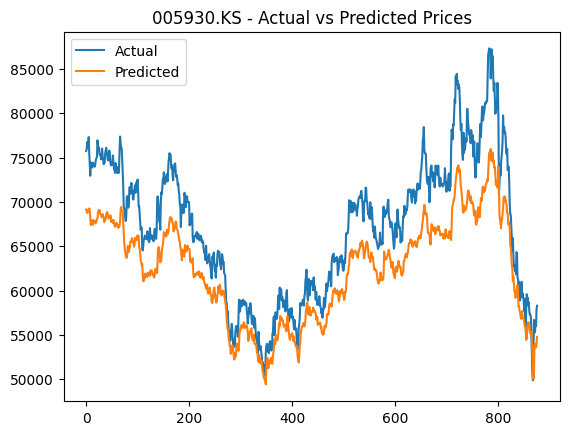

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for 2222.SR: 774.0569184481009
Root Mean Squared Error (RMSE) for 2222.SR: 27.82187841336564
R² Score for 2222.SR: -3151.3367700219433


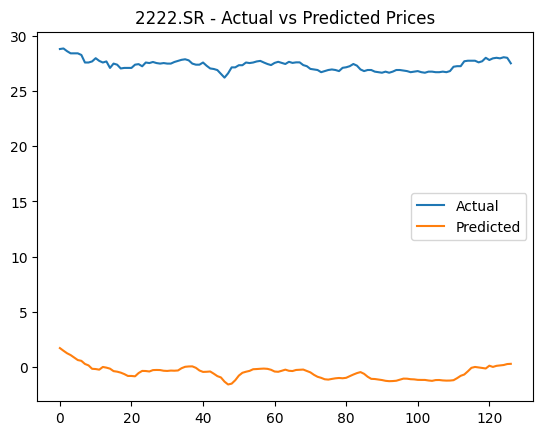

25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for 600519.SS: 19006.573210230246
Root Mean Squared Error (RMSE) for 600519.SS: 137.8643289985856
R² Score for 600519.SS: -0.1570703817192951


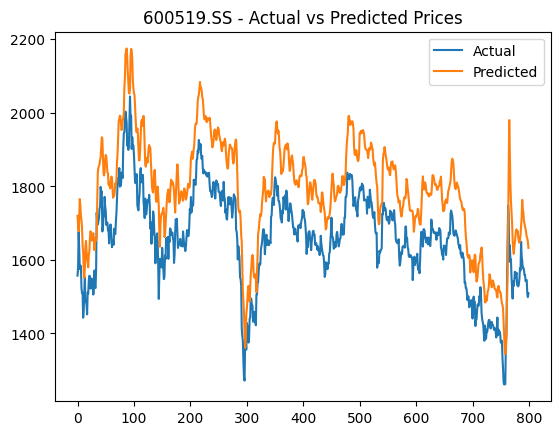

51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for AAPL: 312.05357596239185
Root Mean Squared Error (RMSE) for AAPL: 17.665038238350686
R² Score for AAPL: 0.894777302902373


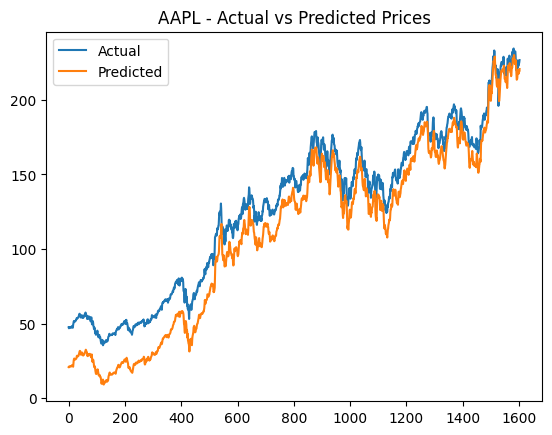

13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
Mean Squared Error for ABBV: 194.10808689696296
Root Mean Squared Error (RMSE) for ABBV: 13.932267830362829
R² Score for ABBV: 0.4680670197367246


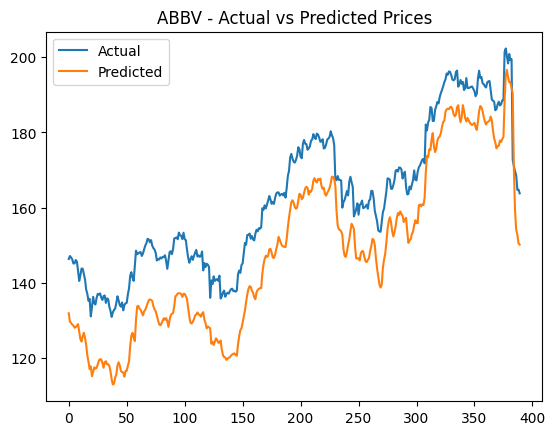

51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for ABT: 440.254146252865
Root Mean Squared Error (RMSE) for ABT: 20.98223406248403
R² Score for ABT: -0.3736966222934186


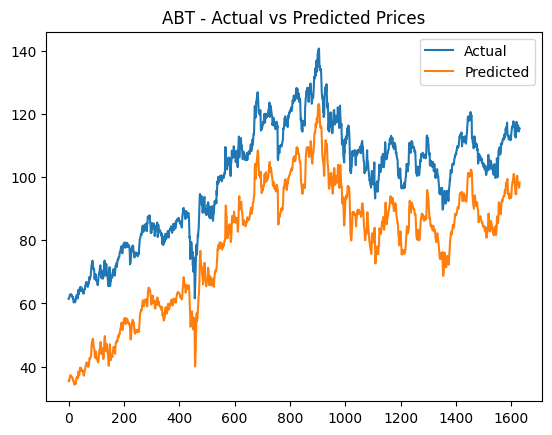

44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for ADBE: 785.8984860856923
Root Mean Squared Error (RMSE) for ADBE: 28.033881038587793
R² Score for ADBE: 0.9310968160226938


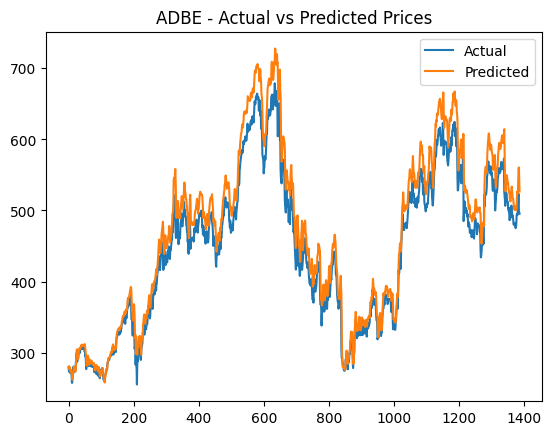

12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for ALLE: 342.2919386360941
Root Mean Squared Error (RMSE) for ALLE: 18.501133441929824
R² Score for ALLE: -0.7797975191135154


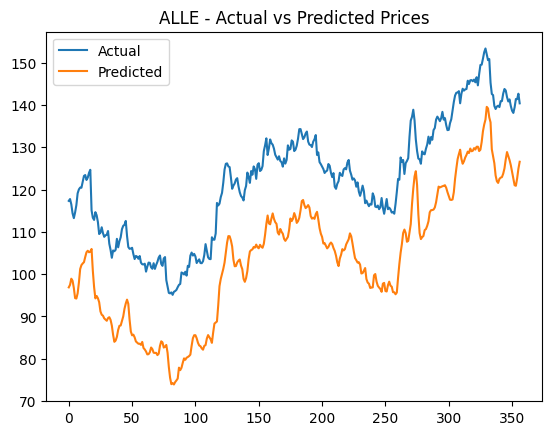

31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for AMZN: 189.41291487747432
Root Mean Squared Error (RMSE) for AMZN: 13.762736460365515
R² Score for AMZN: 0.7955280724364661


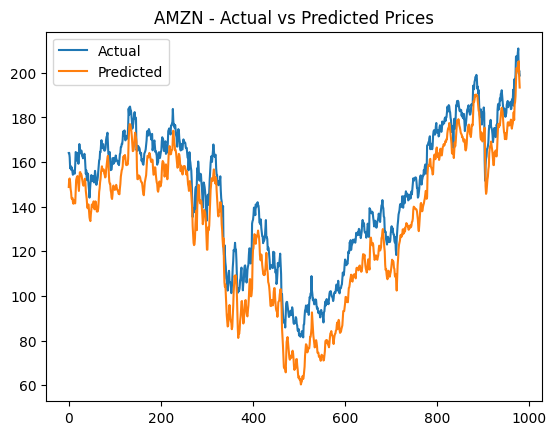

34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for ASML: 2681.837068759412
Root Mean Squared Error (RMSE) for ASML: 51.786456422113034
R² Score for ASML: 0.8946926340819441


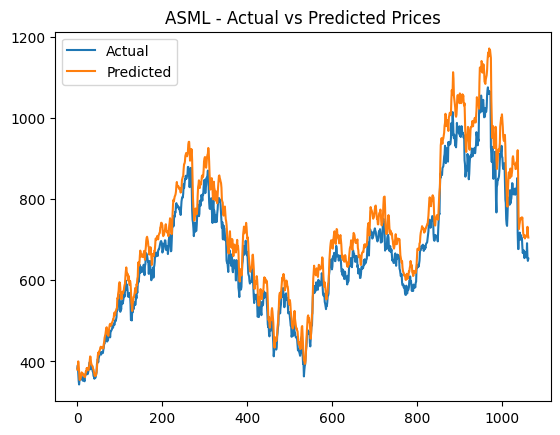

17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for AVGO: 371.0822238899008
Root Mean Squared Error (RMSE) for AVGO: 19.263494591841347
R² Score for AVGO: 0.7670651042551965


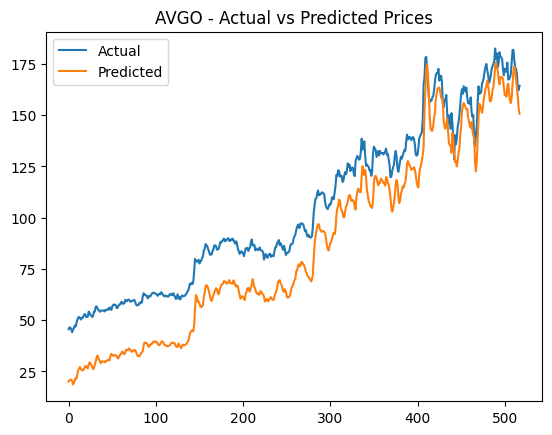

52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for AVY: 257.11343763939396
Root Mean Squared Error (RMSE) for AVY: 16.0347571743196
R² Score for AVY: 0.8699541851801016


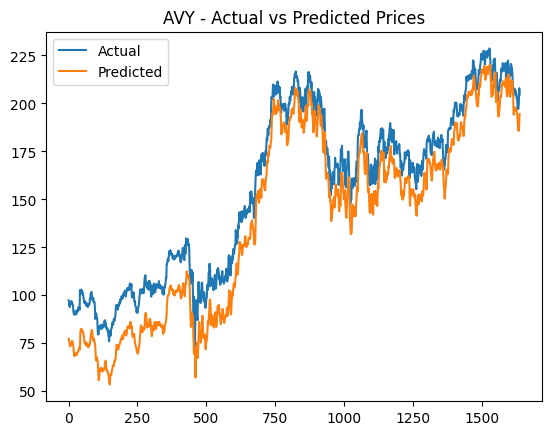

61/61 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for BMY: 690.3647229591497
Root Mean Squared Error (RMSE) for BMY: 26.274792538841286
R² Score for BMY: -8.212344874802545


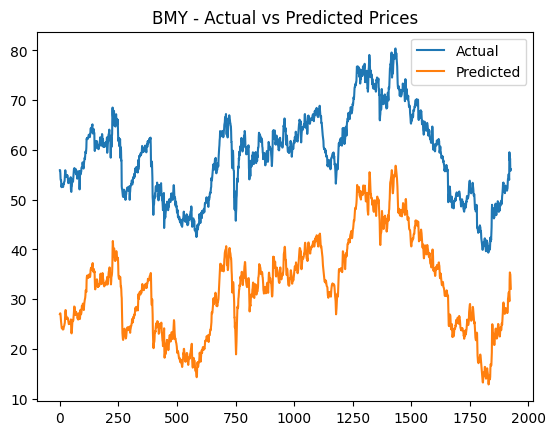

32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for BRK-B: 86.50868787149709
Root Mean Squared Error (RMSE) for BRK-B: 9.301004670007272
R² Score for BRK-B: 0.9769214947442983


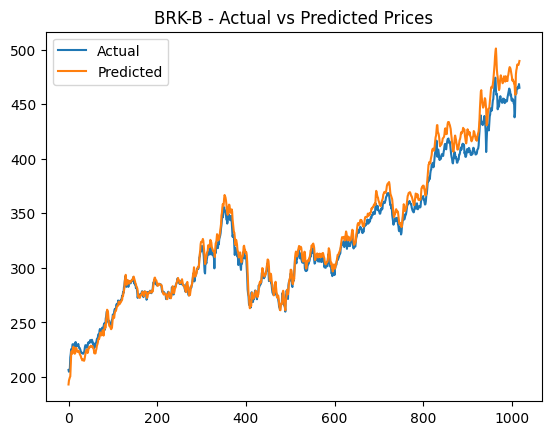

36/36 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for BWA: 731.2988707180504
Root Mean Squared Error (RMSE) for BWA: 27.042538170779206
R² Score for BWA: -41.79759617830023


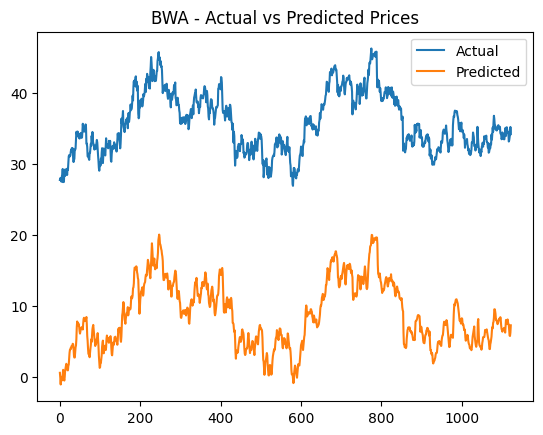

51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for CACI: 112.53062861100162
Root Mean Squared Error (RMSE) for CACI: 10.608045466107393
R² Score for CACI: 0.9825941247162494


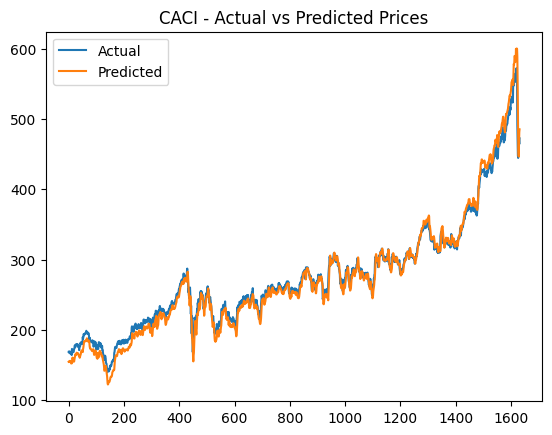

40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for CGNX: 627.8682430960441
Root Mean Squared Error (RMSE) for CGNX: 25.057299197959146
R² Score for CGNX: -1.6128281849070745


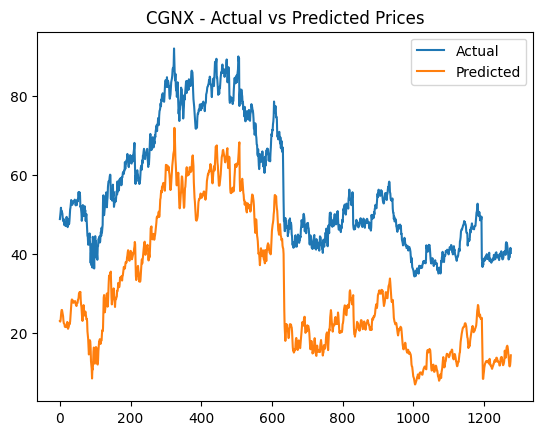

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
Mean Squared Error for CHK: 524.891164138894
Root Mean Squared Error (RMSE) for CHK: 22.91050335847936
R² Score for CHK: -5.398184915467244


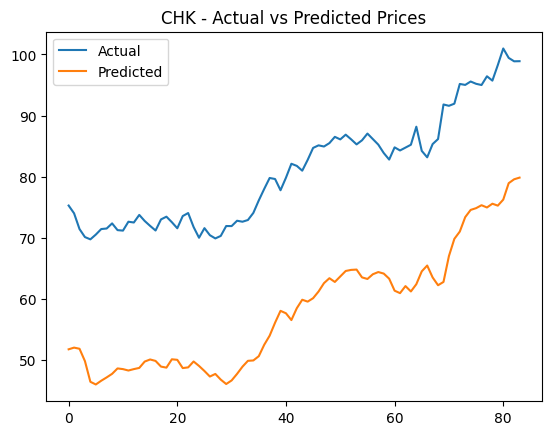

31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for CIEN: 646.4532153269842
Root Mean Squared Error (RMSE) for CIEN: 25.425444250336792
R² Score for CIEN: -9.748054072009765


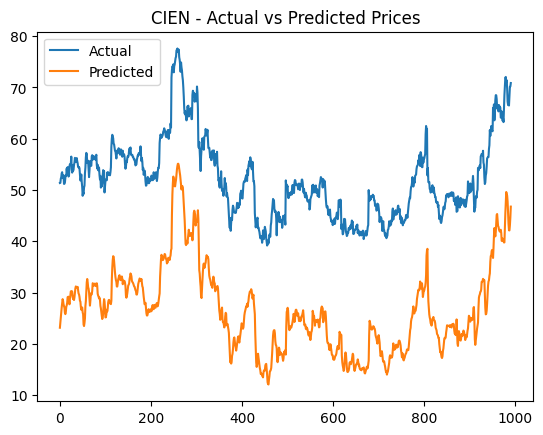

42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for CLH: 381.5244590077128
Root Mean Squared Error (RMSE) for CLH: 19.532651100342544
R² Score for CLH: 0.8697259416079626


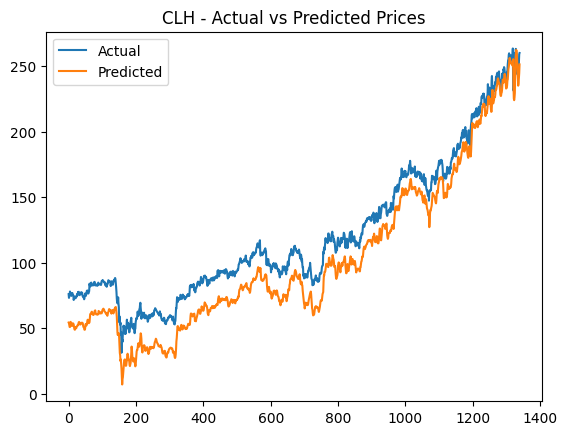

51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for CMCSA: 715.715790705585
Root Mean Squared Error (RMSE) for CMCSA: 26.752865093398597
R² Score for CMCSA: -15.407223005353


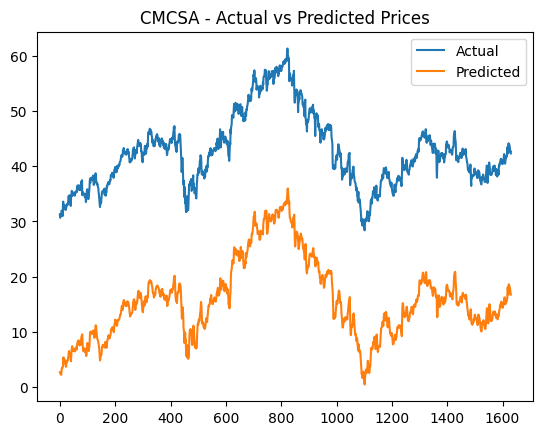

23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for CRM: 78.60078299921825
Root Mean Squared Error (RMSE) for CRM: 8.865708262694993
R² Score for CRM: 0.9670096905116108


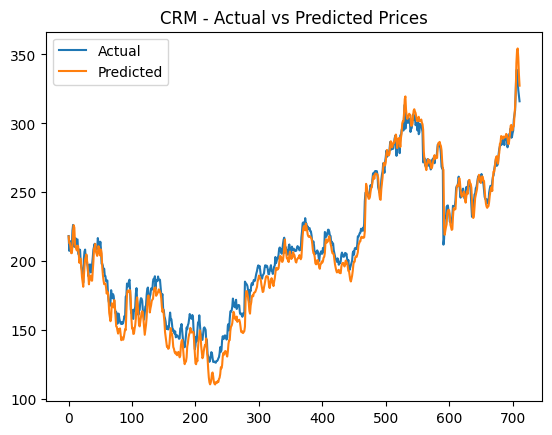

40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for CSCO: 686.0305977717064
Root Mean Squared Error (RMSE) for CSCO: 26.192185815080542
R² Score for CSCO: -23.143168240386316


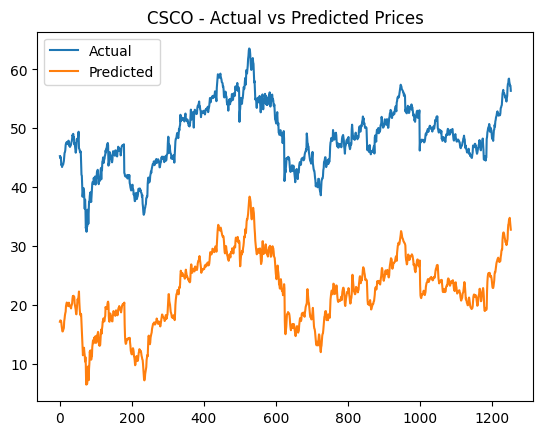

52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for CSL: 214.46232790913757
Root Mean Squared Error (RMSE) for CSL: 14.644532355426634
R² Score for CSL: 0.9767266615542913


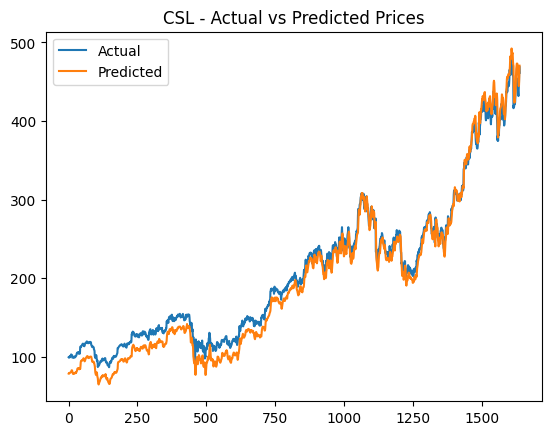

73/73 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for CVX: 558.9564310673574
Root Mean Squared Error (RMSE) for CVX: 23.642259432367233
R² Score for CVX: 0.2443212609693849


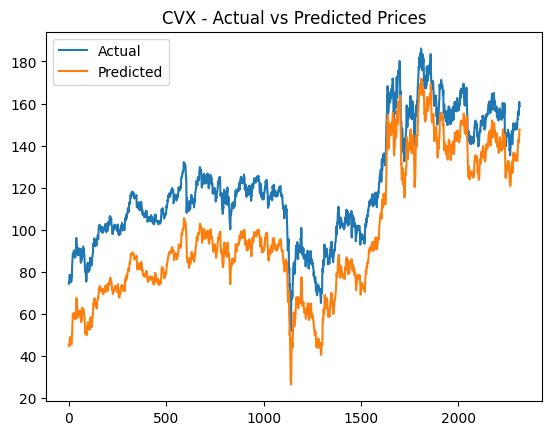

73/73 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for DIS: 337.2920298936688
Root Mean Squared Error (RMSE) for DIS: 18.36551196927733
R² Score for DIS: 0.5115913262454341


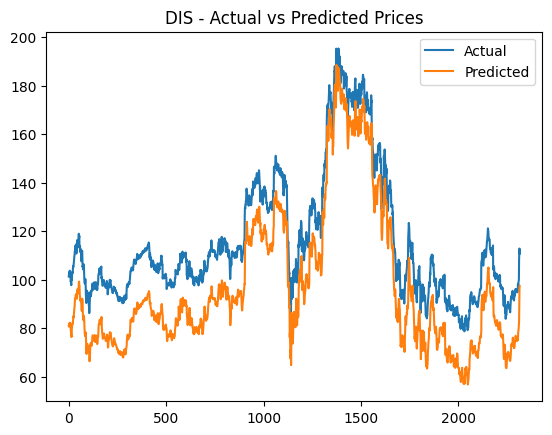

44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for EHC: 607.6614297909794
Root Mean Squared Error (RMSE) for EHC: 24.650789638285005
R² Score for EHC: -2.370031593178208


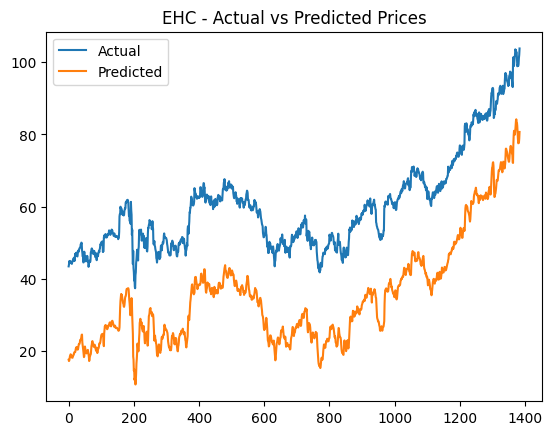

10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for ETSY: 587.7430638899014
Root Mean Squared Error (RMSE) for ETSY: 24.24341279378589
R² Score for ETSY: -6.3139387961889115


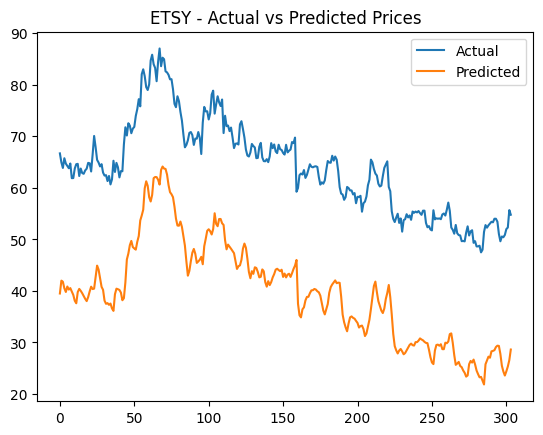

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
Mean Squared Error for FSLR: 260.8067187254732
Root Mean Squared Error (RMSE) for FSLR: 16.149511408258554
R² Score for FSLR: 0.8631913971130349


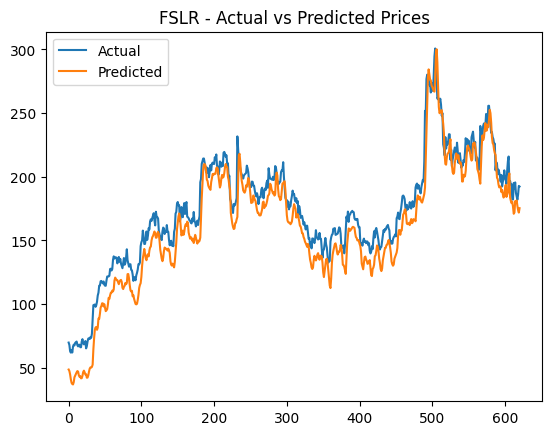

51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for GGG: 594.1615379737527
Root Mean Squared Error (RMSE) for GGG: 24.375428980302125
R² Score for GGG: -1.5362775002301214


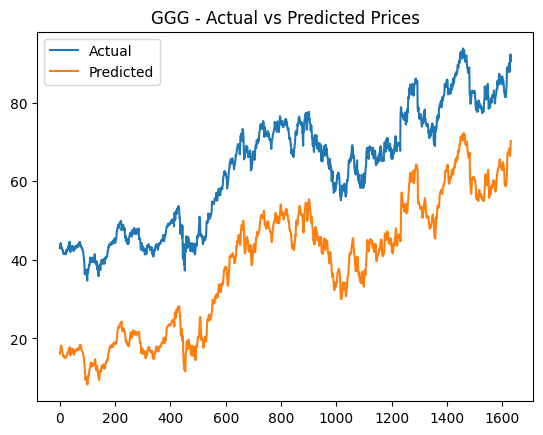

16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Mean Squared Error for GNRC: 355.4242606788445
Root Mean Squared Error (RMSE) for GNRC: 18.852699029020872
R² Score for GNRC: 0.28767413270832976


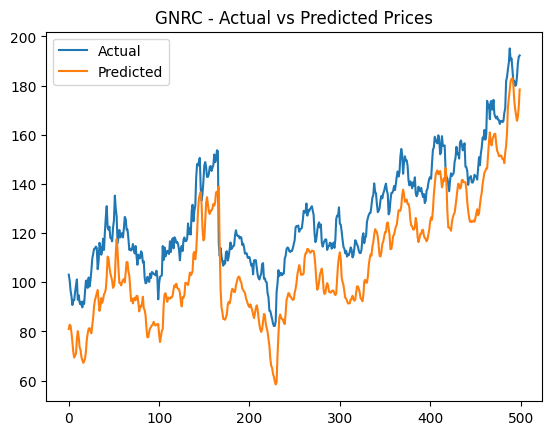

23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for GOOGL: 251.2917494031377
Root Mean Squared Error (RMSE) for GOOGL: 15.85218437323821
R² Score for GOOGL: 0.6326428584307726


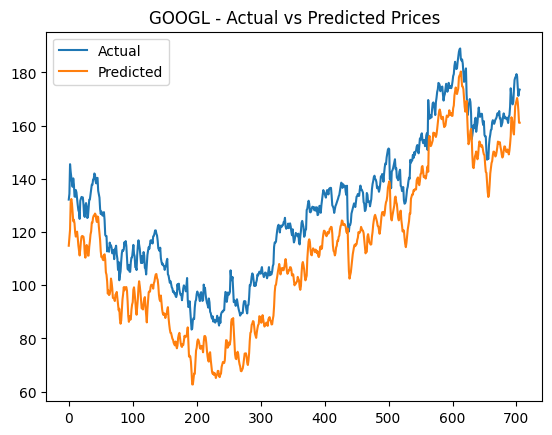

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
Mean Squared Error for HBI: 902.1184912334804
Root Mean Squared Error (RMSE) for HBI: 30.035287433841557
R² Score for HBI: -244.78623410789706


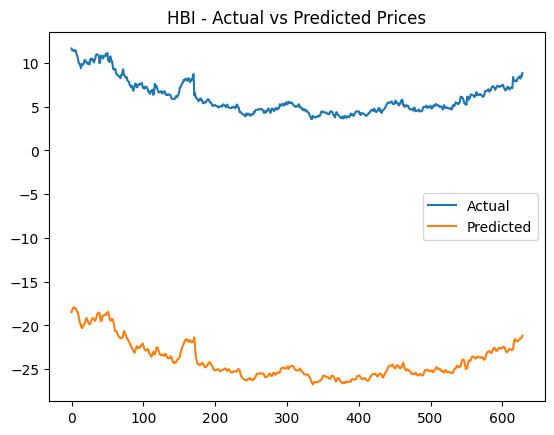

50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for HD: 110.68530493166217
Root Mean Squared Error (RMSE) for HD: 10.52070838544925
R² Score for HD: 0.9708117446370634


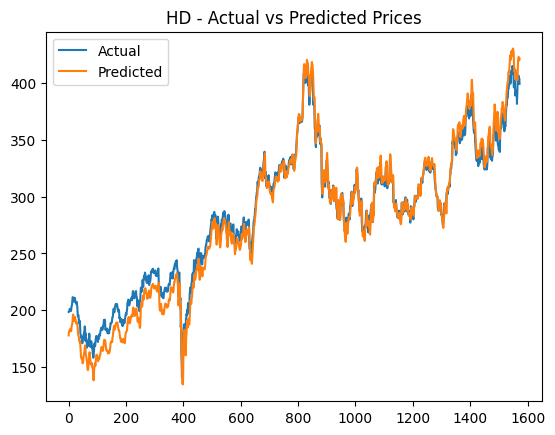

40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for HOLX: 554.7719730400402
Root Mean Squared Error (RMSE) for HOLX: 23.553597878881266
R² Score for HOLX: -4.72873457790953


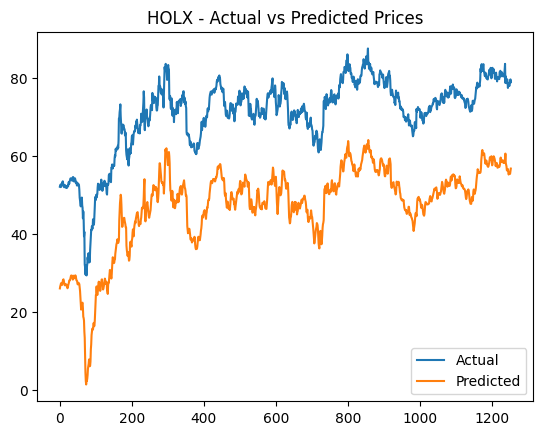

51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for HP: 748.5177113028261
Root Mean Squared Error (RMSE) for HP: 27.35905172521201
R² Score for HP: -7.269532828274857


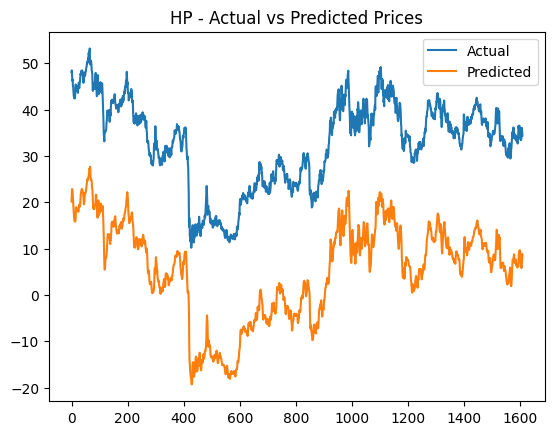

52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for HUBB: 229.84979241009725
Root Mean Squared Error (RMSE) for HUBB: 15.160797881711149
R² Score for HUBB: 0.9758232097175926


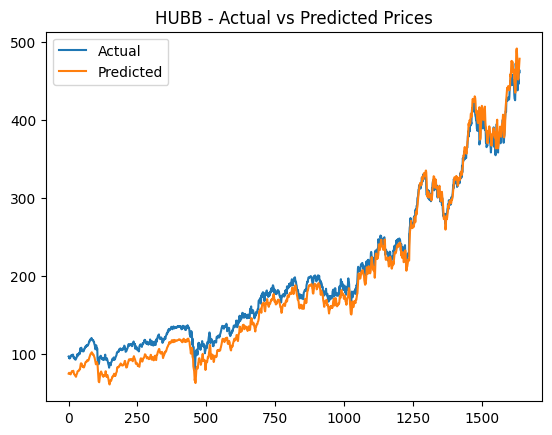

36/36 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for IAC: 517.9974359178942
Root Mean Squared Error (RMSE) for IAC: 22.75955702376244
R² Score for IAC: 0.6523575356407745


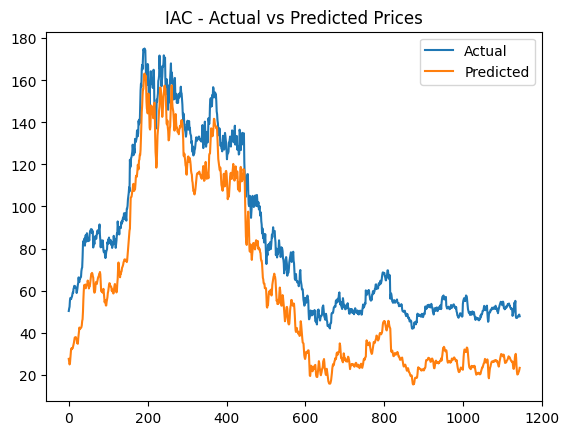

27/27 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Mean Squared Error for ILMN: 260.86083045467444
Root Mean Squared Error (RMSE) for ILMN: 16.151186657786926
R² Score for ILMN: 0.9768469421836824


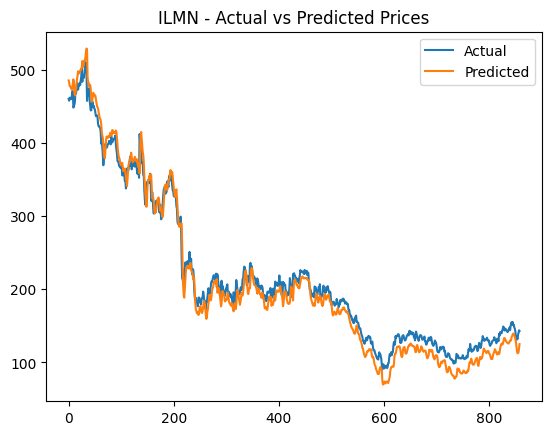

51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for INTC: 701.5712153251935
Root Mean Squared Error (RMSE) for INTC: 26.487189645660663
R² Score for INTC: -4.472405979493939


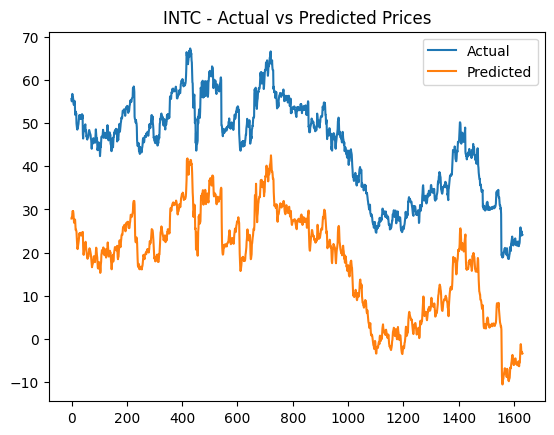

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Mean Squared Error for IR: 464.96304757439367
Root Mean Squared Error (RMSE) for IR: 21.5630018219726
R² Score for IR: -10.8557735996227


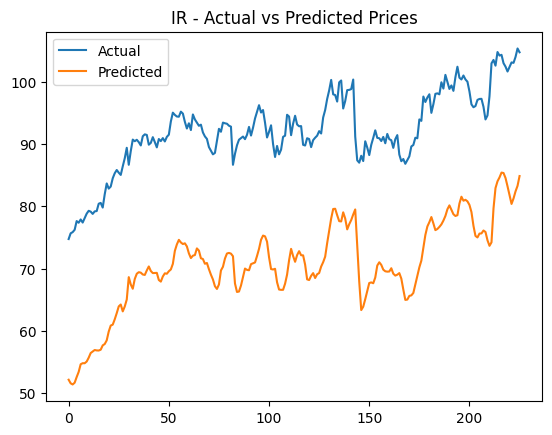

19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
Mean Squared Error for JAZZ: 313.79422094336695
Root Mean Squared Error (RMSE) for JAZZ: 17.714237803060197
R² Score for JAZZ: -0.19122805347481808


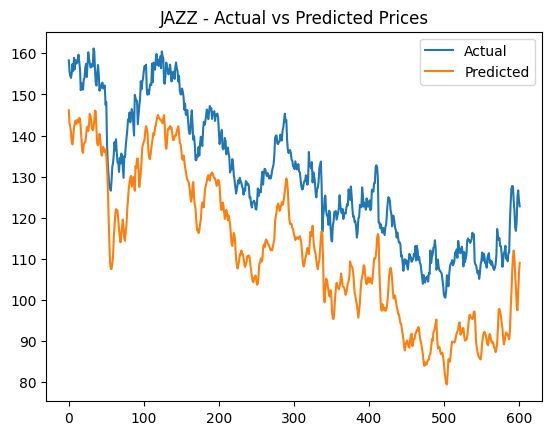

47/47 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for JBHT: 263.96978222099494
Root Mean Squared Error (RMSE) for JBHT: 16.247146894793403
R² Score for JBHT: 0.7934107431020753


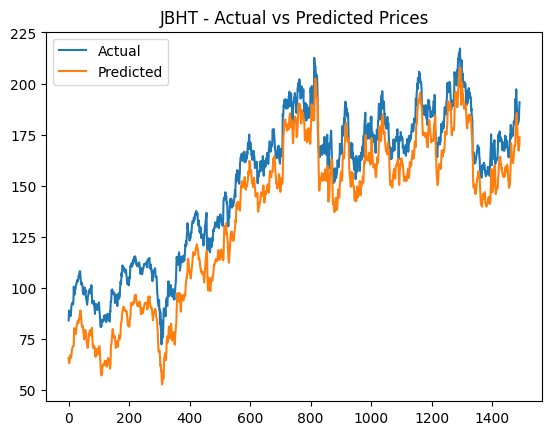

73/73 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for JNJ: 402.20456001919365
Root Mean Squared Error (RMSE) for JNJ: 20.055038270200175
R² Score for JNJ: 0.06802443307343242


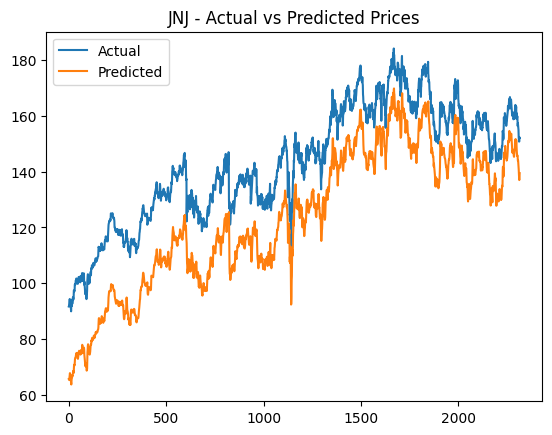

51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for JPM: 362.2726056200458
Root Mean Squared Error (RMSE) for JPM: 19.033460158889813
R² Score for JPM: 0.6617398958135117


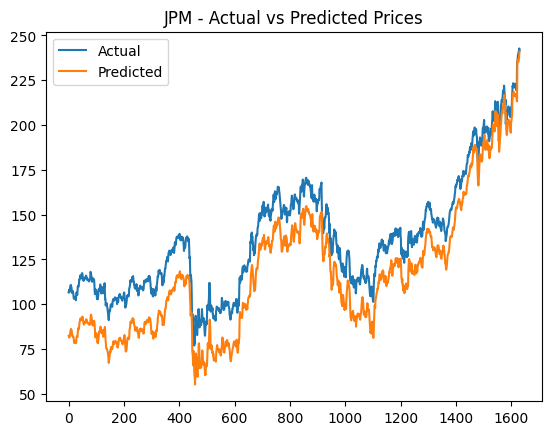

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
Mean Squared Error for KBR: 620.2584109003141
Root Mean Squared Error (RMSE) for KBR: 24.904987671153624
R² Score for KBR: -11.837877562122252


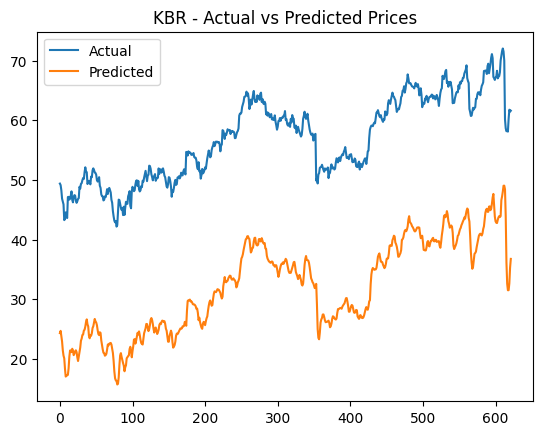

11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Mean Squared Error for KEYS: 272.85173365772516
Root Mean Squared Error (RMSE) for KEYS: 16.518224288879395
R² Score for KEYS: -0.9065368419282256


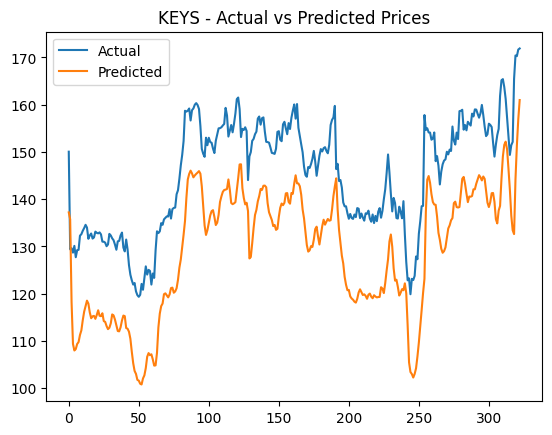

73/73 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for KO: 723.9820642387488
Root Mean Squared Error (RMSE) for KO: 26.90691480342458
R² Score for KO: -10.686949378630747


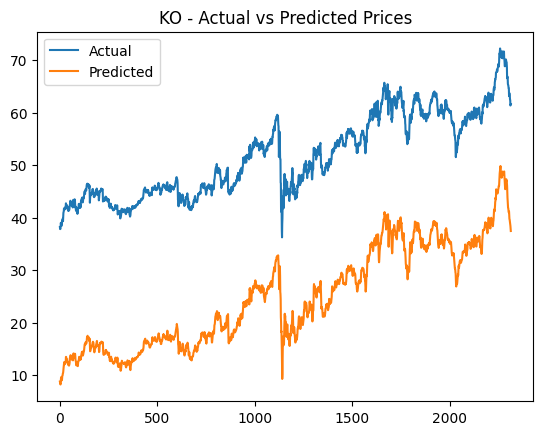

29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for LII: 213.05810979424496
Root Mean Squared Error (RMSE) for LII: 14.596510192311207
R² Score for LII: 0.9850984108572551


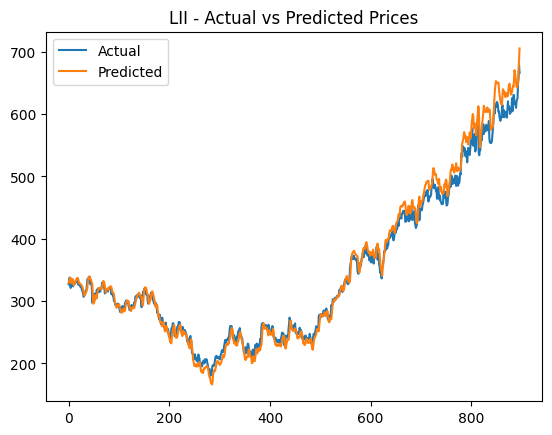

10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
Mean Squared Error for LITE: 658.0282565374464
Root Mean Squared Error (RMSE) for LITE: 25.652061448106785
R² Score for LITE: -4.9655818393491


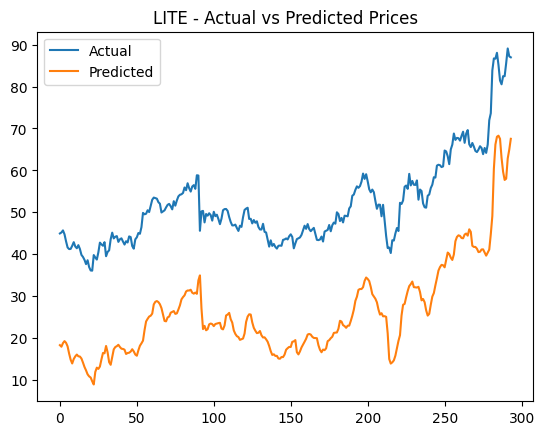

61/61 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for LLY: 839.6961621911415
Root Mean Squared Error (RMSE) for LLY: 28.97751131810911
R² Score for LLY: 0.9843180627741579


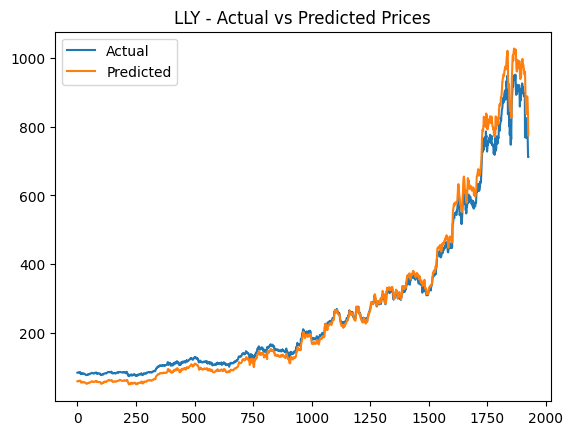

21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for LVMUY: 210.223039609596
Root Mean Squared Error (RMSE) for LVMUY: 14.499070301560579
R² Score for LVMUY: 0.5568209297930343


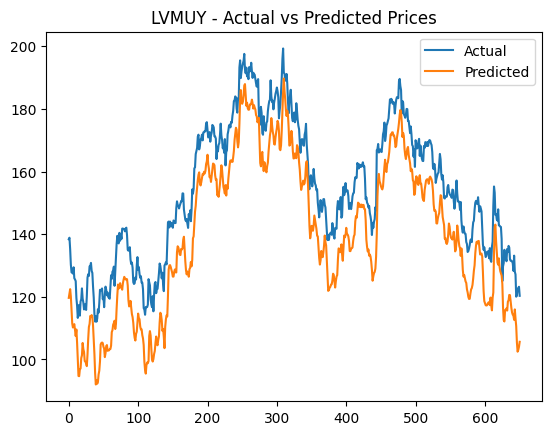

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
Mean Squared Error for MA: 242.30700564304888
Root Mean Squared Error (RMSE) for MA: 15.566213593647264
R² Score for MA: 0.9288490115471858


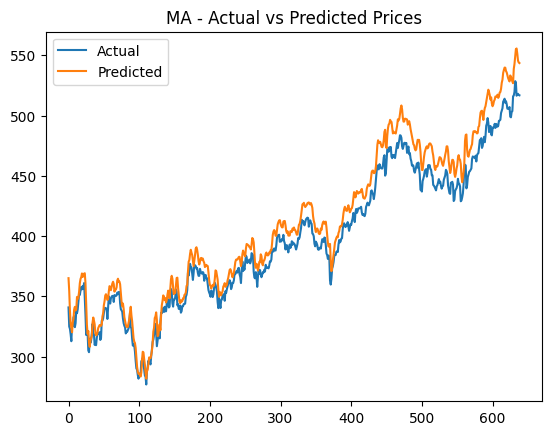

19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Mean Squared Error for MASI: 318.5511363019701
Root Mean Squared Error (RMSE) for MASI: 17.848000904918457
R² Score for MASI: 0.5442468439503607


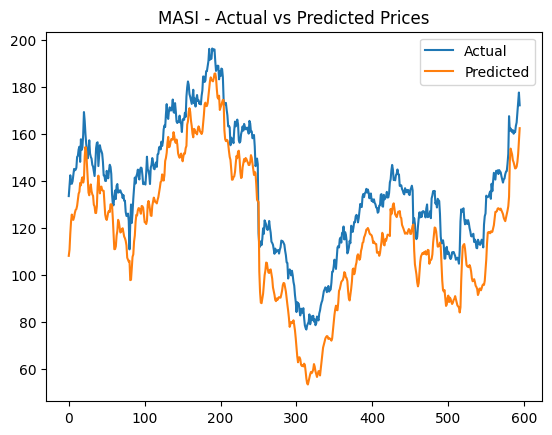

13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Mean Squared Error for META: 535.8820994450822
Root Mean Squared Error (RMSE) for META: 23.149127401374813
R² Score for META: 0.9579586440747467


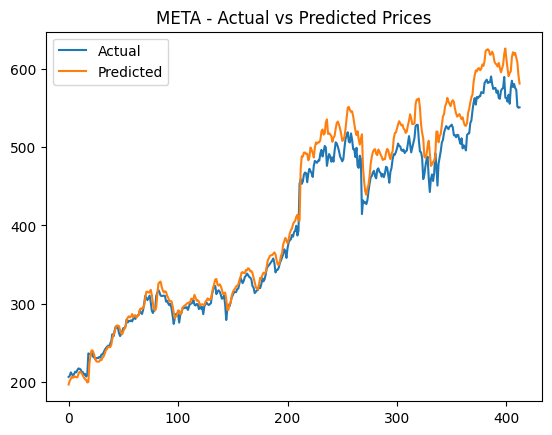

73/73 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for MRK: 606.2072747639471
Root Mean Squared Error (RMSE) for MRK: 24.621276871111846
R² Score for MRK: -0.30186241253332313


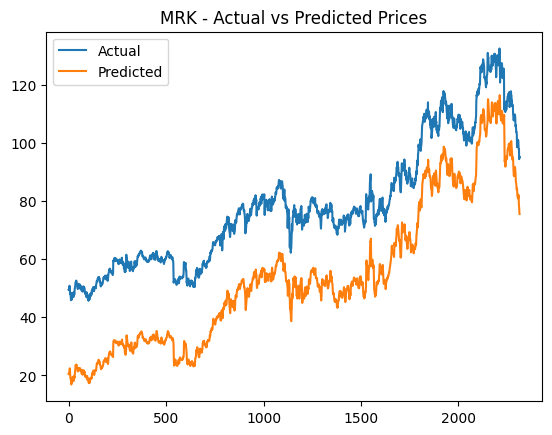

44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for MSFT: 127.97886445496718
Root Mean Squared Error (RMSE) for MSFT: 11.312774392471866
R² Score for MSFT: 0.9835383295580807


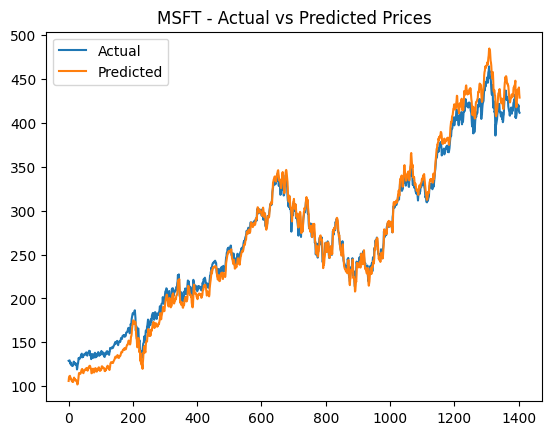

51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for NKE: 383.34915237201915
Root Mean Squared Error (RMSE) for NKE: 19.579304185083267
R² Score for NKE: 0.41717692128981754


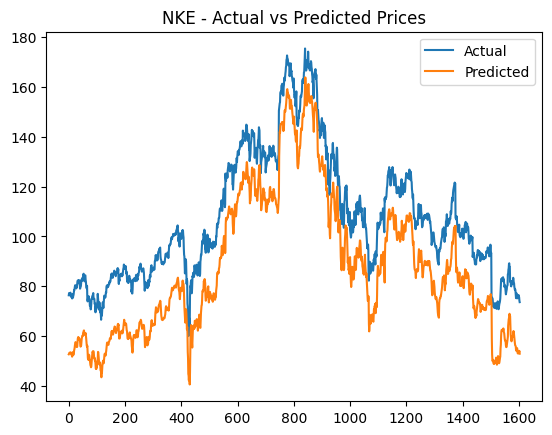

35/35 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for NKTR: 891.8561440608872
Root Mean Squared Error (RMSE) for NKTR: 29.86396062247751
R² Score for NKTR: -14.154354545812762


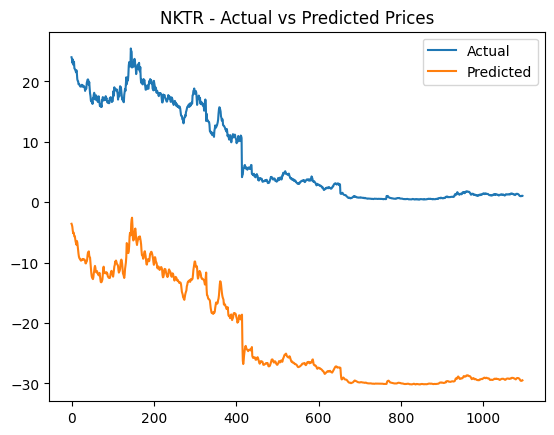

32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for NSRGY: 403.02291524746
Root Mean Squared Error (RMSE) for NSRGY: 20.075430636662816
R² Score for NSRGY: -3.219933419802916


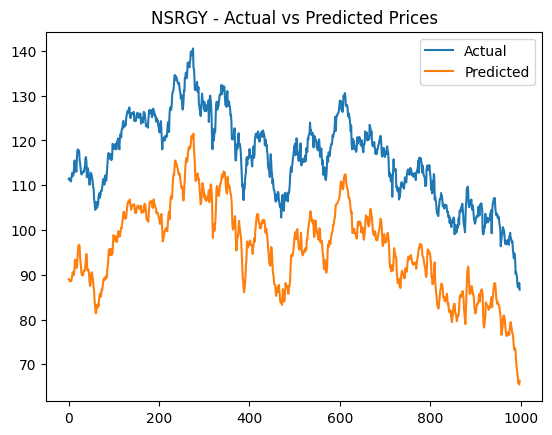

29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
Mean Squared Error for NVDA: 646.9485945172855
Root Mean Squared Error (RMSE) for NVDA: 25.435184184850826
R² Score for NVDA: 0.5155678953616076


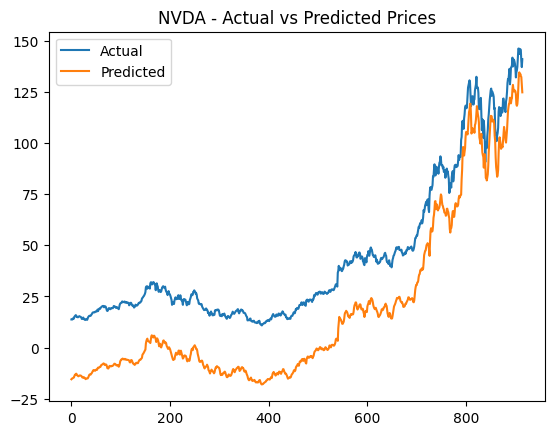

50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for NVO: 626.3245658201602
Root Mean Squared Error (RMSE) for NVO: 25.026477295459706
R² Score for NVO: 0.4671115044476468


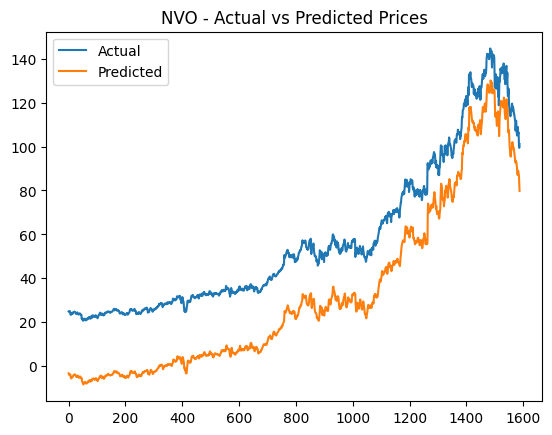

32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for NVS: 506.01024349758603
Root Mean Squared Error (RMSE) for NVS: 22.49467144675792
R² Score for NVS: -4.362657546050778


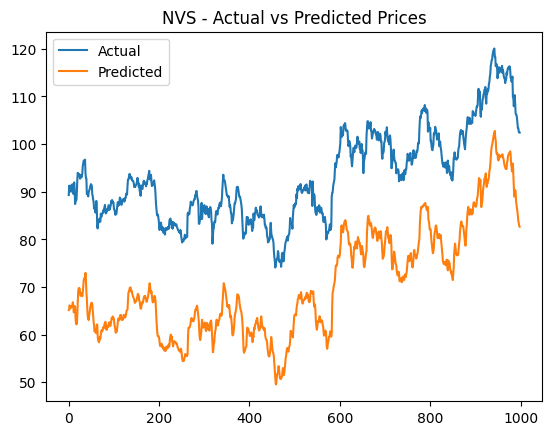

6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Mean Squared Error for NVT: 546.4641792253929
Root Mean Squared Error (RMSE) for NVT: 23.376573299467843
R² Score for NVT: -17.529332928308648


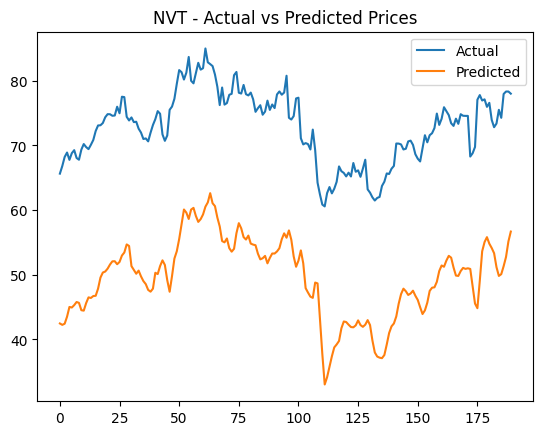

52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for OLN: 733.7802798406326
Root Mean Squared Error (RMSE) for OLN: 27.08837905524494
R² Score for OLN: -1.6521744845954895


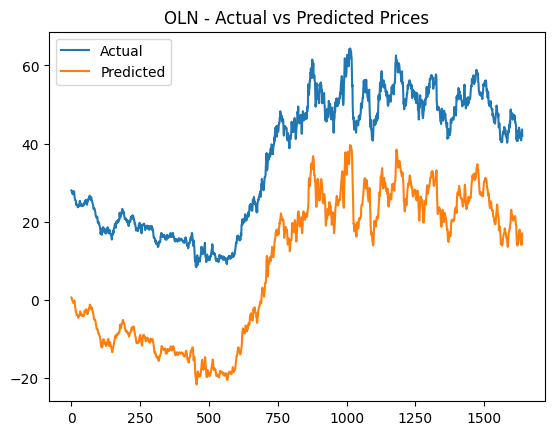

44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for ORCL: 488.5156734315254
Root Mean Squared Error (RMSE) for ORCL: 22.102390672312474
R² Score for ORCL: 0.4536100879475826


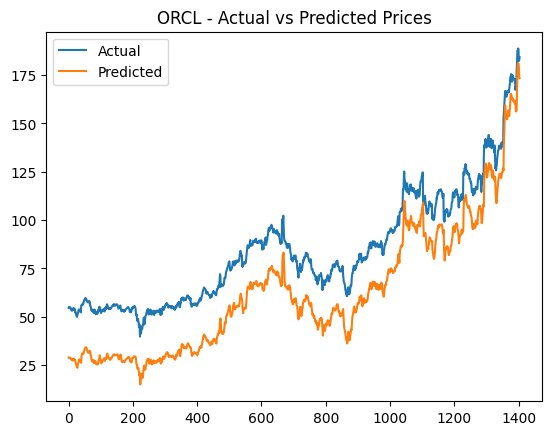

61/61 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for PEP: 370.0421766063101
Root Mean Squared Error (RMSE) for PEP: 19.23648035910702
R² Score for PEP: 0.4285009442014782


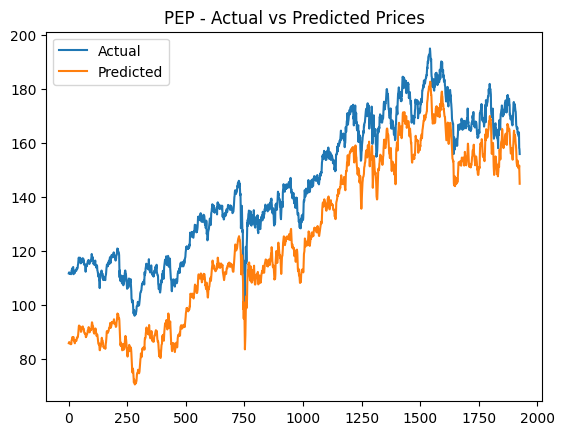

61/61 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for PFE: 794.0290966196861
Root Mean Squared Error (RMSE) for PFE: 28.178521902677687
R² Score for PFE: -15.517208281413485


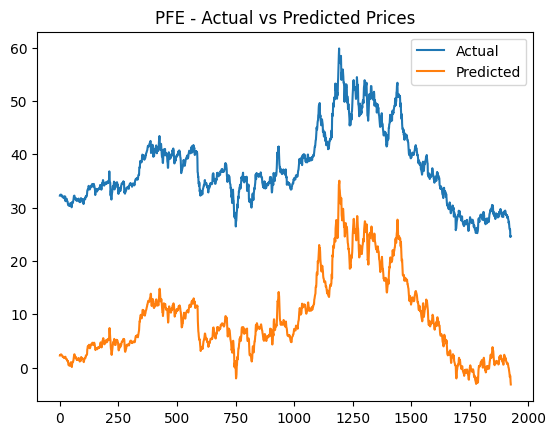

73/73 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for PG: 465.9847484889545
Root Mean Squared Error (RMSE) for PG: 21.586679885729406
R² Score for PG: 0.4926187407674151


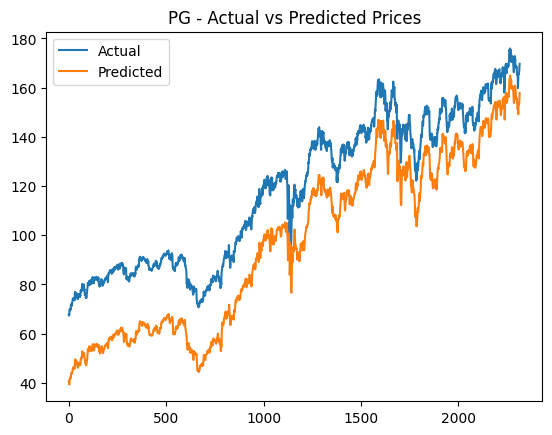

52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for PNW: 561.2983190255806
Root Mean Squared Error (RMSE) for PNW: 23.69173524724562
R² Score for PNW: -9.984267783061135


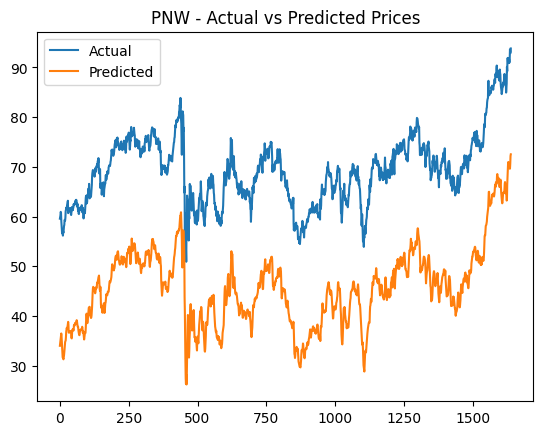

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
Mean Squared Error for PSTG: 667.3409619152065
Root Mean Squared Error (RMSE) for PSTG: 25.832943345952792
R² Score for PSTG: -5.640902170391242


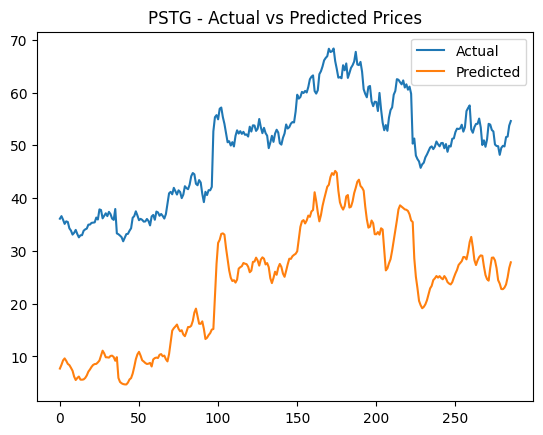

30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for PWR: 256.750808014324
Root Mean Squared Error (RMSE) for PWR: 16.023445572482967
R² Score for PWR: 0.9383772109747929


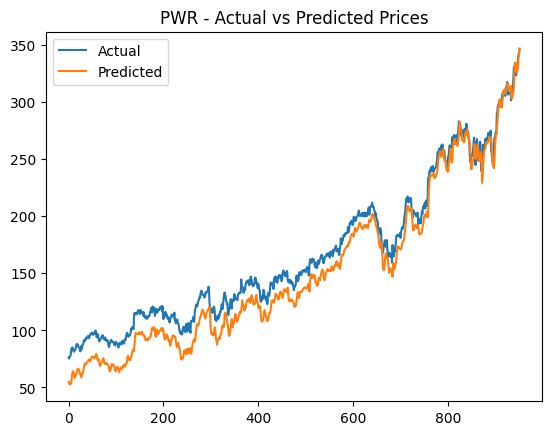

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
Mean Squared Error for RHHBY: 727.665386667441
Root Mean Squared Error (RMSE) for RHHBY: 26.975273616173777
R² Score for RHHBY: -26.965590553882933


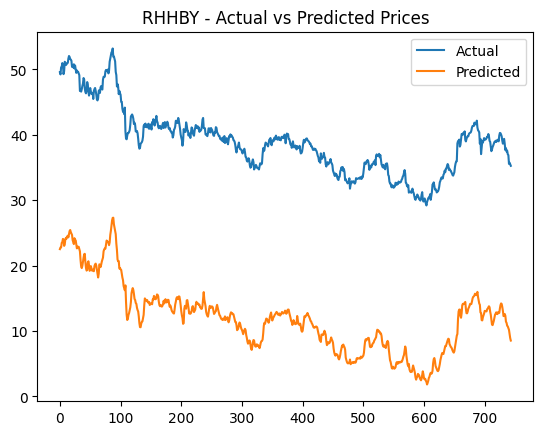

31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Mean Squared Error for RL: 355.3145389529172
Root Mean Squared Error (RMSE) for RL: 18.849788830459538
R² Score for RL: 0.6446583534196769


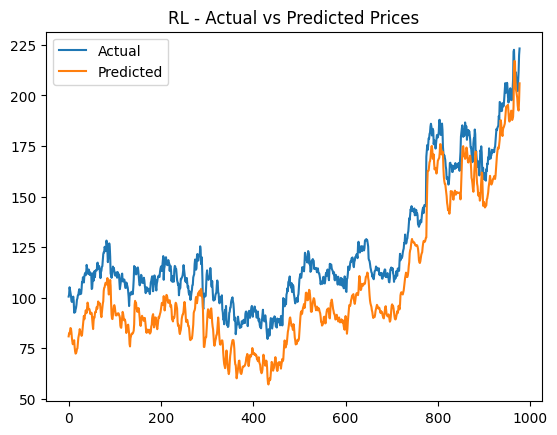

51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for SEE: 698.8970803017651
Root Mean Squared Error (RMSE) for SEE: 26.436661670902495
R² Score for SEE: -6.092598828878525


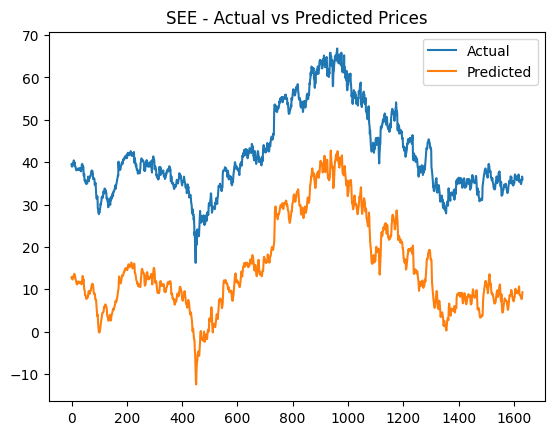

12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Mean Squared Error for SFM: 592.9209140997541
Root Mean Squared Error (RMSE) for SFM: 24.34996743529145
R² Score for SFM: 0.3364690237376724


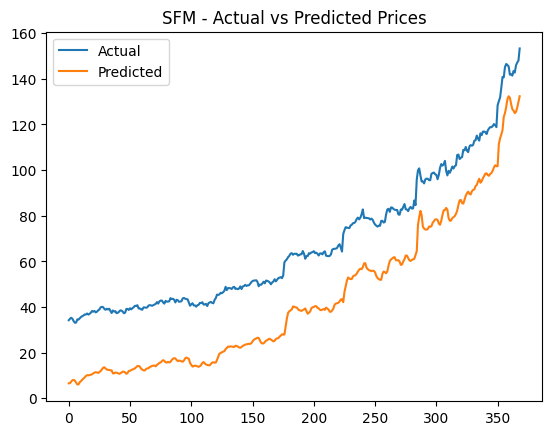

47/47 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for SHEL: 701.703124152289
Root Mean Squared Error (RMSE) for SHEL: 26.4896795781355
R² Score for SHEL: -3.444994774324944


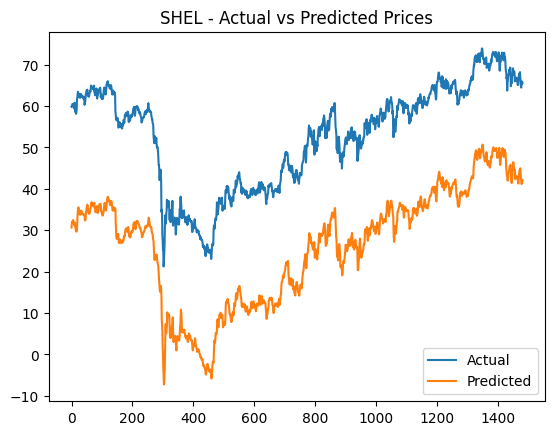

31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for SRPT: 439.4779888853674
Root Mean Squared Error (RMSE) for SRPT: 20.96373031894294
R² Score for SRPT: 0.2439656252925948


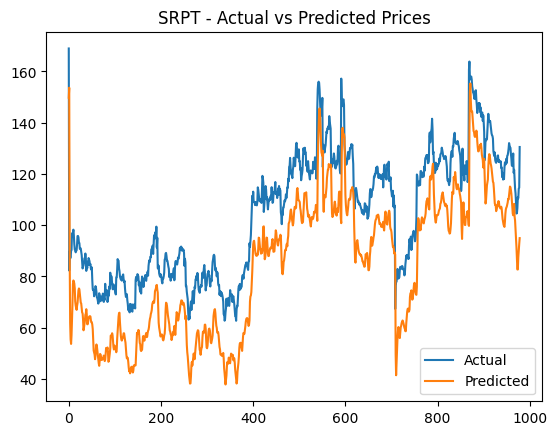

16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
Mean Squared Error for TCEHY: 669.8436930657548
Root Mean Squared Error (RMSE) for TCEHY: 25.88133870312266
R² Score for TCEHY: -22.050656948685646


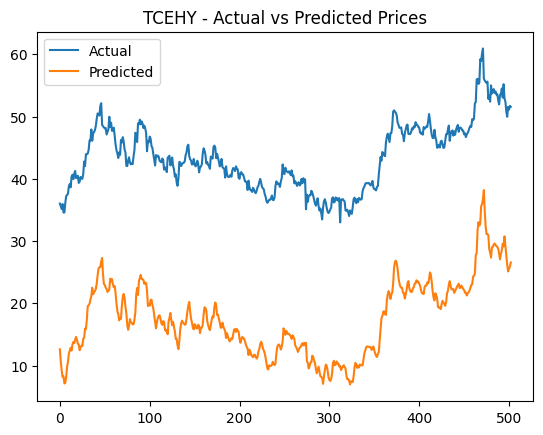

52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for TER: 488.7097293424879
Root Mean Squared Error (RMSE) for TER: 22.1067801667834
R² Score for TER: 0.5671397543954815


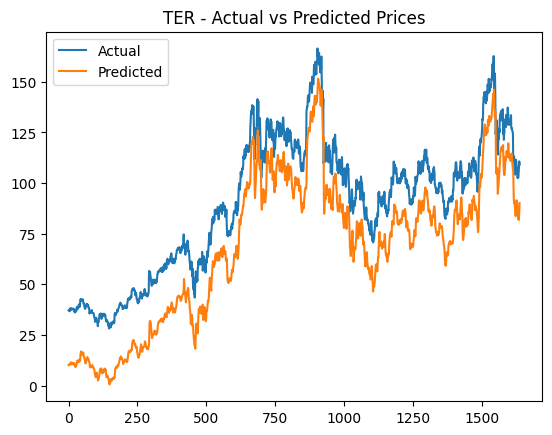

51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for TM: 204.97816712644186
Root Mean Squared Error (RMSE) for TM: 14.317058605958204
R² Score for TM: 0.7698671921720786


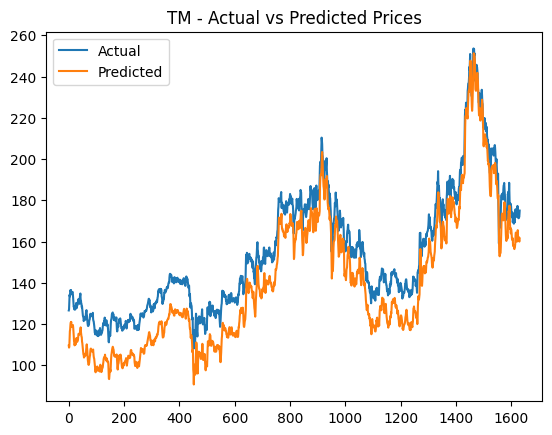

51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for TMO: 721.8860324039299
Root Mean Squared Error (RMSE) for TMO: 26.86793688402461
R² Score for TMO: 0.9574557066512022


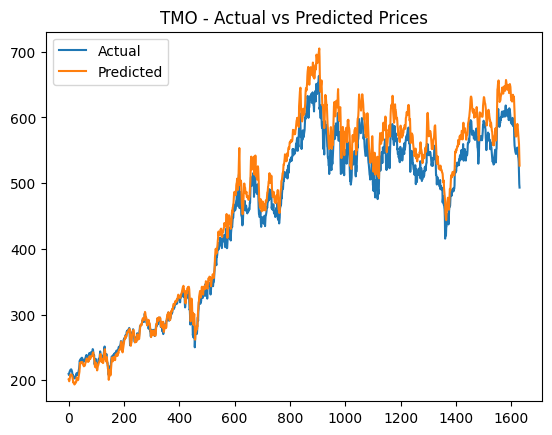

16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Mean Squared Error for TSLA: 95.50352683441879
Root Mean Squared Error (RMSE) for TSLA: 9.772590589726901
R² Score for TSLA: 0.9436808758382043


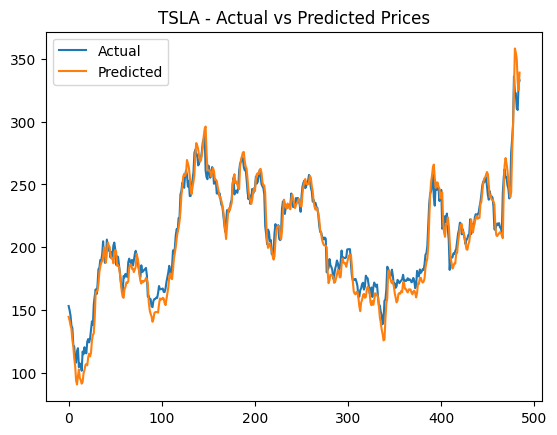

31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Mean Squared Error for TSM: 356.66835388614004
Root Mean Squared Error (RMSE) for TSM: 18.885665301655116
R² Score for TSM: 0.6031702235717948


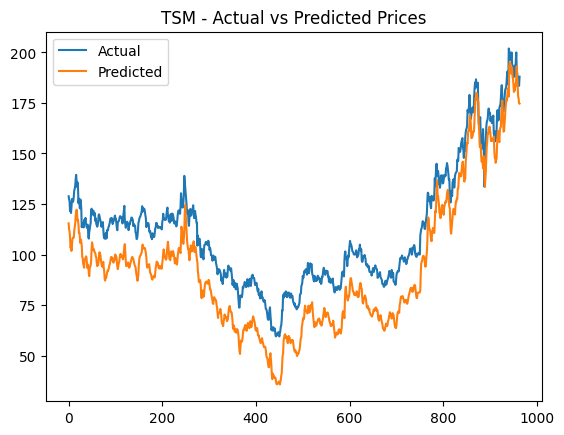

51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for TT: 295.2812738359678
Root Mean Squared Error (RMSE) for TT: 17.18375028438111
R² Score for TT: 0.956344868164204


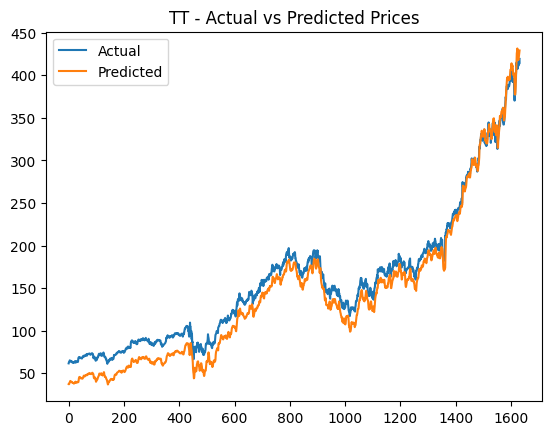

14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
Mean Squared Error for UI: 264.21336446267486
Root Mean Squared Error (RMSE) for UI: 16.25464132064054
R² Score for UI: 0.9136654767222405


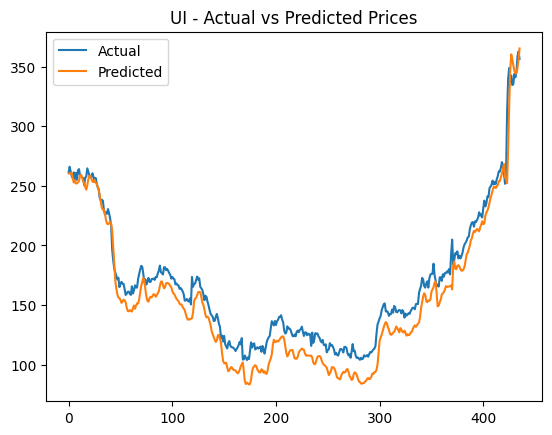

46/46 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for UNH: 387.56395411177175
Root Mean Squared Error (RMSE) for UNH: 19.6866440540731
R² Score for UNH: 0.9685203984702614


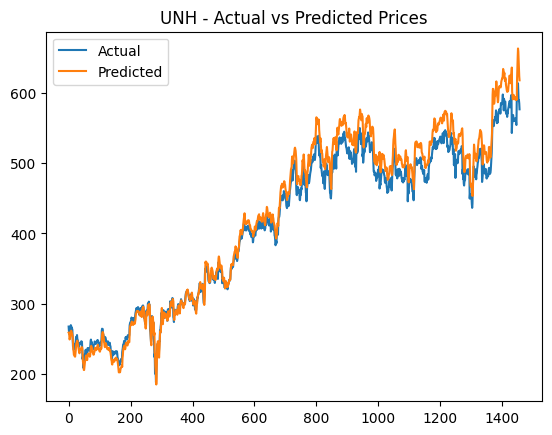

18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Mean Squared Error for V: 32.68278210898275
Root Mean Squared Error (RMSE) for V: 5.716885700185263
R² Score for V: 0.9633848489150987


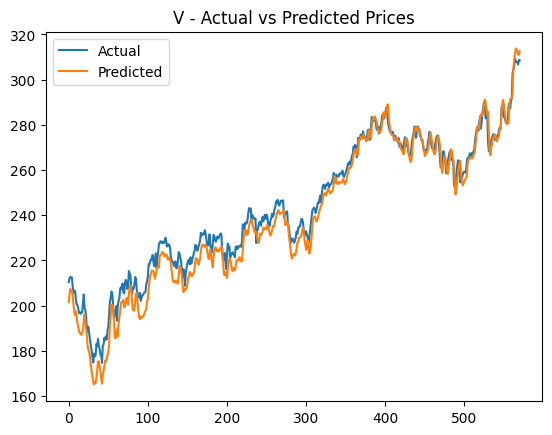

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Mean Squared Error for VVV: 703.3911719560697
Root Mean Squared Error (RMSE) for VVV: 26.521522806129923
R² Score for VVV: -87.12087887295885


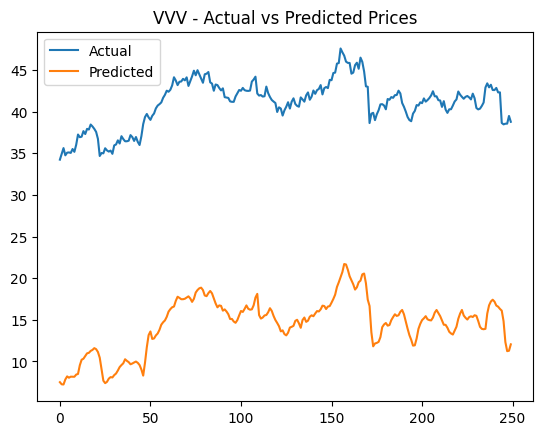

47/47 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for VZ: 772.1038982533827
Root Mean Squared Error (RMSE) for VZ: 27.786757605978117
R² Score for VZ: -8.519775592230983


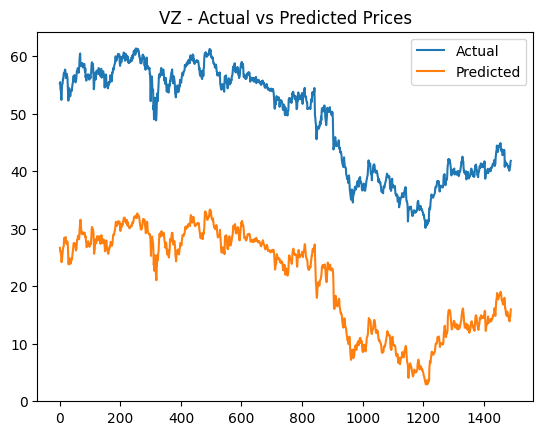

60/60 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for WMT: 698.900201766836
Root Mean Squared Error (RMSE) for WMT: 26.436720707509014
R² Score for WMT: -3.7872937838697105


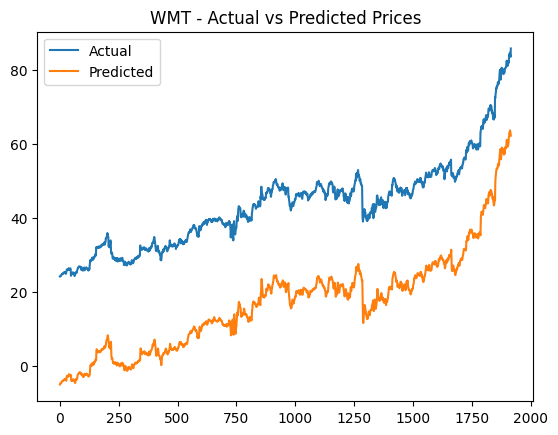

30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Mean Squared Error for WPC: 592.8066236946812
Root Mean Squared Error (RMSE) for WPC: 24.347620493483163
R² Score for WPC: -14.260219485485377


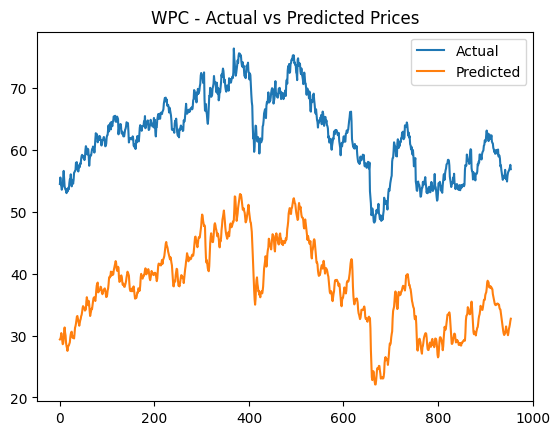

48/48 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for WSM: 597.7160425926181
Root Mean Squared Error (RMSE) for WSM: 24.448231890928596
R² Score for WSM: 0.5451294697787863


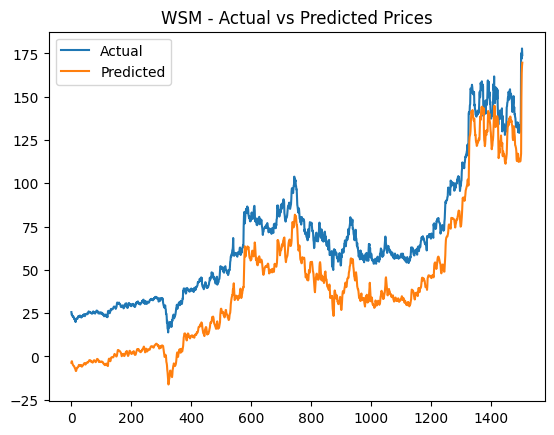

46/46 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for WSO: 169.94590292313802
Root Mean Squared Error (RMSE) for WSO: 13.036330117143322
R² Score for WSO: 0.9849854125728744


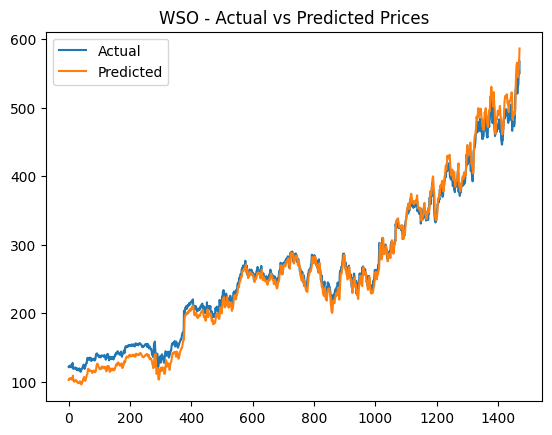

73/73 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for XOM: 683.4520076171158
Root Mean Squared Error (RMSE) for XOM: 26.14291505584478
R² Score for XOM: -0.5343300911294366


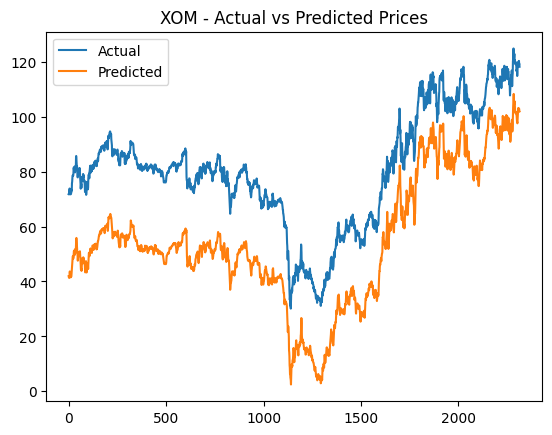

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Mean Squared Error for XPO: 596.9942433732836
Root Mean Squared Error (RMSE) for XPO: 24.433465643933598
R² Score for XPO: 0.5269657643446799


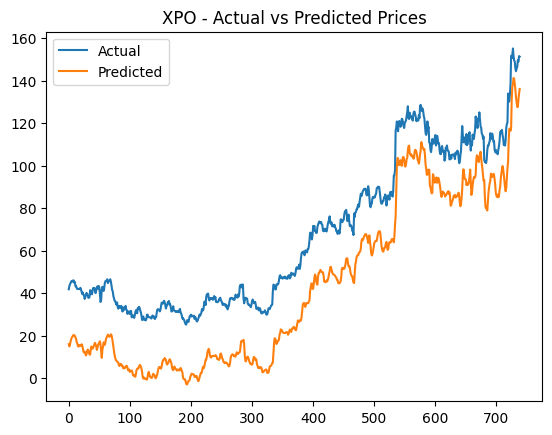

43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Mean Squared Error for XRAY: 699.8124357064818
Root Mean Squared Error (RMSE) for XRAY: 26.453968241201203
R² Score for XRAY: -4.60010096746046


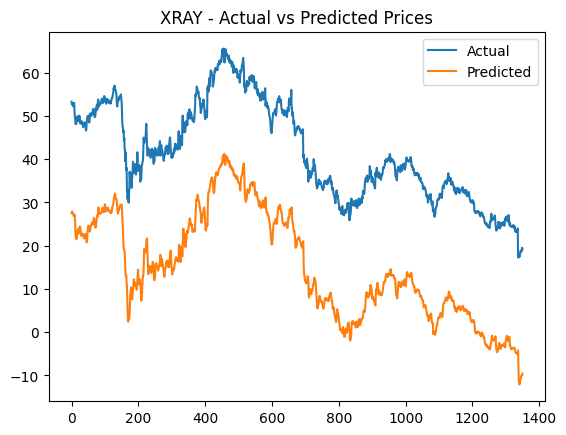

14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for YELP: 716.8744304772446
Root Mean Squared Error (RMSE) for YELP: 26.77451083544281
R² Score for YELP: -30.59001213423252


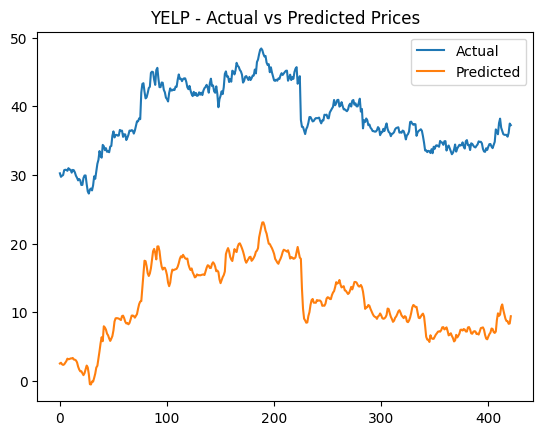

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Mean Squared Error for ZBRA: 245.0477602079117
Root Mean Squared Error (RMSE) for ZBRA: 15.654001412032379
R² Score for ZBRA: 0.979432801956973


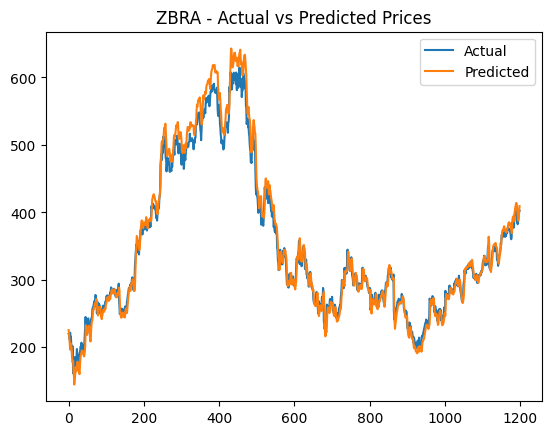

51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Mean Squared Error for ZION: 702.607582109344
Root Mean Squared Error (RMSE) for ZION: 26.506745973607245
R² Score for ZION: -6.839782540432511


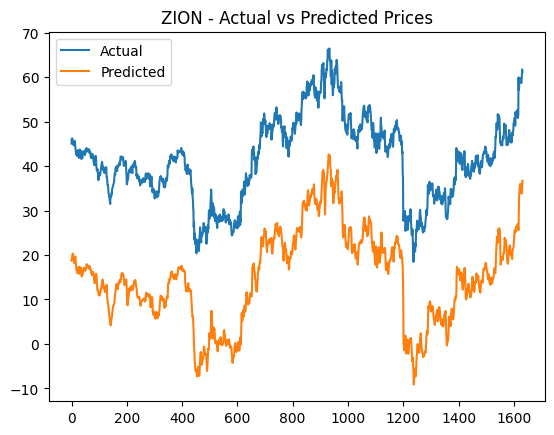

In [11]:
for stock in data['Stock'].unique():
    test_on_stock(lstm_model, stock, model_type='LSTM')

### Hyperparameter Tuning

In [12]:
import keras_tuner as kt
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout, Input

# Define the model
def build_model(hp):
    model = Sequential()
    model.add(Input(shape=(X_train.shape[1], X_train.shape[2])))
    model.add(LSTM(units=hp.Choice('units', [50, 100, 150]),
                   recurrent_dropout=hp.Choice('recurrent_dropout', [0.1, 0.2]),
                   return_sequences=False)) 
    model.add(Dropout(hp.Choice('dropout', [0.2, 0.3])))
    model.add(Dense(units=1))
    model.compile(optimizer=Adam(learning_rate=hp.Choice('learning_rate', [0.0005, 0.001, 0.005])),
                  loss='mean_squared_error')
    return model

tuner = kt.RandomSearch(
    build_model,
    objective='val_loss',
    max_trials=5,
    directory='kt_dir',
    project_name='lstm_tuning_simple'
)

# Run the search
tuner.search(
    X_train, y_train,
    epochs=5,  # Fewer epochs for faster evaluation
    validation_data=(X_valid, y_valid),
    batch_size=32
)

best_hyperparameters = tuner.get_best_hyperparameters(num_trials=1)[0]

print(f"Best Hyperparameters: {best_hyperparameters.values}")

best_model = tuner.hypermodel.build(best_hyperparameters)
history = best_model.fit(
    X_train, y_train,
    validation_data=(X_valid, y_valid),
    epochs=10,  
    batch_size=32
)


Trial 5 Complete [00h 18m 56s]
val_loss: 5.2026087359990925e-05

Best val_loss So Far: 5.2026087359990925e-05
Total elapsed time: 01h 31m 42s
Best Hyperparameters: {'units': 100, 'recurrent_dropout': 0.1, 'dropout': 0.3, 'learning_rate': 0.005}
Epoch 1/10
17866/17866 ━━━━━━━━━━━━━━━━━━━━ 223s 12ms/step - loss: 7.6976e-05 - val_loss: 5.6479e-05
Epoch 2/10
17866/17866 ━━━━━━━━━━━━━━━━━━━━ 217s 12ms/step - loss: 2.7982e-05 - val_loss: 6.3961e-05
Epoch 3/10
17866/17866 ━━━━━━━━━━━━━━━━━━━━ 225s 13ms/step - loss: 2.0437e-05 - val_loss: 9.0766e-05
Epoch 4/10
17866/17866 ━━━━━━━━━━━━━━━━━━━━ 235s 13ms/step - loss: 2.3444e-05 - val_loss: 0.0037
Epoch 5/10
17866/17866 ━━━━━━━━━━━━━━━━━━━━ 236s 13ms/step - loss: 2.2802e-05 - val_loss: 9.9817e-04
Epoch 6/10
17866/17866 ━━━━━━━━━━━━━━━━━━━━ 233s 13ms/step - loss: 1.5022e-05 - val_loss: 0.0027
Epoch 7/10
17866/17866 ━━━━━━━━━━━━━━━━━━━━ 227s 13ms/step - loss: 1.4343e-05 - val_loss: 1.3059e-04
Epoch 8/10
17866/17866 ━━━━━━━━━━━━━━━━━━━━ 232s 13ms/st

28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
Mean Squared Error for 005930.KS: 221906323.69713032
Root Mean Squared Error (RMSE) for 005930.KS: 14896.520523166822
R² Score for 005930.KS: -2.6275315810782143


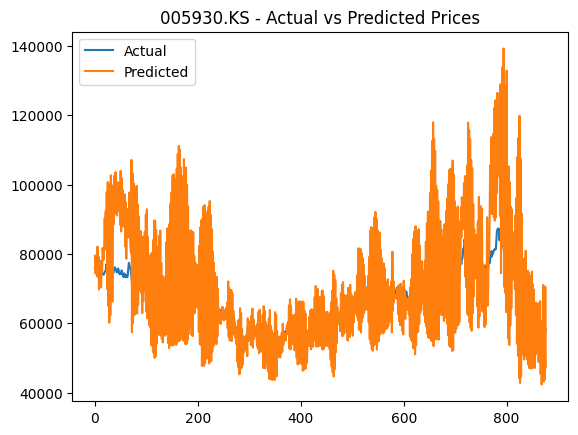

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 
Mean Squared Error for 2222.SR: 0.739746926043526
Root Mean Squared Error (RMSE) for 2222.SR: 0.8600854178763444
R² Score for 2222.SR: -2.012609770548885


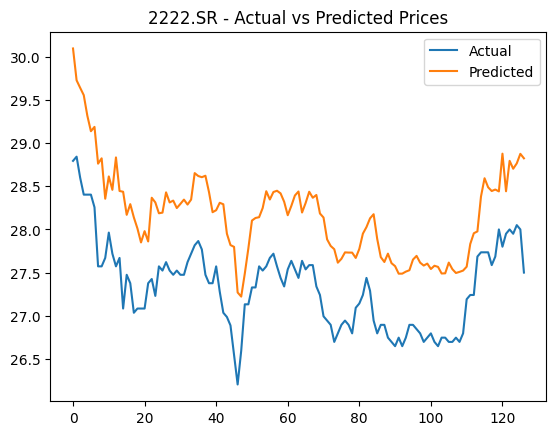

25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for 600519.SS: 1304.8070729350857
Root Mean Squared Error (RMSE) for 600519.SS: 36.12211335089748
R² Score for 600519.SS: 0.9205667638636503


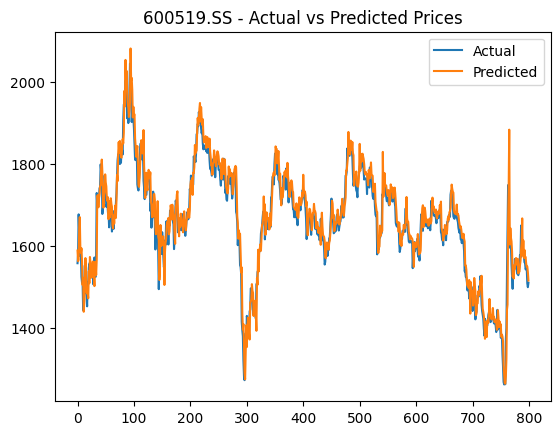

51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for AAPL: 4.532430183741904
Root Mean Squared Error (RMSE) for AAPL: 2.1289504887953368
R² Score for AAPL: 0.9984716902318161


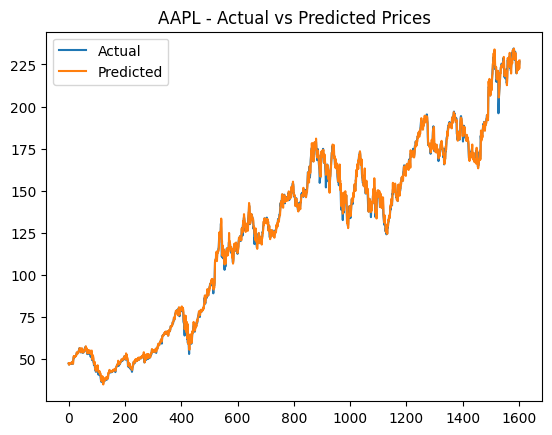

13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
Mean Squared Error for ABBV: 5.21345656726342
Root Mean Squared Error (RMSE) for ABBV: 2.28329949136407
R² Score for ABBV: 0.9857130656757765


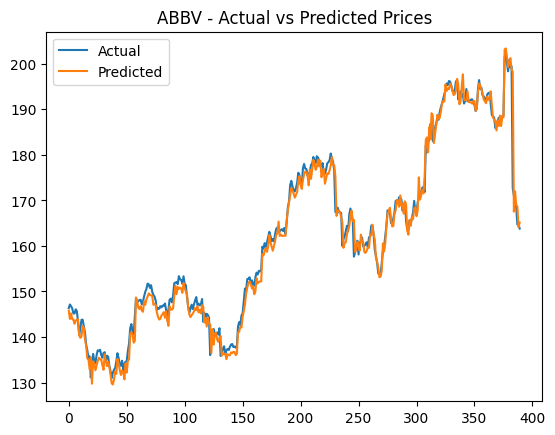

51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for ABT: 2.6105072979387063
Root Mean Squared Error (RMSE) for ABT: 1.6157064392824292
R² Score for ABT: 0.9918546024195964


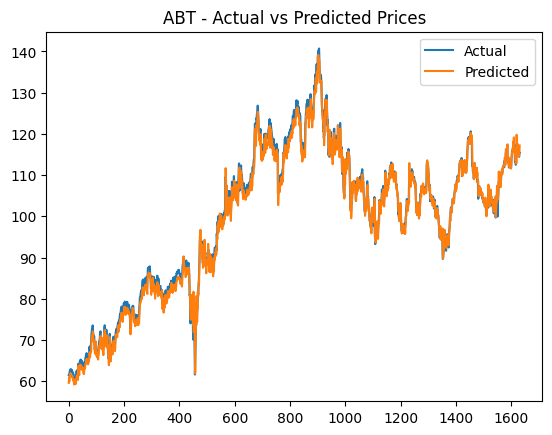

44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for ADBE: 101.40551327717671
Root Mean Squared Error (RMSE) for ADBE: 10.070030450657868
R² Score for ADBE: 0.9911093317249517


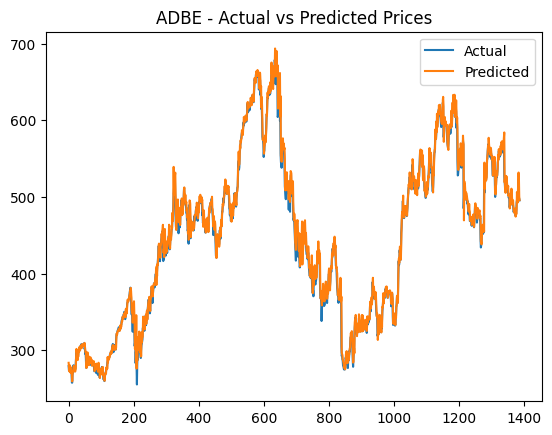

12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
Mean Squared Error for ALLE: 4.576631243753504
Root Mean Squared Error (RMSE) for ALLE: 2.139306252913197
R² Score for ALLE: 0.9762031295098956


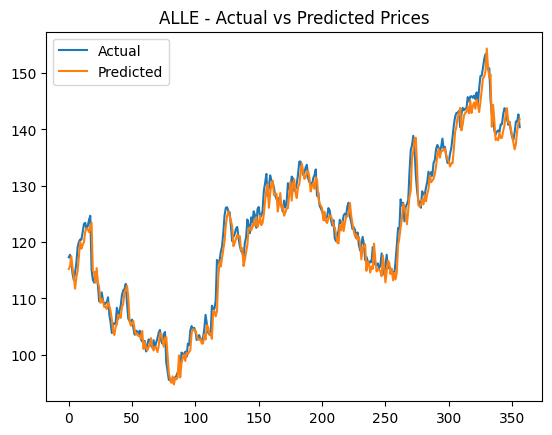

31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for AMZN: 9.022091899580756
Root Mean Squared Error (RMSE) for AMZN: 3.003679726532234
R² Score for AMZN: 0.9902606191211621


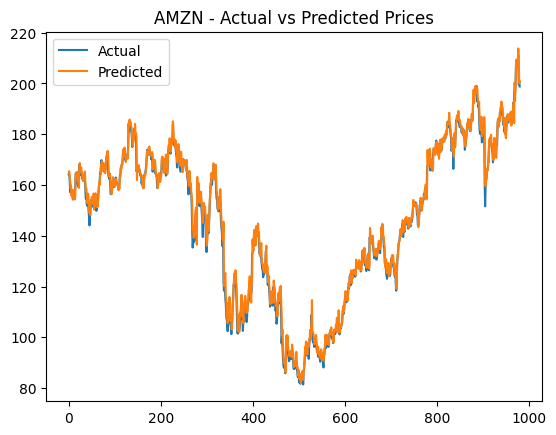

34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for ASML: 298.49422654685804
Root Mean Squared Error (RMSE) for ASML: 17.276985458894675
R² Score for ASML: 0.9882790639649344


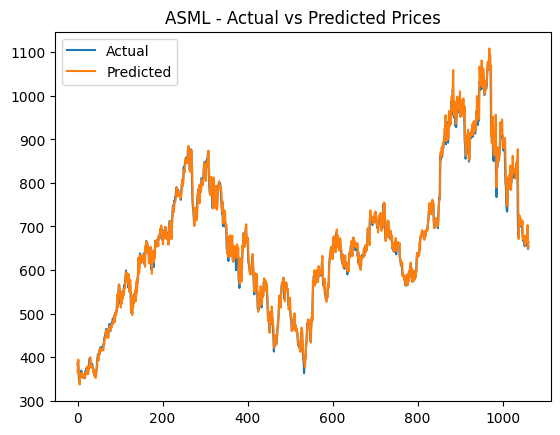

17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for AVGO: 7.547450215598905
Root Mean Squared Error (RMSE) for AVGO: 2.7472623128487212
R² Score for AVGO: 0.9952623315914177


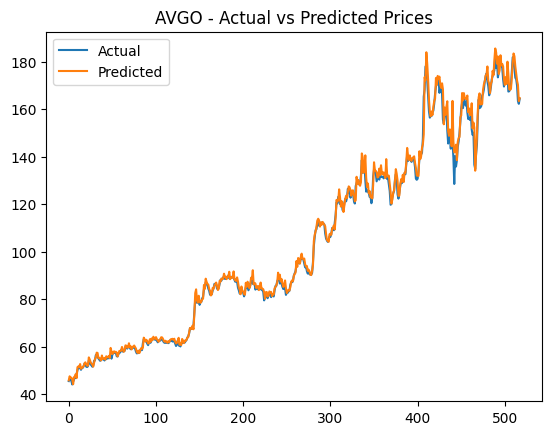

52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for AVY: 10.841884780130496
Root Mean Squared Error (RMSE) for AVY: 3.2927017447880846
R² Score for AVY: 0.9945162658421883


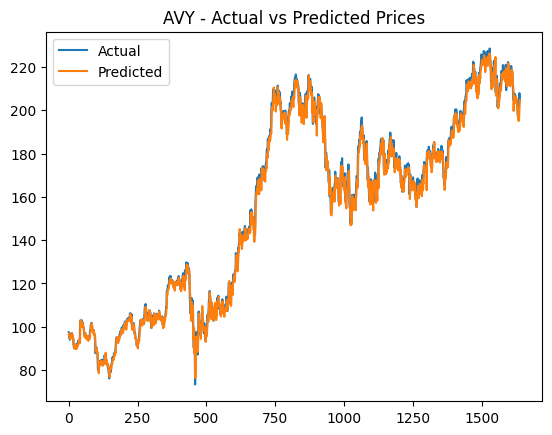

61/61 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for BMY: 2.9911572323270192
Root Mean Squared Error (RMSE) for BMY: 1.72949623657498
R² Score for BMY: 0.9600854865804218


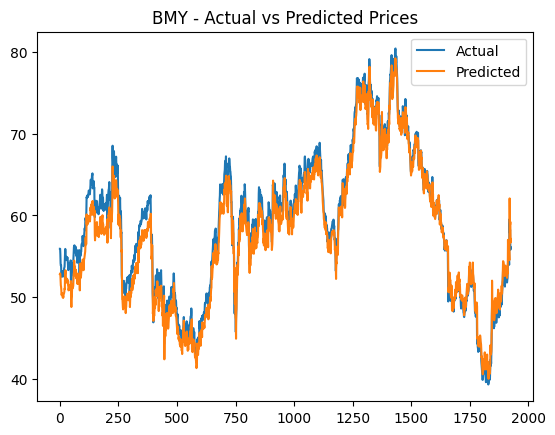

32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for BRK-B: 8.63052042482685
Root Mean Squared Error (RMSE) for BRK-B: 2.937774740313976
R² Score for BRK-B: 0.9976975779440826


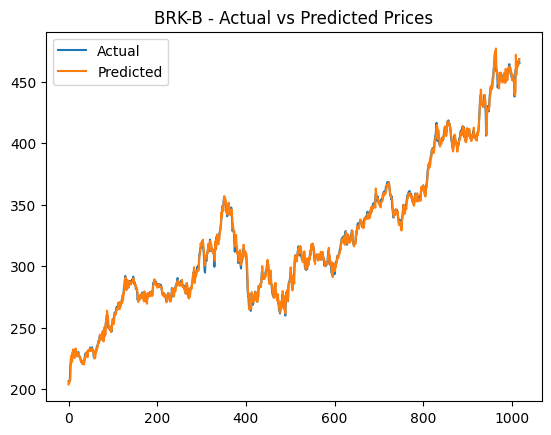

36/36 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for BWA: 1.1406188878782932
Root Mean Squared Error (RMSE) for BWA: 1.0679976066819126
R² Score for BWA: 0.9332478846728893


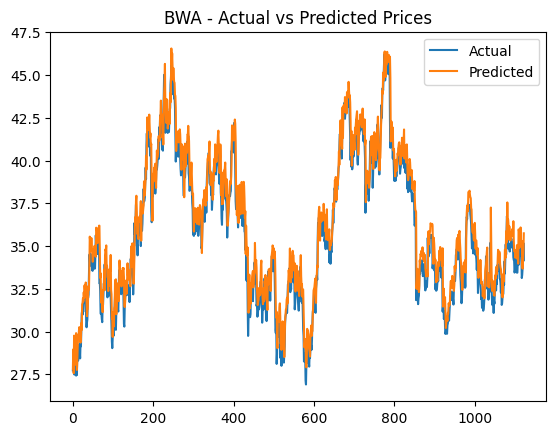

51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Mean Squared Error for CACI: 37.02643240496358
Root Mean Squared Error (RMSE) for CACI: 6.0849348726969605
R² Score for CACI: 0.9942728706610993


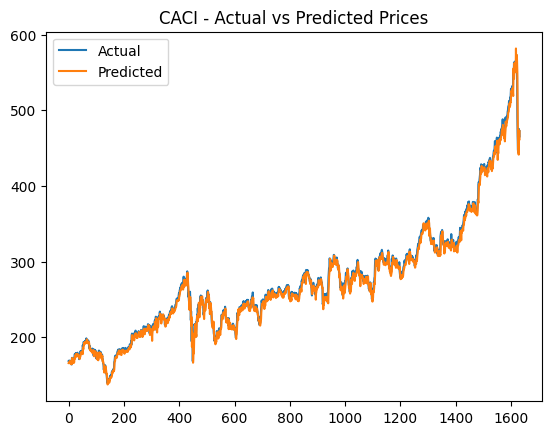

40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for CGNX: 2.6379847541825248
Root Mean Squared Error (RMSE) for CGNX: 1.6241874135032954
R² Score for CGNX: 0.9890222176501624


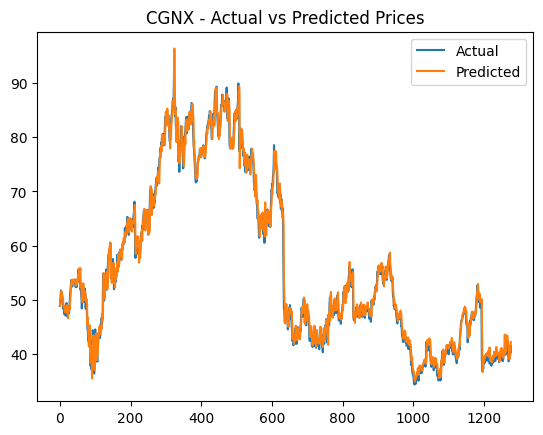

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
Mean Squared Error for CHK: 3.3478389393089234
Root Mean Squared Error (RMSE) for CHK: 1.8297100697402644
R² Score for CHK: 0.9591913637257721


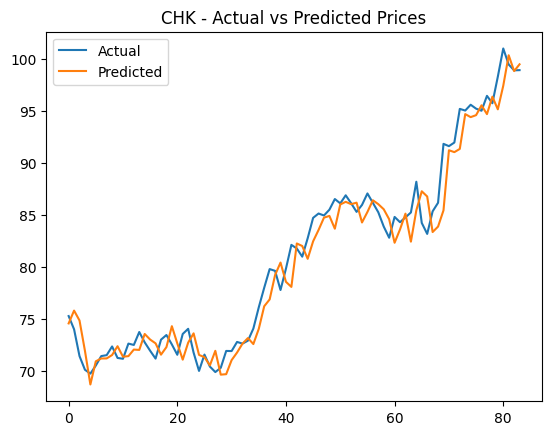

31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for CIEN: 2.007936552736211
Root Mean Squared Error (RMSE) for CIEN: 1.4170167792712305
R² Score for CIEN: 0.9666156650933239


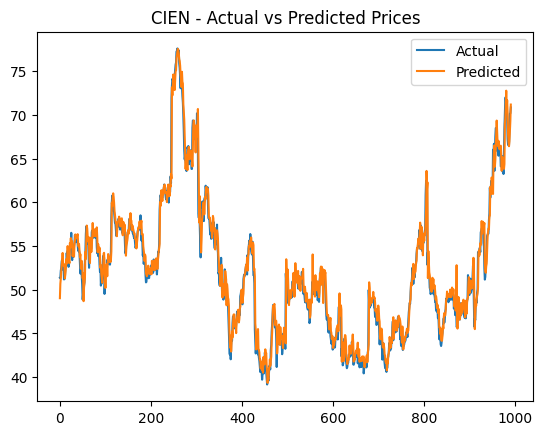

42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for CLH: 9.620534175334548
Root Mean Squared Error (RMSE) for CLH: 3.1016985951788656
R² Score for CLH: 0.996715004762264


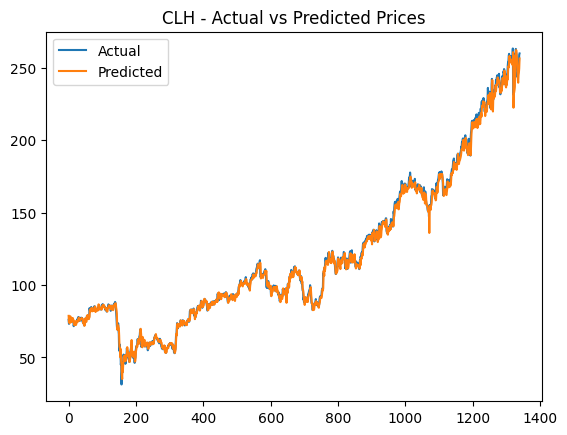

51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for CMCSA: 0.6722910116753784
Root Mean Squared Error (RMSE) for CMCSA: 0.81993354101133
R² Score for CMCSA: 0.9845882559861114


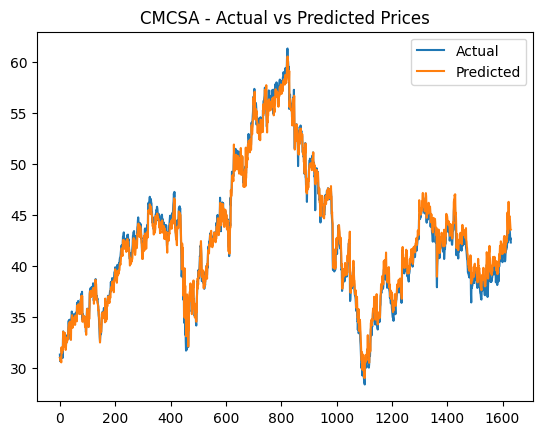

23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
Mean Squared Error for CRM: 21.493224356235192
Root Mean Squared Error (RMSE) for CRM: 4.636078553717052
R² Score for CRM: 0.9909788669227043


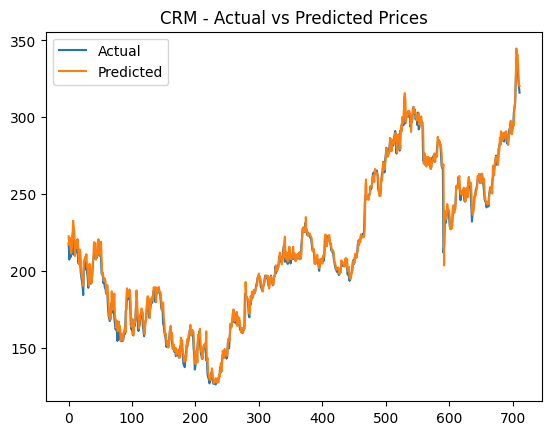

40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for CSCO: 0.7174011460089919
Root Mean Squared Error (RMSE) for CSCO: 0.8469953636289822
R² Score for CSCO: 0.9747528220749933


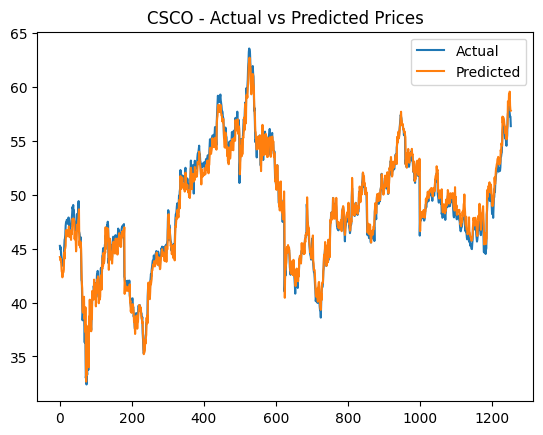

52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for CSL: 28.74622379525821
Root Mean Squared Error (RMSE) for CSL: 5.361550502910348
R² Score for CSL: 0.9968804749908964


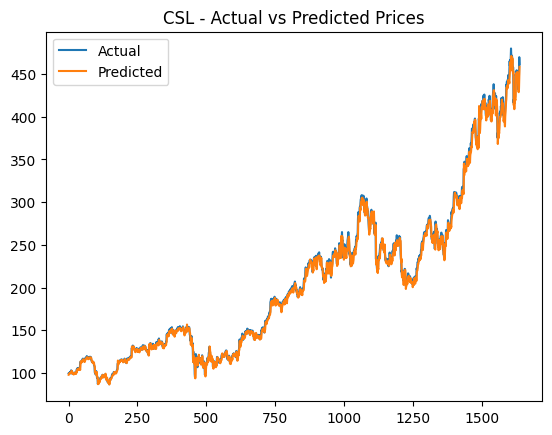

73/73 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for CVX: 34.731113114078184
Root Mean Squared Error (RMSE) for CVX: 5.893310878791156
R² Score for CVX: 0.9530454212449816


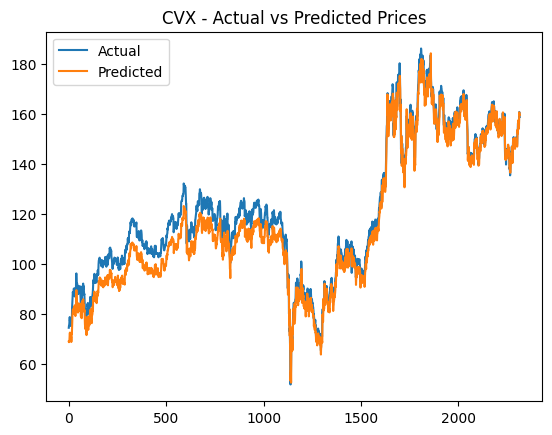

73/73 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for DIS: 4.244045650452572
Root Mean Squared Error (RMSE) for DIS: 2.060108164745864
R² Score for DIS: 0.9938544984055958


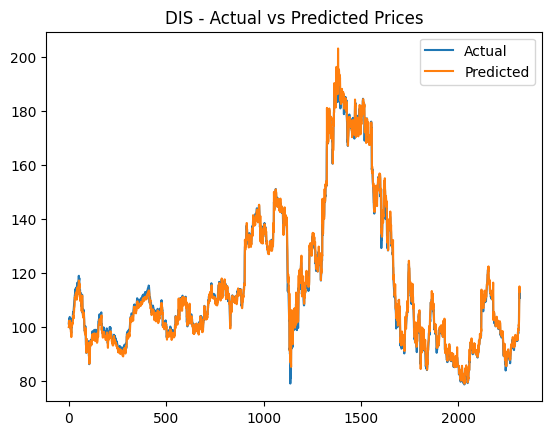

44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for EHC: 1.4196895097588638
Root Mean Squared Error (RMSE) for EHC: 1.1915072428478408
R² Score for EHC: 0.9921265391123528


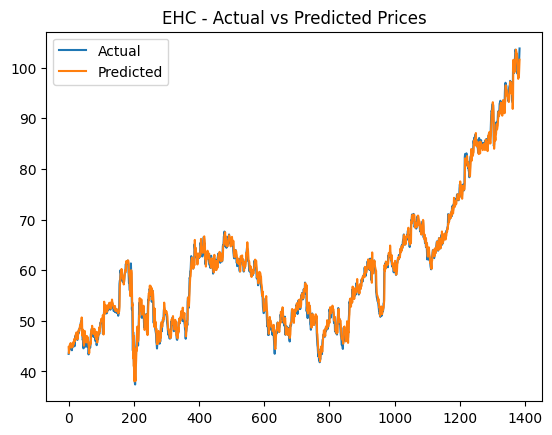

10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
Mean Squared Error for ETSY: 4.0405074465250825
Root Mean Squared Error (RMSE) for ETSY: 2.0101013523016897
R² Score for ETSY: 0.9497194846097481


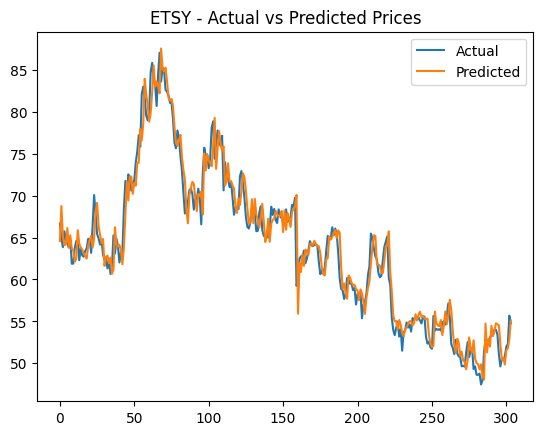

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
Mean Squared Error for FSLR: 49.31946568015116
Root Mean Squared Error (RMSE) for FSLR: 7.022781904640864
R² Score for FSLR: 0.9741290131335328


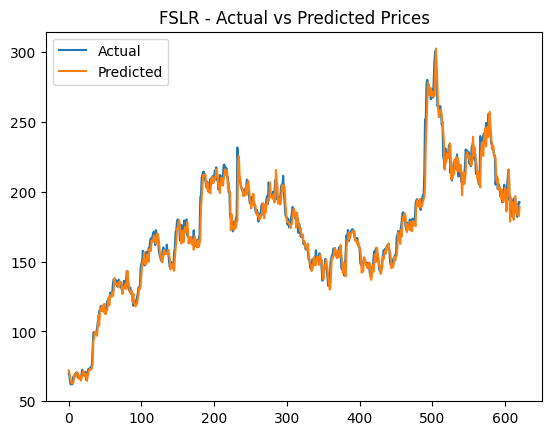

51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for GGG: 1.2487947025543582
Root Mean Squared Error (RMSE) for GGG: 1.1174948333457109
R² Score for GGG: 0.9946693117880089


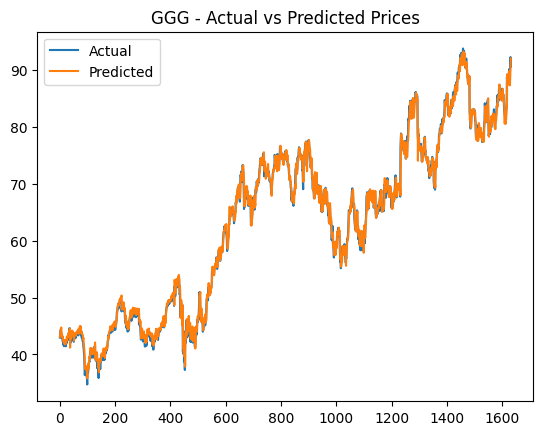

16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for GNRC: 19.95678901200566
Root Mean Squared Error (RMSE) for GNRC: 4.4673022073736695
R² Score for GNRC: 0.9600034701790408


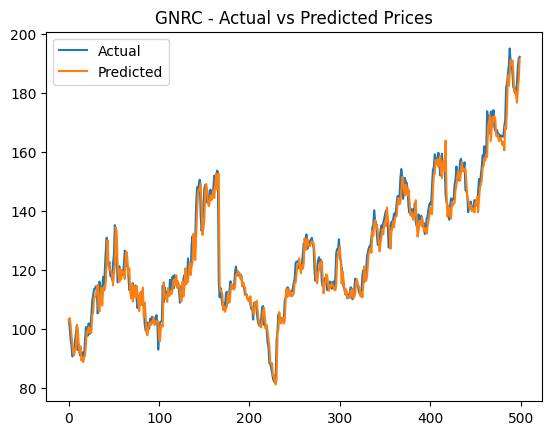

23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for GOOGL: 5.992464231426277
Root Mean Squared Error (RMSE) for GOOGL: 2.447951027170739
R² Score for GOOGL: 0.9912397659841947


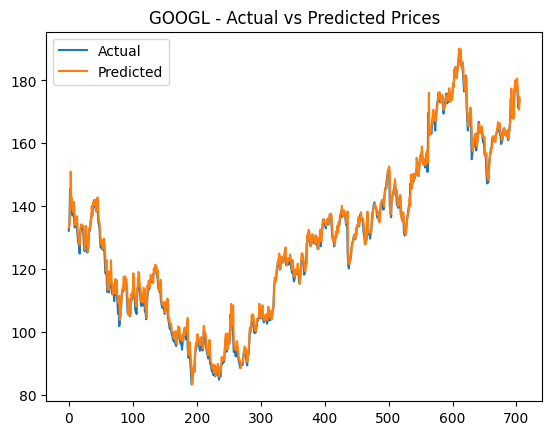

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
Mean Squared Error for HBI: 1.5253564553431866
Root Mean Squared Error (RMSE) for HBI: 1.2350532196400228
R² Score for HBI: 0.5844097837764637


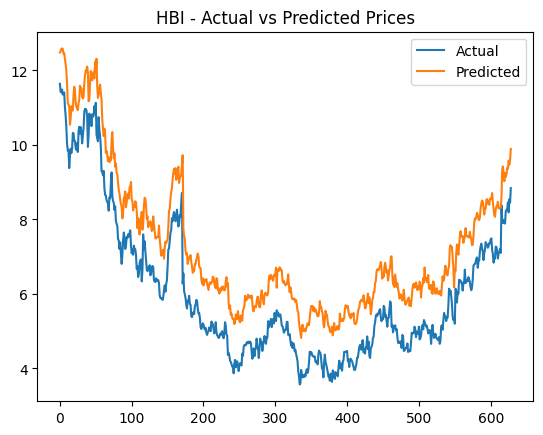

50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for HD: 41.32411953143688
Root Mean Squared Error (RMSE) for HD: 6.428383897328851
R² Score for HD: 0.9891026279028025


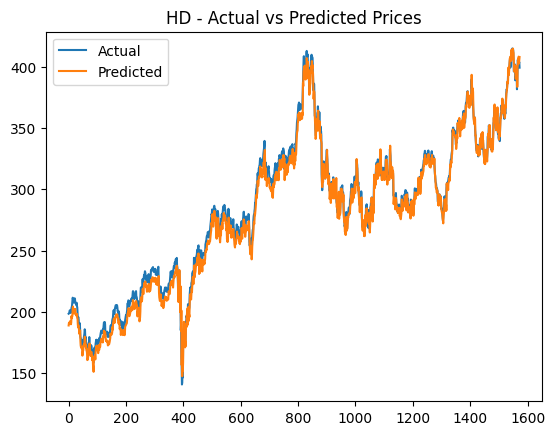

40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for HOLX: 1.848258112501221
Root Mean Squared Error (RMSE) for HOLX: 1.3595065694954258
R² Score for HOLX: 0.980914356397699


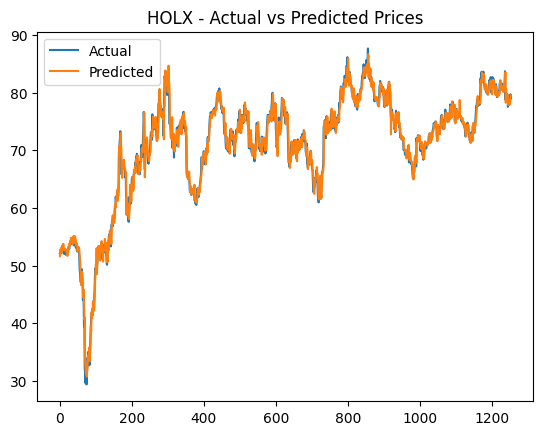

51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Mean Squared Error for HP: 1.8123461364958906
Root Mean Squared Error (RMSE) for HP: 1.346234057099987
R² Score for HP: 0.9799774198450643


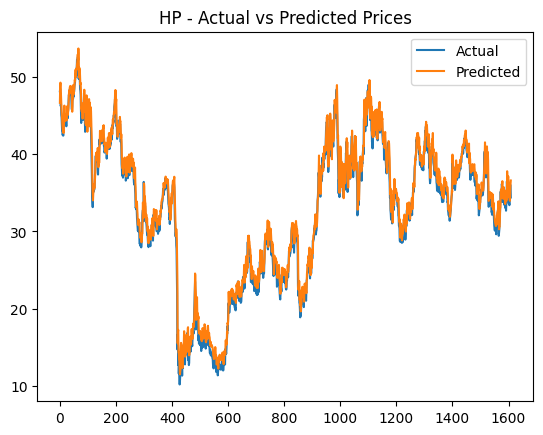

52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for HUBB: 26.670862411697467
Root Mean Squared Error (RMSE) for HUBB: 5.164384030230272
R² Score for HUBB: 0.9971946207111292


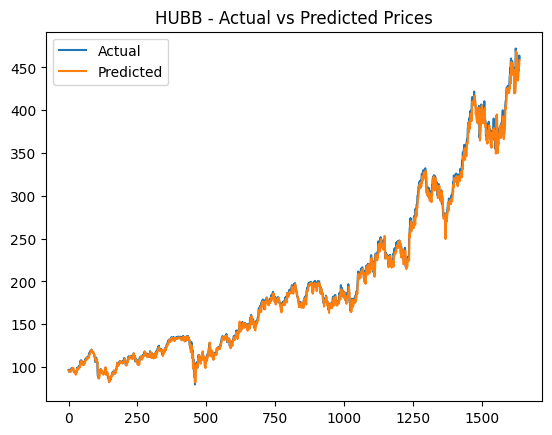

36/36 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for IAC: 8.636423938049719
Root Mean Squared Error (RMSE) for IAC: 2.9387793278927425
R² Score for IAC: 0.994203856056248


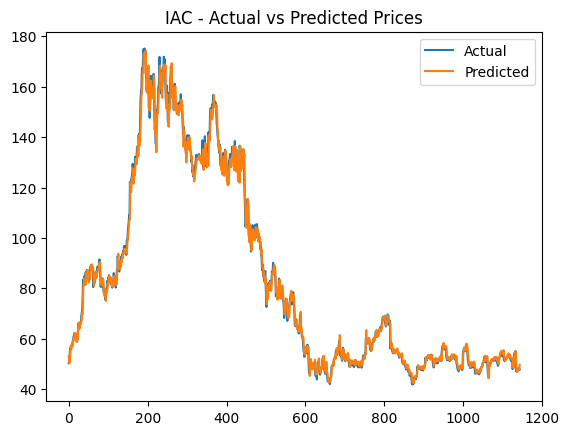

27/27 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for ILMN: 60.28387871891825
Root Mean Squared Error (RMSE) for ILMN: 7.7642693615637945
R² Score for ILMN: 0.9946494223493109


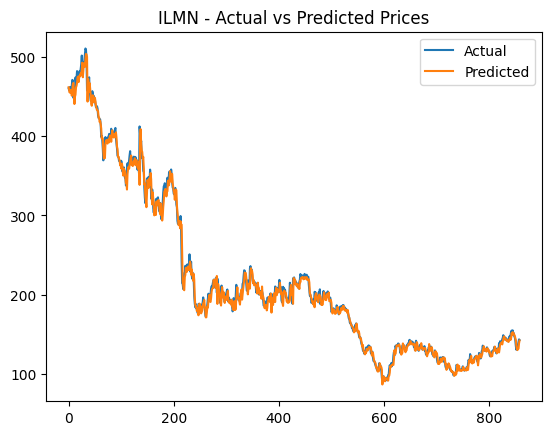

51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for INTC: 1.7076725646813555
Root Mean Squared Error (RMSE) for INTC: 1.3067794629092375
R² Score for INTC: 0.9866797876682436


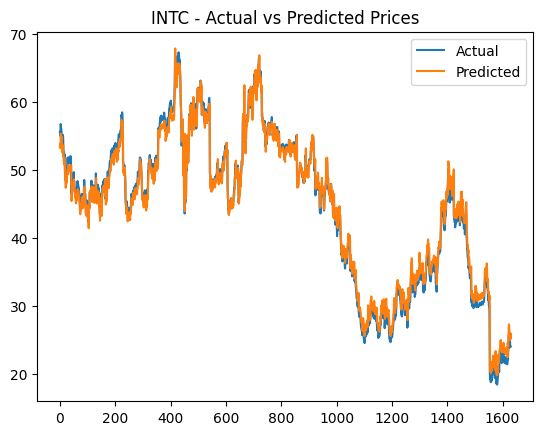

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 
Mean Squared Error for IR: 3.1278549052684226
Root Mean Squared Error (RMSE) for IR: 1.7685742577761394
R² Score for IR: 0.9202449747290973


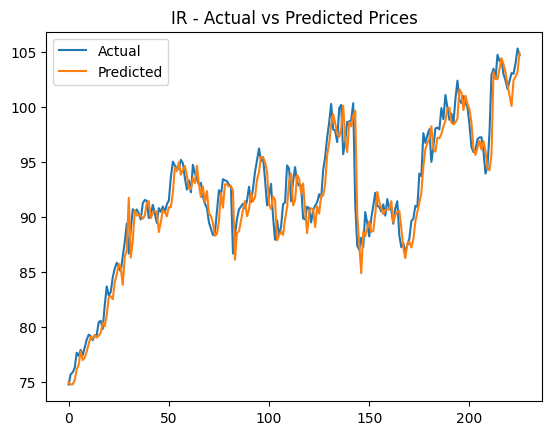

19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for JAZZ: 7.0058757708366555
Root Mean Squared Error (RMSE) for JAZZ: 2.64686149445653
R² Score for JAZZ: 0.973404240102668


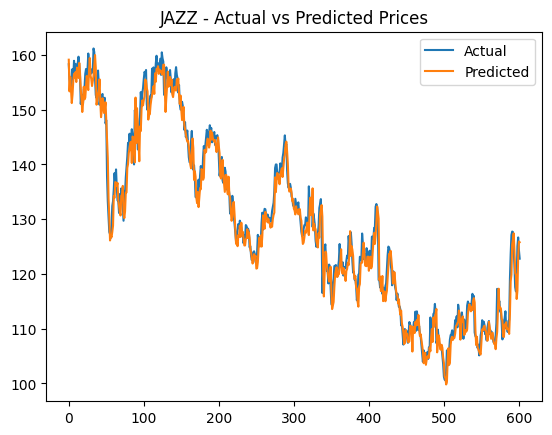

47/47 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for JBHT: 12.621606458175815
Root Mean Squared Error (RMSE) for JBHT: 3.552690031254601
R² Score for JBHT: 0.9901220197360712


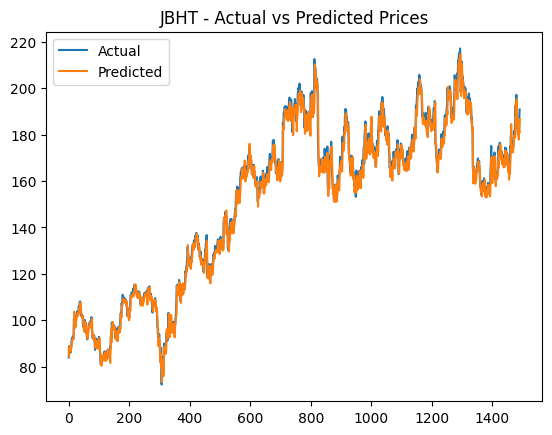

73/73 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Mean Squared Error for JNJ: 23.212334904885854
Root Mean Squared Error (RMSE) for JNJ: 4.817918108985027
R² Score for JNJ: 0.94621311856425


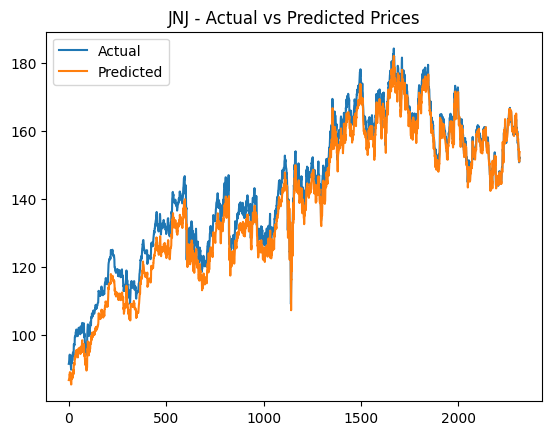

51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for JPM: 12.09706436999891
Root Mean Squared Error (RMSE) for JPM: 3.478083433444188
R² Score for JPM: 0.9887047648906742


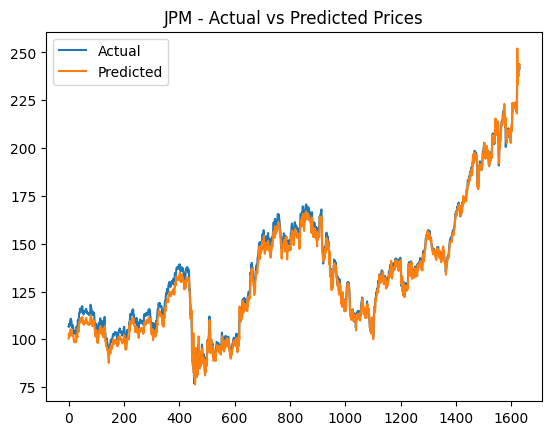

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for KBR: 1.2574357570126686
Root Mean Squared Error (RMSE) for KBR: 1.1213544297021654
R² Score for KBR: 0.9739740630565064


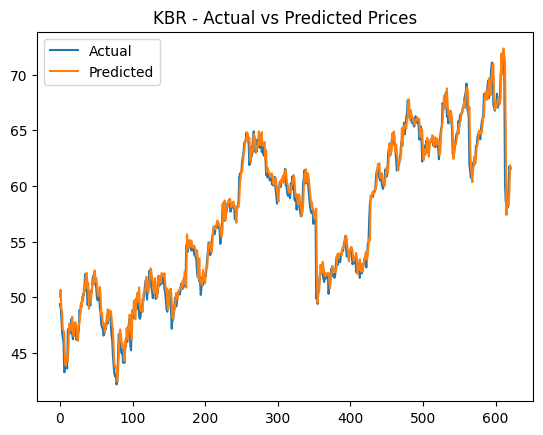

11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
Mean Squared Error for KEYS: 11.70265462164873
Root Mean Squared Error (RMSE) for KEYS: 3.420914296156618
R² Score for KEYS: 0.9182283290436288


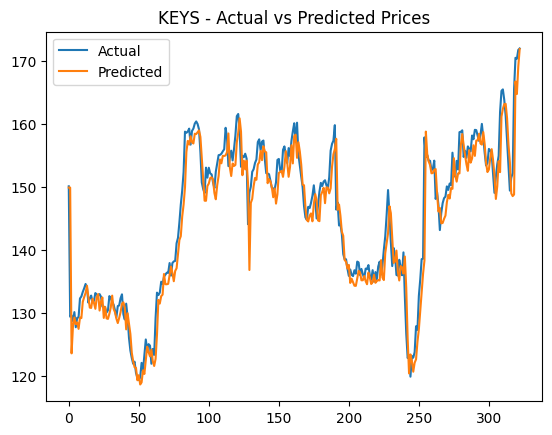

73/73 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Mean Squared Error for KO: 1.8477955835842794
Root Mean Squared Error (RMSE) for KO: 1.359336449737253
R² Score for KO: 0.9701717839237997


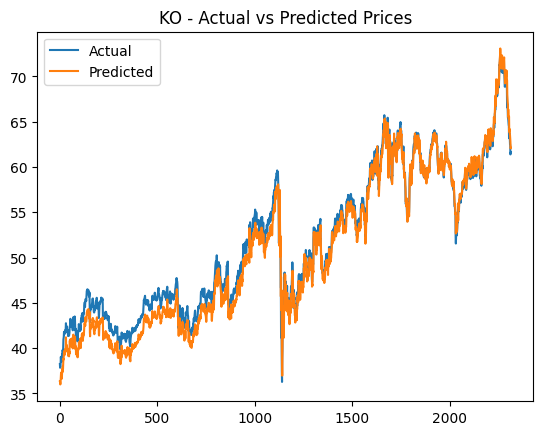

29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for LII: 70.88286876572383
Root Mean Squared Error (RMSE) for LII: 8.419196444181821
R² Score for LII: 0.9950423507059836


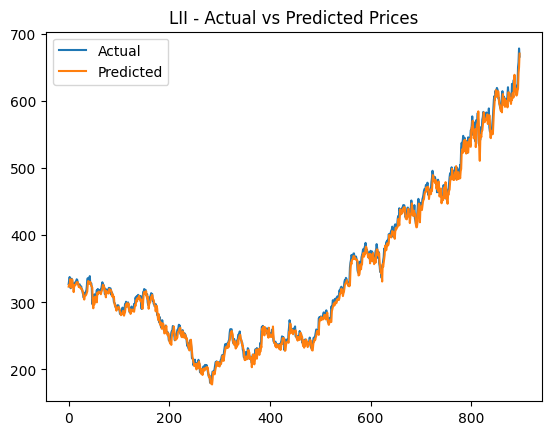

10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
Mean Squared Error for LITE: 4.066781995094136
Root Mean Squared Error (RMSE) for LITE: 2.0166263895660337
R² Score for LITE: 0.9631311868852171


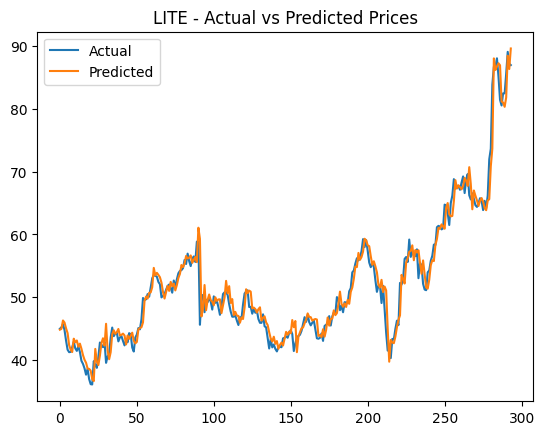

61/61 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for LLY: 52.91850631207339
Root Mean Squared Error (RMSE) for LLY: 7.2745107266450155
R² Score for LLY: 0.9990117083637661


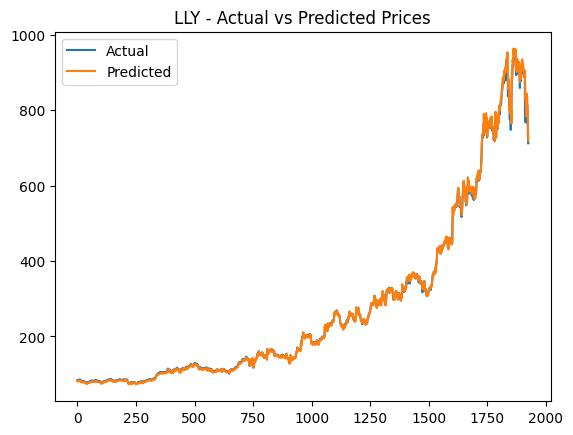

21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
Mean Squared Error for LVMUY: 7.935561525911883
Root Mean Squared Error (RMSE) for LVMUY: 2.817012872869395
R² Score for LVMUY: 0.9832707452753278


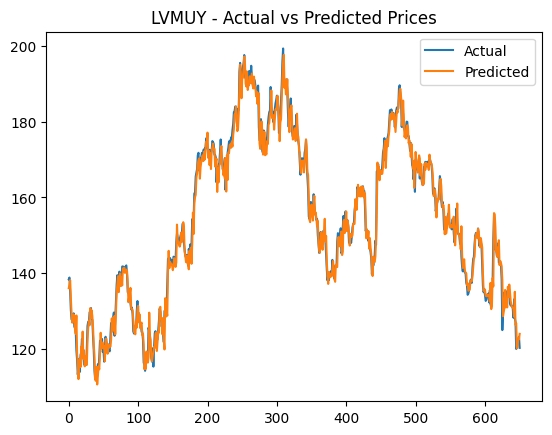

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for MA: 17.12145867704448
Root Mean Squared Error (RMSE) for MA: 4.1378084389015015
R² Score for MA: 0.9949724577488267


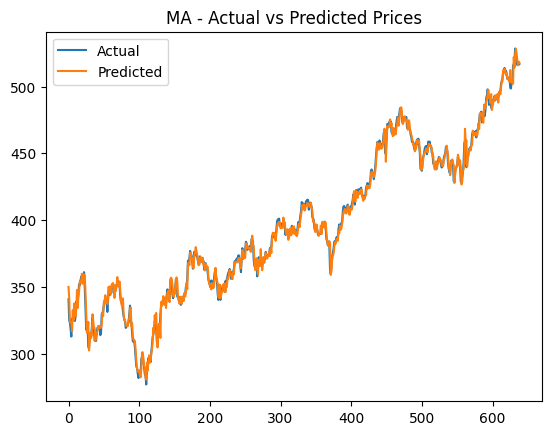

19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for MASI: 17.34952382008426
Root Mean Squared Error (RMSE) for MASI: 4.165275959655526
R² Score for MASI: 0.9751779248733671


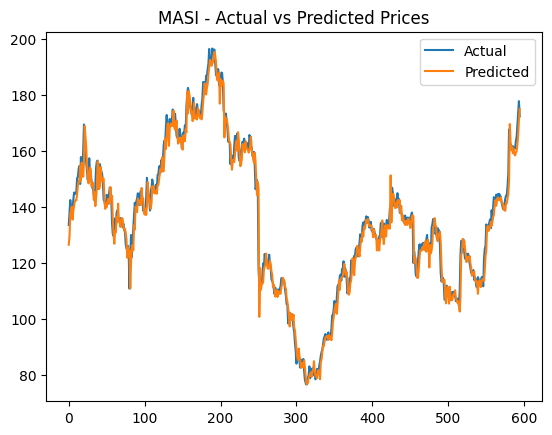

13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
Mean Squared Error for META: 79.6465074627285
Root Mean Squared Error (RMSE) for META: 8.924489198980998
R² Score for META: 0.9937515226354616


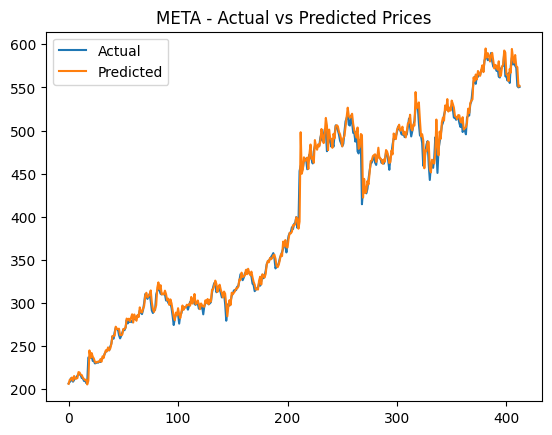

73/73 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Mean Squared Error for MRK: 4.431701647716123
Root Mean Squared Error (RMSE) for MRK: 2.1051607177876286
R² Score for MRK: 0.9904826846544027


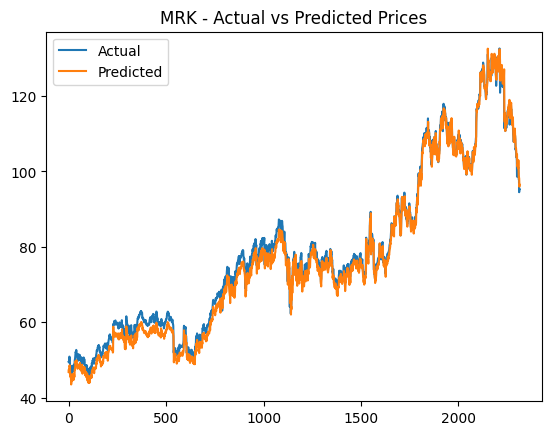

44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Mean Squared Error for MSFT: 16.076236458009987
Root Mean Squared Error (RMSE) for MSFT: 4.009518232657134
R² Score for MSFT: 0.9979321452206568


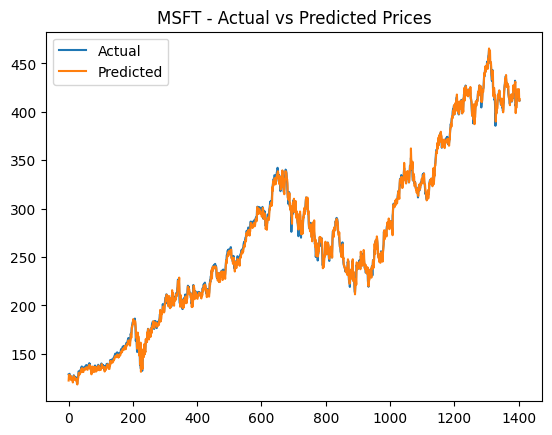

51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for NKE: 4.352422557016077
Root Mean Squared Error (RMSE) for NKE: 2.086246044218197
R² Score for NKE: 0.9933828148599477


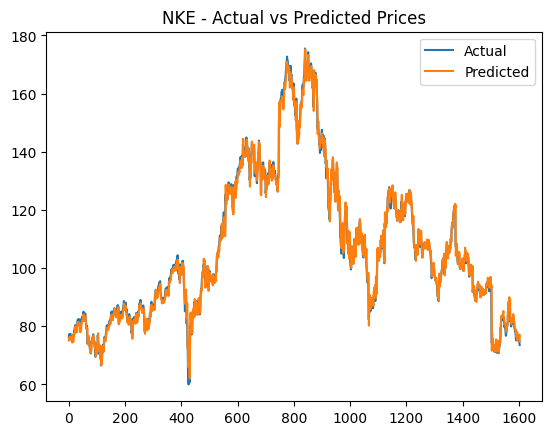

35/35 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Mean Squared Error for NKTR: 1.6834436047751515
Root Mean Squared Error (RMSE) for NKTR: 1.2974758590336668
R² Score for NKTR: 0.9713950490619684


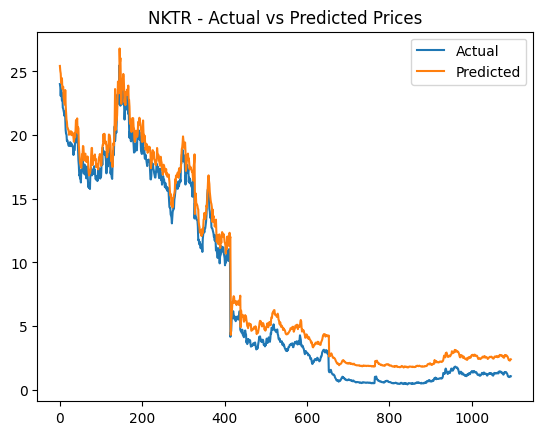

32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Mean Squared Error for NSRGY: 5.9935297080888095
Root Mean Squared Error (RMSE) for NSRGY: 2.448168643718976
R² Score for NSRGY: 0.9372435279462562


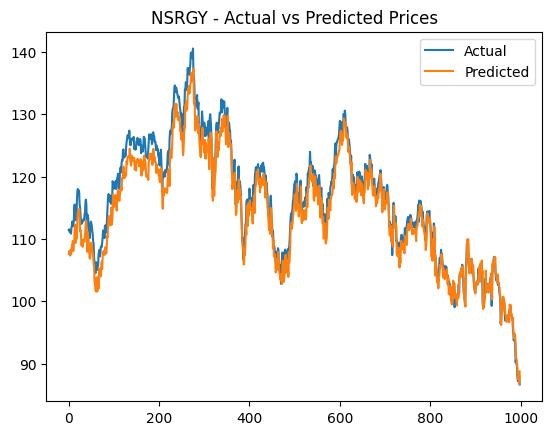

29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
Mean Squared Error for NVDA: 5.225343288190829
Root Mean Squared Error (RMSE) for NVDA: 2.2859009795244476
R² Score for NVDA: 0.9960872872002371


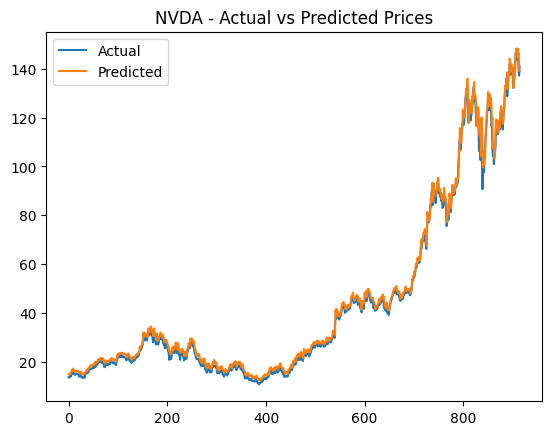

50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for NVO: 1.660325692949285
Root Mean Squared Error (RMSE) for NVO: 1.2885362598504106
R² Score for NVO: 0.9985873642693799


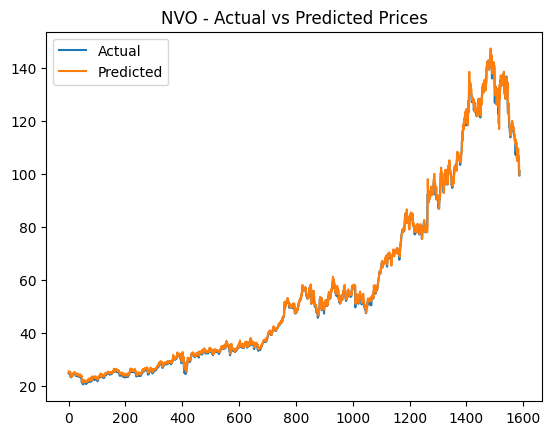

32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for NVS: 4.036785967760599
Root Mean Squared Error (RMSE) for NVS: 2.009175444743589
R² Score for NVS: 0.9572184535590206


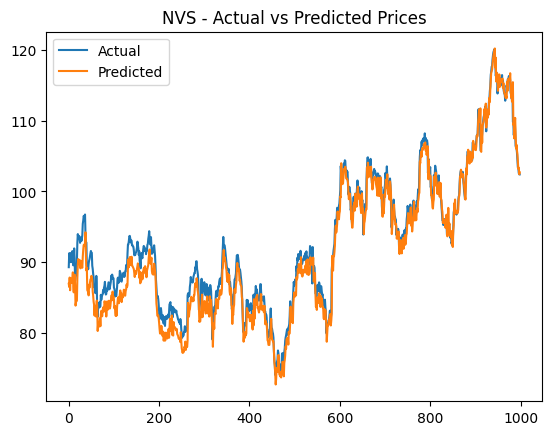

6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
Mean Squared Error for NVT: 3.7832690746978392
Root Mean Squared Error (RMSE) for NVT: 1.9450627431262568
R² Score for NVT: 0.8717181200388678


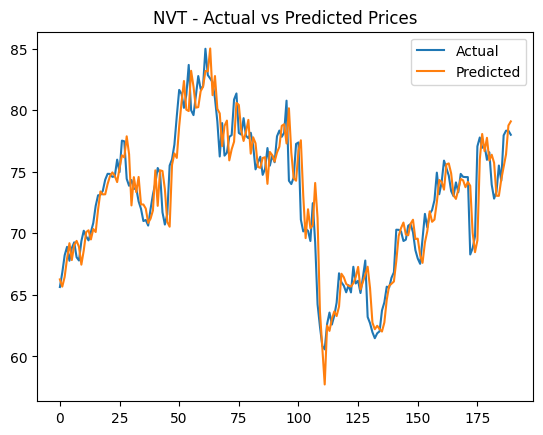

52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for OLN: 1.7169457572803197
Root Mean Squared Error (RMSE) for OLN: 1.3103227683591245
R² Score for OLN: 0.9937942734984888


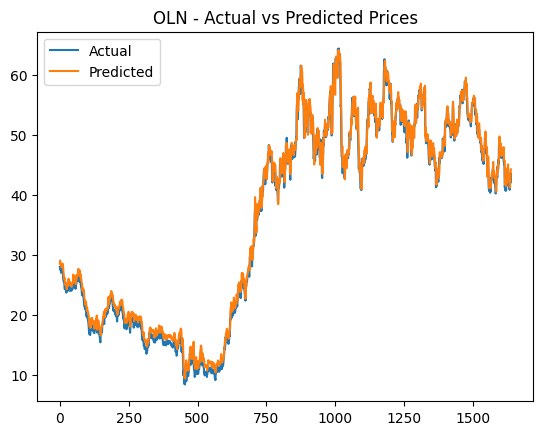

44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for ORCL: 2.295767207265363
Root Mean Squared Error (RMSE) for ORCL: 1.5151789357252043
R² Score for ORCL: 0.9974322542536675


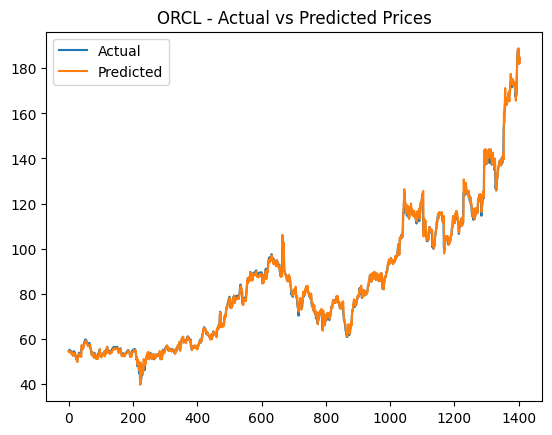

61/61 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for PEP: 17.06988322996187
Root Mean Squared Error (RMSE) for PEP: 4.131571520615596
R² Score for PEP: 0.9736369993334758


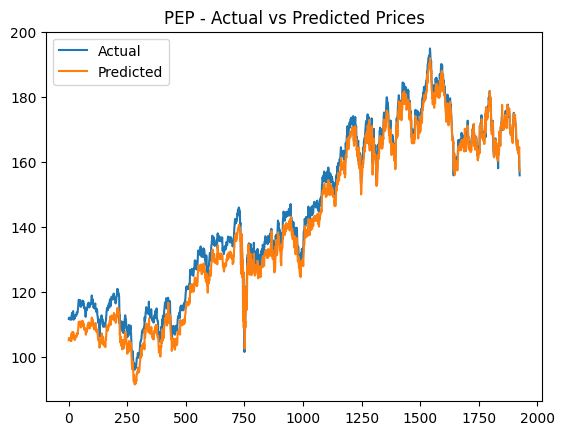

61/61 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Mean Squared Error for PFE: 1.1557784412730923
Root Mean Squared Error (RMSE) for PFE: 1.075071365665132
R² Score for PFE: 0.9759577661285394


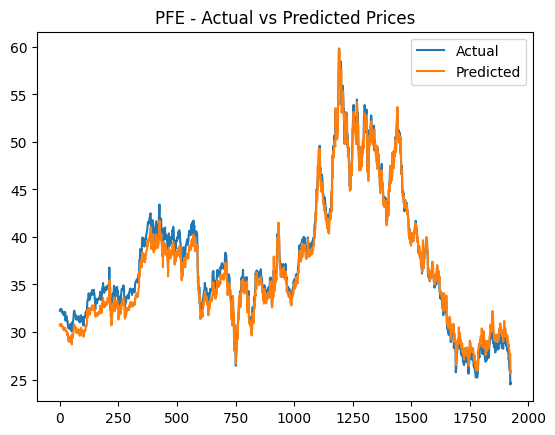

73/73 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for PG: 11.345429526286688
Root Mean Squared Error (RMSE) for PG: 3.368297719366073
R² Score for PG: 0.9876466808447094


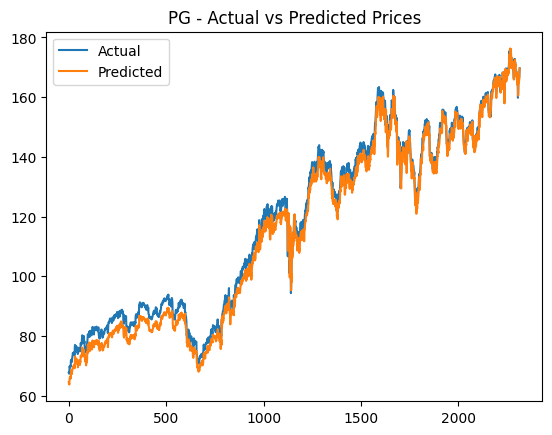

52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for PNW: 1.3851879632463313
Root Mean Squared Error (RMSE) for PNW: 1.1769400848158462
R² Score for PNW: 0.9728927114113141


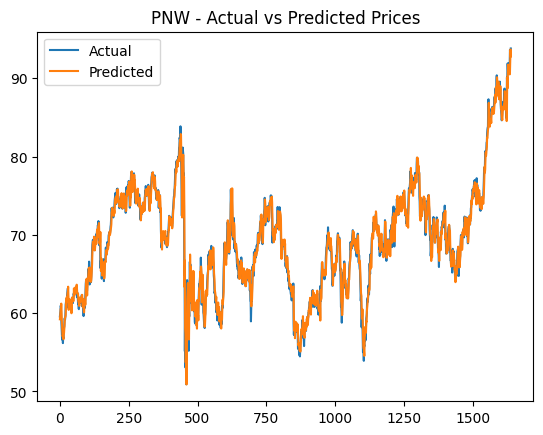

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
Mean Squared Error for PSTG: 3.14120515638193
Root Mean Squared Error (RMSE) for PSTG: 1.7723445365904253
R² Score for PSTG: 0.968740962519679


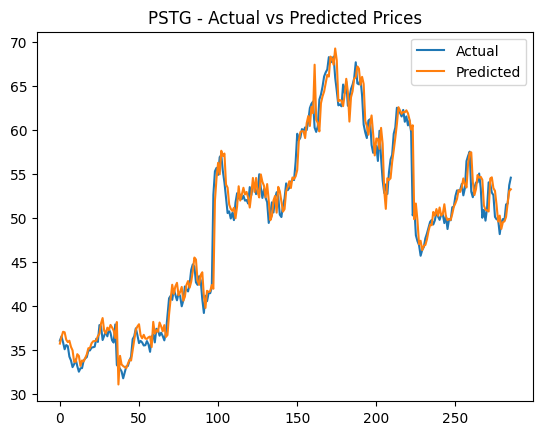

30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for PWR: 18.897981192742677
Root Mean Squared Error (RMSE) for PWR: 4.347180832763077
R² Score for PWR: 0.9954642935029138


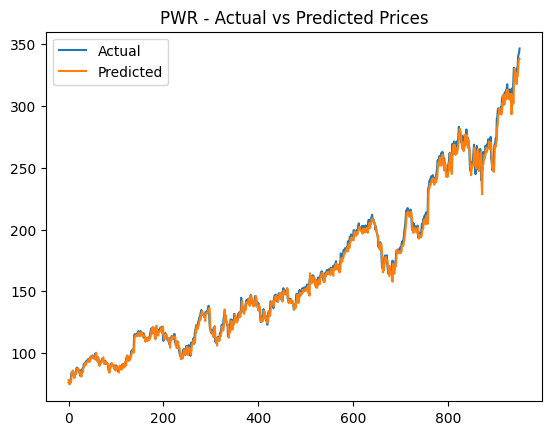

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
Mean Squared Error for RHHBY: 0.5662147632961514
Root Mean Squared Error (RMSE) for RHHBY: 0.7524724335788996
R² Score for RHHBY: 0.9782392696890218


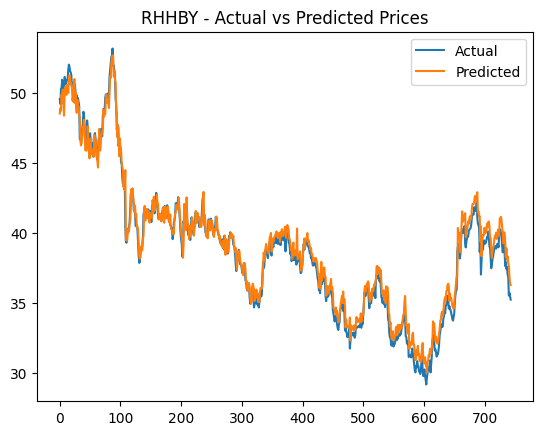

31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for RL: 10.758260773662085
Root Mean Squared Error (RMSE) for RL: 3.279978776404214
R² Score for RL: 0.9892409184579971


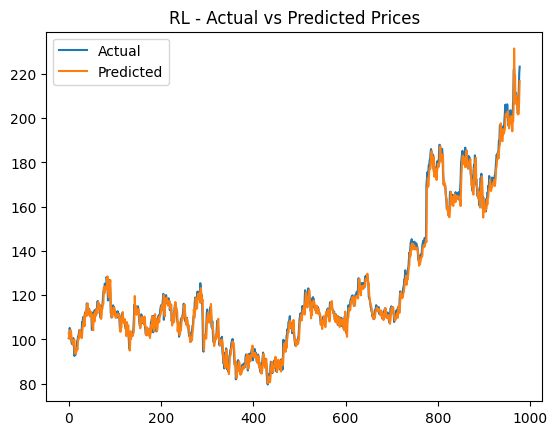

51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for SEE: 1.2065958566059127
Root Mean Squared Error (RMSE) for SEE: 1.0984515722624792
R² Score for SEE: 0.9877551350539371


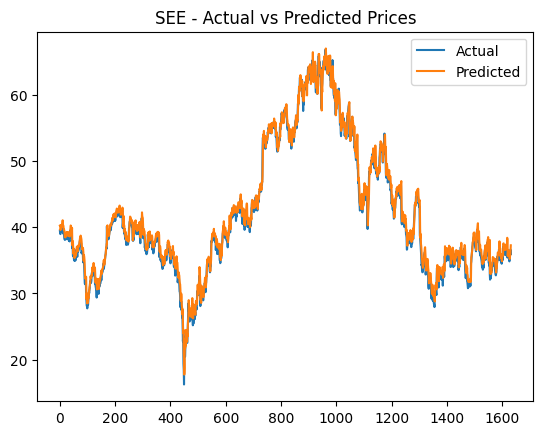

12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
Mean Squared Error for SFM: 2.9958296709424306
Root Mean Squared Error (RMSE) for SFM: 1.7308465185978885
R² Score for SFM: 0.9966474014678767


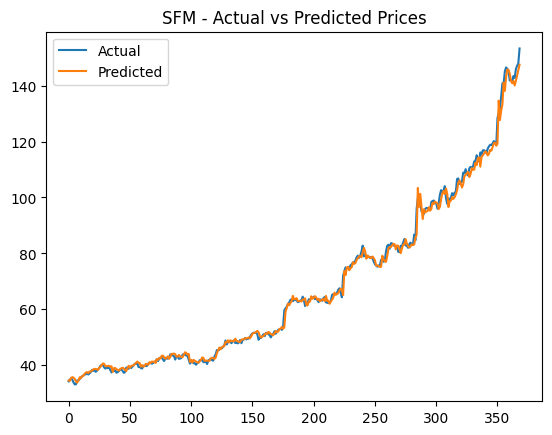

47/47 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Mean Squared Error for SHEL: 2.4121285533050836
Root Mean Squared Error (RMSE) for SHEL: 1.5531028791760975
R² Score for SHEL: 0.9847201780277179


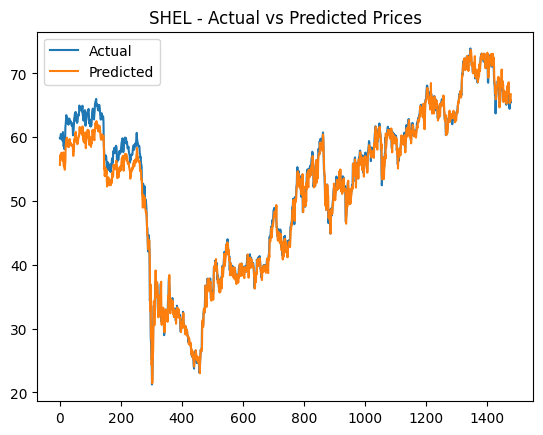

31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for SRPT: 25.809036369053228
Root Mean Squared Error (RMSE) for SRPT: 5.080259478516155
R² Score for SRPT: 0.9556006918058245


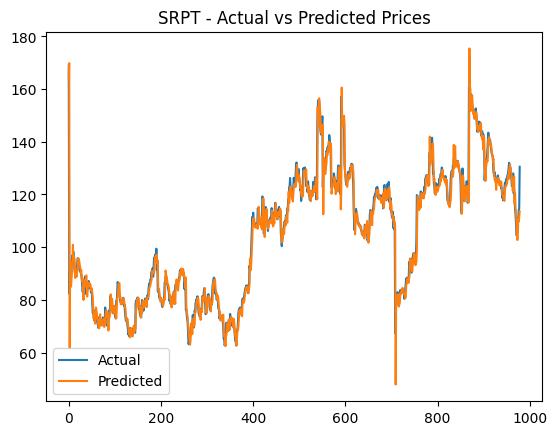

16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
Mean Squared Error for TCEHY: 1.7657938308125223
Root Mean Squared Error (RMSE) for TCEHY: 1.328831754140652
R² Score for TCEHY: 0.9392355138108774


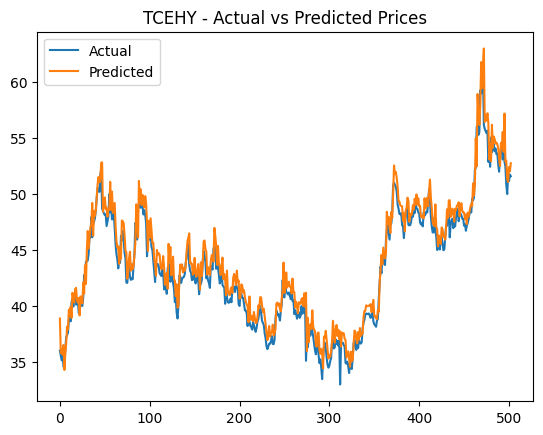

52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Mean Squared Error for TER: 8.916393661785163
Root Mean Squared Error (RMSE) for TER: 2.986033097905173
R² Score for TER: 0.9921025669868706


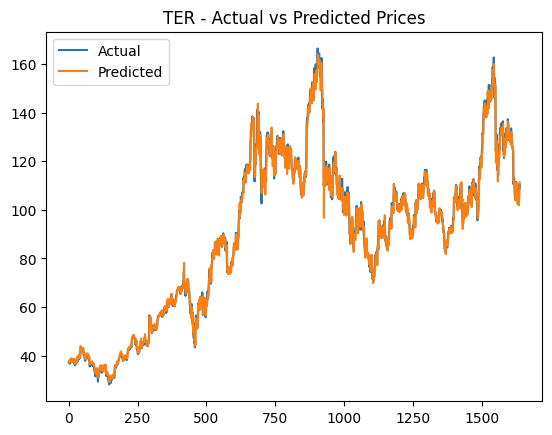

51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for TM: 5.17241852841061
Root Mean Squared Error (RMSE) for TM: 2.2742951717863296
R² Score for TM: 0.9941928293345016


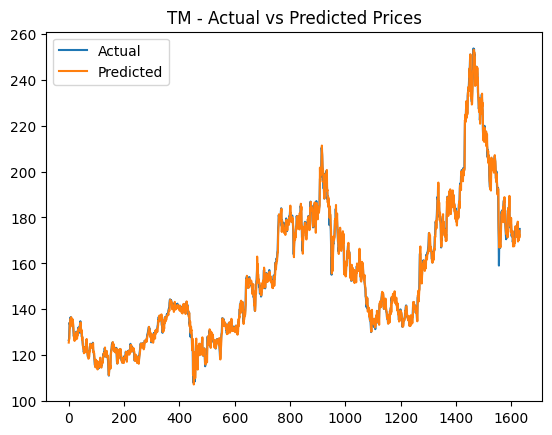

51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for TMO: 47.96230746055385
Root Mean Squared Error (RMSE) for TMO: 6.925482471319515
R² Score for TMO: 0.9971733453942973


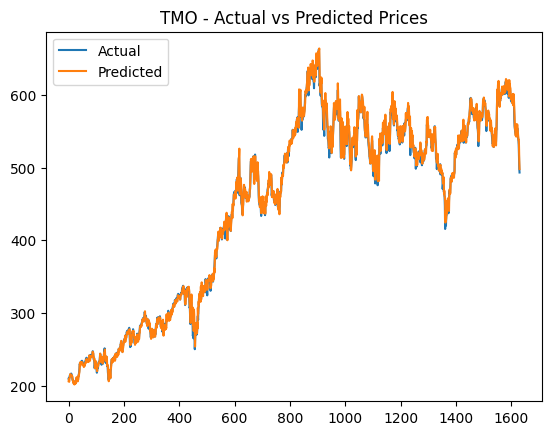

16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
Mean Squared Error for TSLA: 54.01370380814079
Root Mean Squared Error (RMSE) for TSLA: 7.349401595241669
R² Score for TSLA: 0.9681477261412211


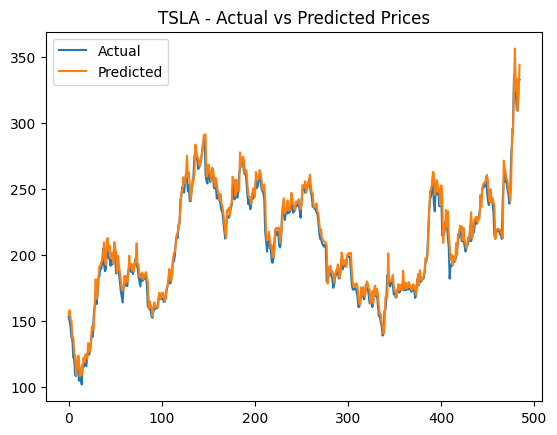

31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
Mean Squared Error for TSM: 6.749068439997211
Root Mean Squared Error (RMSE) for TSM: 2.5978969263612464
R² Score for TSM: 0.9924909757455024


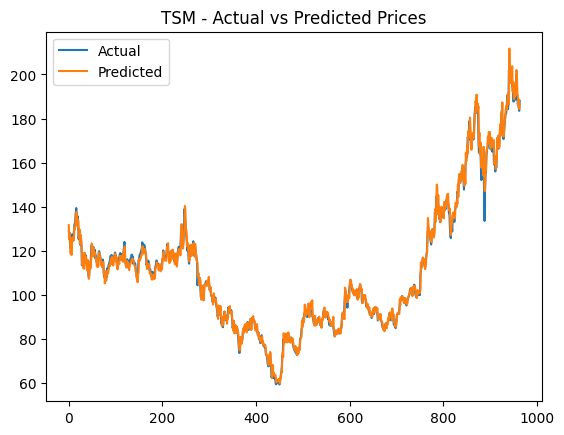

51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for TT: 13.725784612518407
Root Mean Squared Error (RMSE) for TT: 3.7048326024961513
R² Score for TT: 0.9979707452185332


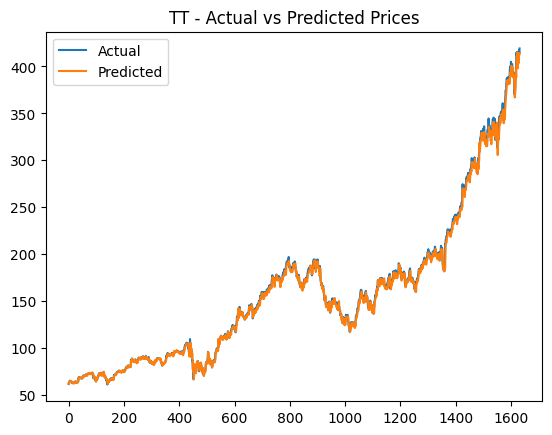

14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
Mean Squared Error for UI: 36.92691732944166
Root Mean Squared Error (RMSE) for UI: 6.076752202405628
R² Score for UI: 0.9879337375297496


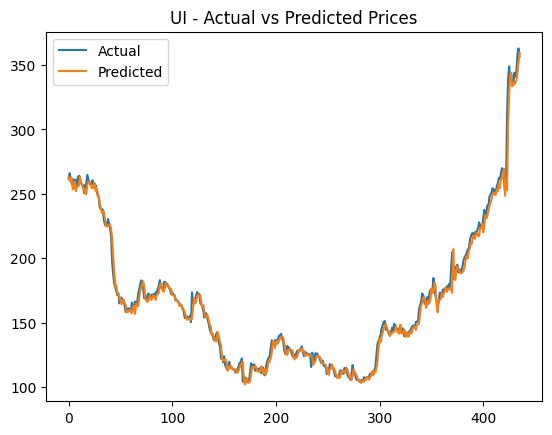

46/46 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for UNH: 44.736179352151645
Root Mean Squared Error (RMSE) for UNH: 6.688510996638313
R² Score for UNH: 0.9963663362265044


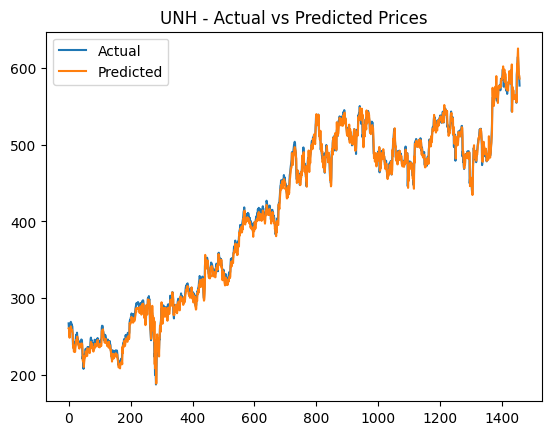

18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
Mean Squared Error for V: 5.548924767667508
Root Mean Squared Error (RMSE) for V: 2.3556155814706923
R² Score for V: 0.9937834325716398


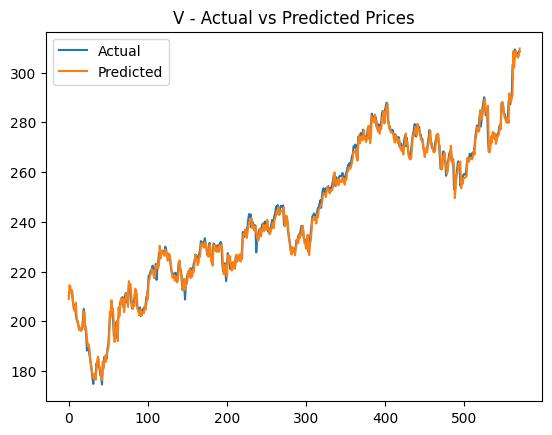

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
Mean Squared Error for VVV: 0.9370393953471793
Root Mean Squared Error (RMSE) for VVV: 0.9680079521094748
R² Score for VVV: 0.8826076607885882


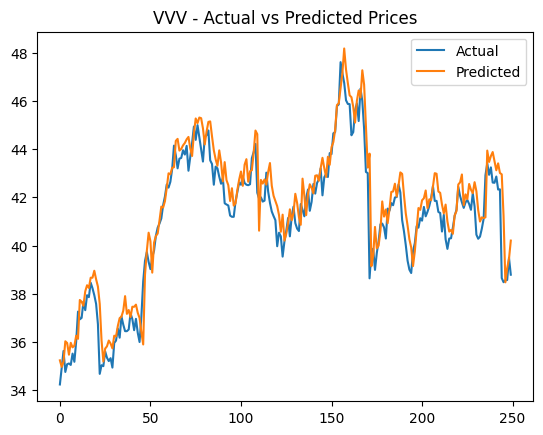

47/47 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for VZ: 4.631975179105887
Root Mean Squared Error (RMSE) for VZ: 2.152202401984044
R² Score for VZ: 0.942889338658149


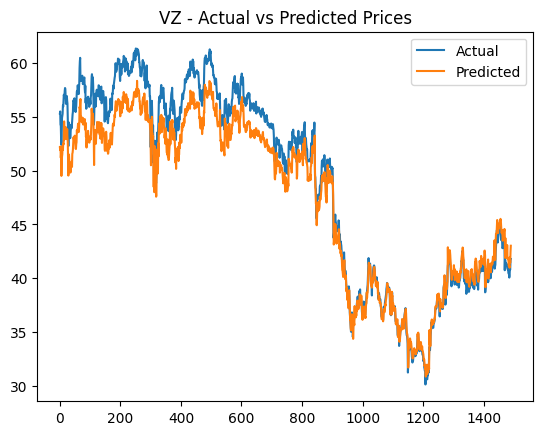

60/60 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for WMT: 0.4173500835198288
Root Mean Squared Error (RMSE) for WMT: 0.6460263798946826
R² Score for WMT: 0.9971412549953755


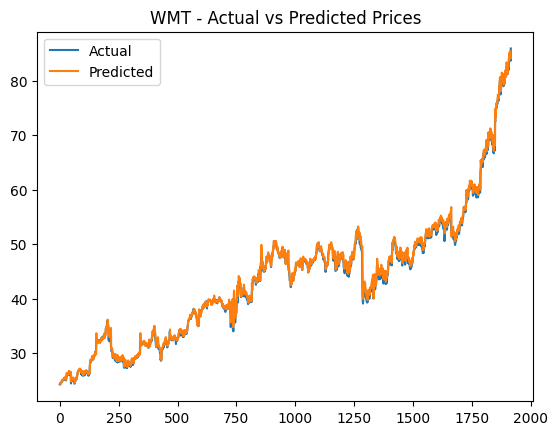

30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for WPC: 0.9107050511900532
Root Mean Squared Error (RMSE) for WPC: 0.9543086771008913
R² Score for WPC: 0.9765563365653988


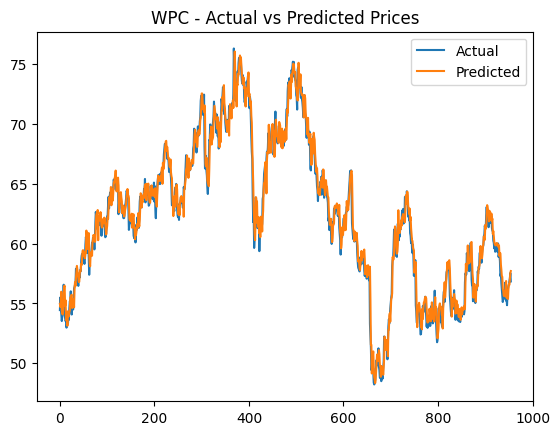

48/48 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for WSM: 7.166415190828883
Root Mean Squared Error (RMSE) for WSM: 2.6770160983507147
R² Score for WSM: 0.9945462546671857


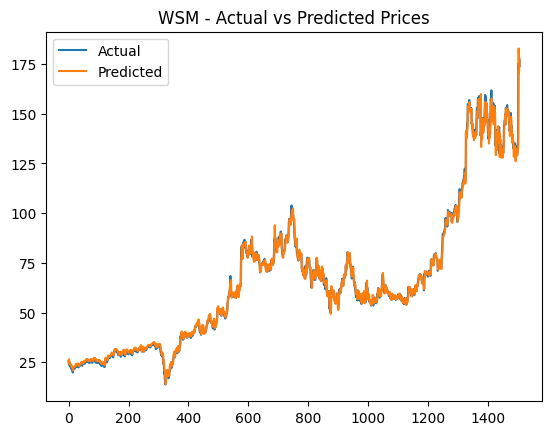

46/46 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for WSO: 43.9619830009179
Root Mean Squared Error (RMSE) for WSO: 6.63038332232141
R² Score for WSO: 0.9961159932314719


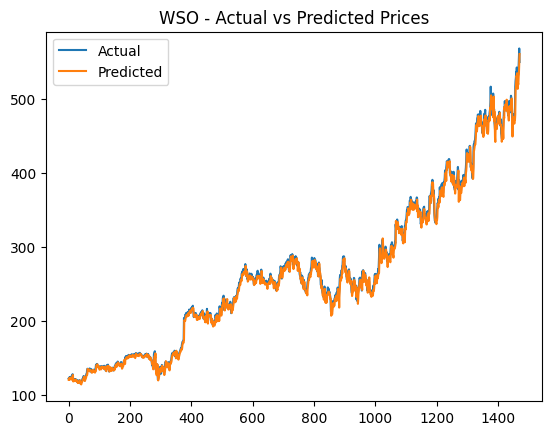

73/73 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for XOM: 18.26051533352988
Root Mean Squared Error (RMSE) for XOM: 4.273232422128462
R² Score for XOM: 0.9590056685129215


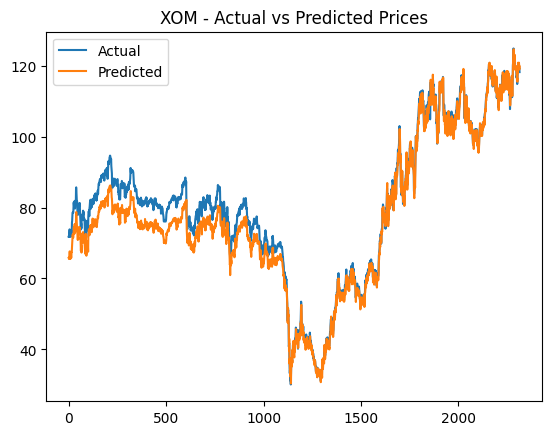

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
Mean Squared Error for XPO: 6.234478875529994
Root Mean Squared Error (RMSE) for XPO: 2.496893845466802
R² Score for XPO: 0.995060049602938


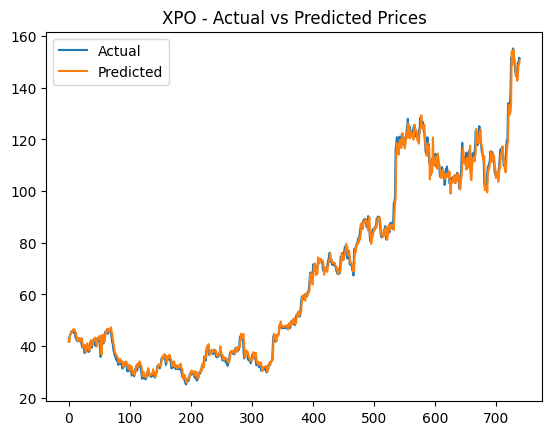

43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for XRAY: 1.3299285938663823
Root Mean Squared Error (RMSE) for XRAY: 1.1532253005663646
R² Score for XRAY: 0.9893575277815037


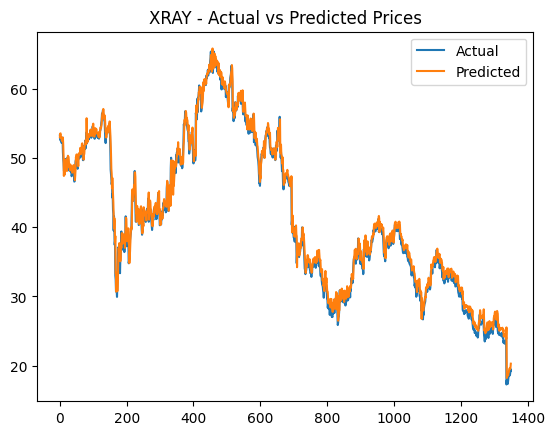

14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
Mean Squared Error for YELP: 1.0155023655772646
Root Mean Squared Error (RMSE) for YELP: 1.0077213729882206
R² Score for YELP: 0.9552505561823831


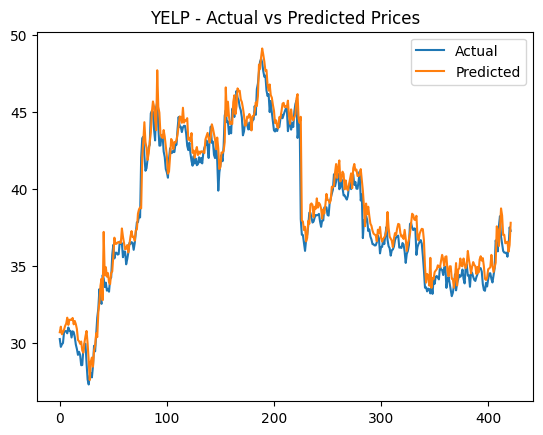

38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for ZBRA: 91.98968633336908
Root Mean Squared Error (RMSE) for ZBRA: 9.591125394518054
R² Score for ZBRA: 0.9922791781686595


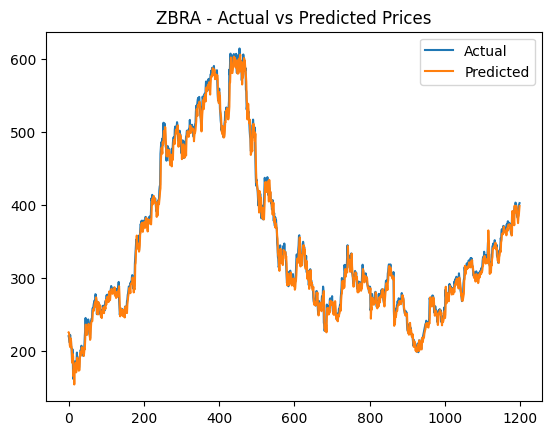

51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Squared Error for ZION: 1.6540308967951896
Root Mean Squared Error (RMSE) for ZION: 1.2860913252157444
R² Score for ZION: 0.9815441181162591


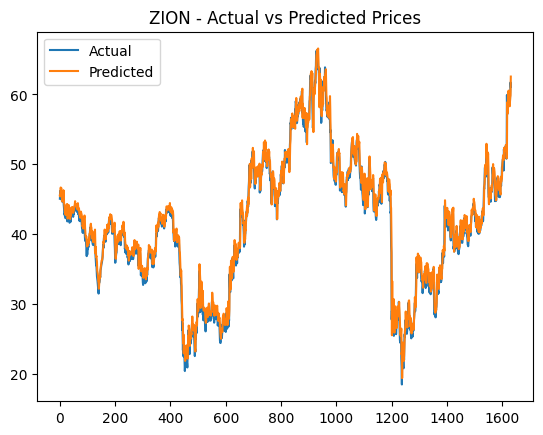

In [13]:
for stock in data['Stock'].unique():
    test_on_stock(best_model, stock, model_type='LSTM')

## Model Comparison

## Conclusion

## References

In [15]:
metrics = pd.DataFrame(columns=[
    'Stock', 'Model', 
    'Train Start', 'Train End', 
    'Test Start', 'Test End', 
    'MSE', 'MAE', 'RMSE', 'R2', 
    'Time to Train', 'Time to Predict',
    'Predictions'
])

def new_metric(stock_symbol, model):
    stock_training_data = training_data[training_data['Stock'] == stock_symbol]
    stock_testing_data = testing_data[testing_data['Stock'] == stock_symbol]

    stock_data = testing_data[testing_data['Stock'] == stock_symbol]
    stock_X = stock_data[['Open', 'Low', 'High']]
    stock_Y = stock_data[['Close']]
    
    # Scale test data
    stock_X_scaled = scaler_X.transform(stock_X)
    stock_Y_scaled = scaler_Y.transform(stock_Y)

    if model == 'LSTM':
        # Reshape stock_X_scaled to 3D array for LSTM (samples, time_steps, features)
        stock_X_scaled_3d = []
        for i in range(len(stock_X_scaled) - sequence_length):
            stock_X_scaled_3d.append(stock_X_scaled[i:i + sequence_length])
        stock_X_scaled_3d = np.array(stock_X_scaled_3d)
        
        # Make predictions using LSTM
        predictions_scaled = best_model.predict(stock_X_scaled_3d)
        
        # Inverse transform predictions and actual values to original scale
        predictions = scaler_Y.inverse_transform(predictions_scaled)
        actual_values = scaler_Y.inverse_transform(stock_Y_scaled[sequence_length:])

    else:
        # Make predictions
        predictions_scaled = linear_regression_model.predict(stock_X_scaled)
        predictions = scaler_Y.inverse_transform(predictions_scaled)
        actual_values = scaler_Y.inverse_transform(stock_Y_scaled)

    mse = mean_squared_error(actual_values, predictions)
    rmse = np.sqrt(mse)  # Root Mean Squared Error
    r2 = r2_score(actual_values, predictions)  # R² score
    
    return {
        'Stock': stock_symbol,
        'Model': model,
        'Train Start': stock_training_data['Date'].iloc[0],
        'Train End': stock_training_data['Date'].iloc[-1],
        'Test Start': stock_testing_data['Date'].iloc[0],
        'Test End': stock_testing_data['Date'].iloc[-1],
        'MSE': mse,
        'MAE': None,
        'RMSE': rmse,
        'R2': r2,
        'Time to Train': None,
        'Time to Predict': None,
        'Predictions': predictions.flatten()
    }

for stock in data['Stock'].unique():
    metrics = metrics._append(new_metric(stock, 'LSTM'), ignore_index=True)
    metrics = metrics._append(new_metric(stock, 'Linear Regression'), ignore_index=True)
metrics

28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
16/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

/var/folders/jp/cgn03_zn1b5860yf7kzd06q00000gn/T/ipykernel_27363/3160539467.py:63: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  metrics = metrics._append(new_metric(stock, 'LSTM'), ignore_index=True)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
61/61 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
36/36 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
73/73 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
73/73 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
10/10 ━━━━━━━━━━━━━━━━━━━━ 

,Stock,Model,Train Start,Train End,Test Start,Test End,MSE,MAE,RMSE,R2,Time to Train,Time to Predict,Predictions
0,005930.KS,LSTM,2000-01-04 00:00:00+09:00,2017-04-05 00:00:00+09:00,2021-02-02 00:00:00+09:00,2024-11-26 00:00:00+09:00,2.219063e+08,None,14896.520523,-2.627532,None,None,"[79465.78, 74369.58, 76550.39, 78273.4, 73614...."
1,005930.KS,Linear Regression,2000-01-04 00:00:00+09:00,2017-04-05 00:00:00+09:00,2021-02-02 00:00:00+09:00,2024-11-26 00:00:00+09:00,1.267876e+05,None,356.072458,0.997984,None,None,"[79062.94778817409, 77975.41494992677, 76575.9..."
2,2222.SR,LSTM,2019-12-11 00:00:00+03:00,2023-05-30 00:00:00+03:00,2024-02-25 00:00:00+03:00,2024-11-26 00:00:00+03:00,7.397469e-01,None,0.860085,-2.012610,None,None,"[30.097006, 29.728153, 29.640947, 29.556236, 2..."
3,2222.SR,Linear Regression,2019-12-11 00:00:00+03:00,2023-05-30 00:00:00+03:00,2024-02-25 00:00:00+03:00,2024-11-26 00:00:00+03:00,2.570351e+00,None,1.603232,-0.743424,None,None,"[29.142474196458156, 29.032255457605125, 28.98..."
4,600519.SS,LSTM,2001-08-27 00:00:00+08:00,2017-10-25 00:00:00+08:00,2021-05-13 00:00:00+08:00,2024-11-26 00:00:00+08:00,1.304807e+03,None,36.122113,0.920567,None,None,"[1587.878, 1562.0215, 1566.0629, 1638.1721, 16..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...
195,YELP,Linear Regression,2012-03-02 00:00:00-05:00,2021-02-01 00:00:00-05:00,2022-12-28 00:00:00-05:00,2024-11-26 00:00:00-05:00,2.593871e+00,None,1.610550,0.907104,None,None,"[24.724756976337975, 25.07750207445283, 25.613..."
196,ZBRA,LSTM,1991-08-15 00:00:00-04:00,2014-11-26 00:00:00-05:00,2019-11-26 00:00:00-05:00,2024-11-26 00:00:00-05:00,9.198969e+01,None,9.591125,0.992279,None,None,"[225.20047, 224.47112, 217.66916, 207.92043, 2..."
197,ZBRA,Linear Regression,1991-08-15 00:00:00-04:00,2014-11-26 00:00:00-05:00,2019-11-26 00:00:00-05:00,2024-11-26 00:00:00-05:00,1.155402e+01,None,3.399120,0.999018,None,None,"[245.87768264157242, 251.67167603983447, 251.0..."
198,ZION,LSTM,1980-03-17 00:00:00-05:00,2011-06-20 00:00:00-04:00,2018-03-09 00:00:00-05:00,2024-11-26 00:00:00-05:00,1.654031e+00,None,1.286091,0.981544,None,None,"[45.520226, 45.388786, 46.338154, 46.667084, 4..."


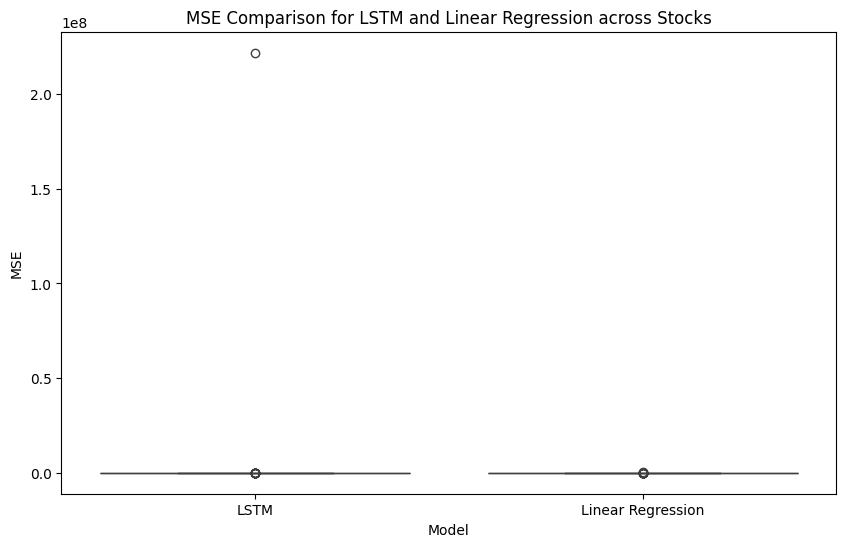

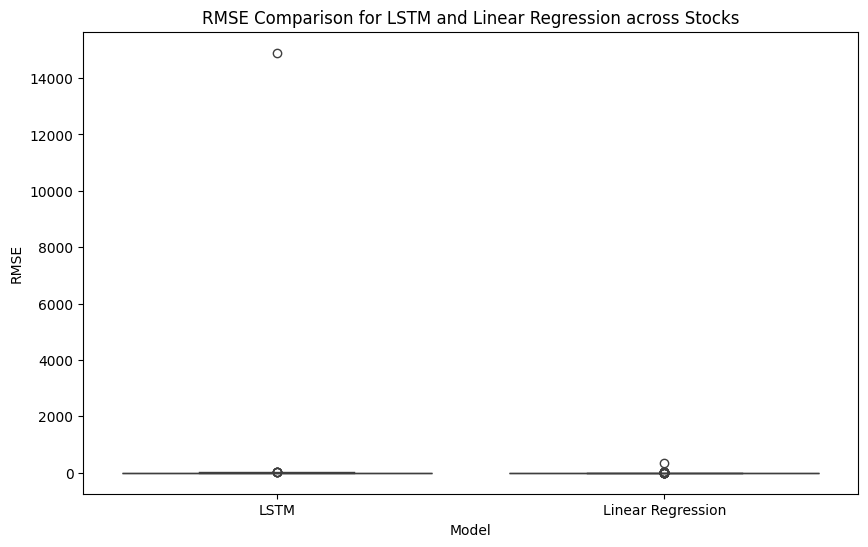

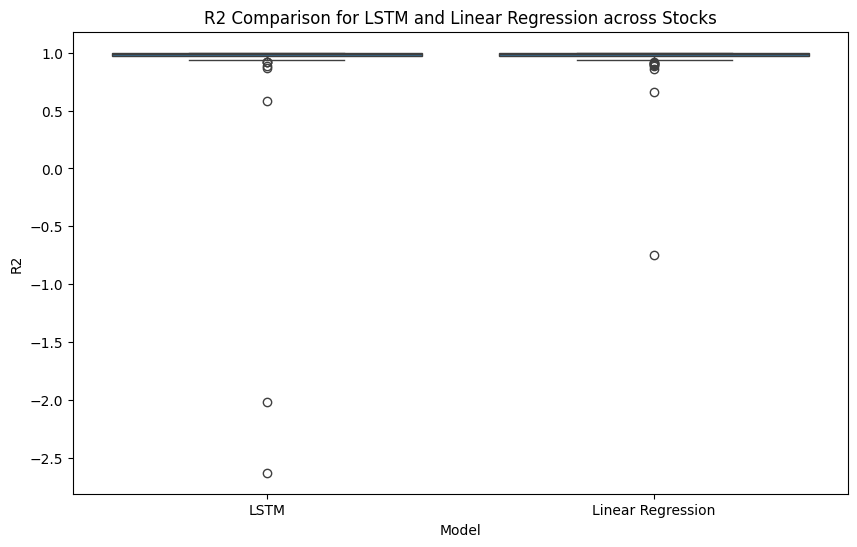

In [17]:
import seaborn as sns

# Compare MSE across models and stocks
plt.figure(figsize=(10, 6))
sns.boxplot(x='Model', y='MSE', data=metrics)
plt.title('MSE Comparison for LSTM and Linear Regression across Stocks')
plt.show()

plt.figure(figsize=(10, 6))
sns.boxplot(x='Model', y='RMSE', data=metrics)
plt.title('RMSE Comparison for LSTM and Linear Regression across Stocks')
plt.show()

plt.figure(figsize=(10, 6))
sns.boxplot(x='Model', y='R2', data=metrics)
plt.title('R2 Comparison for LSTM and Linear Regression across Stocks')
plt.show()

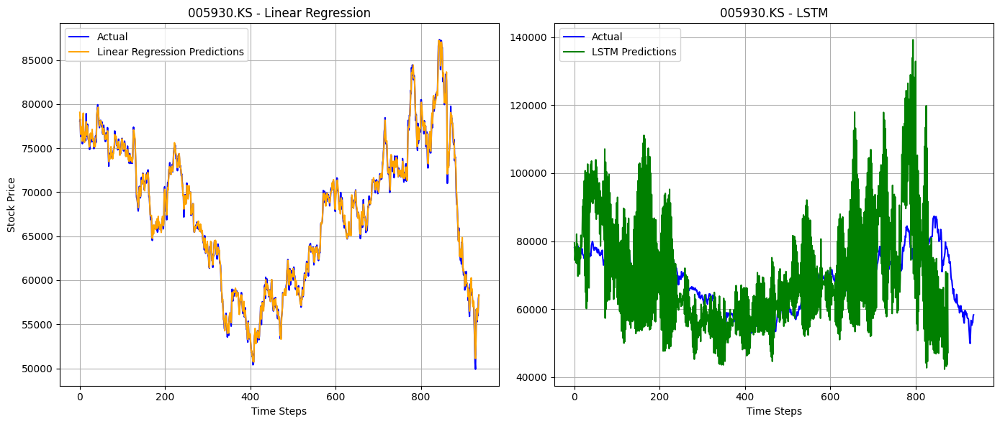

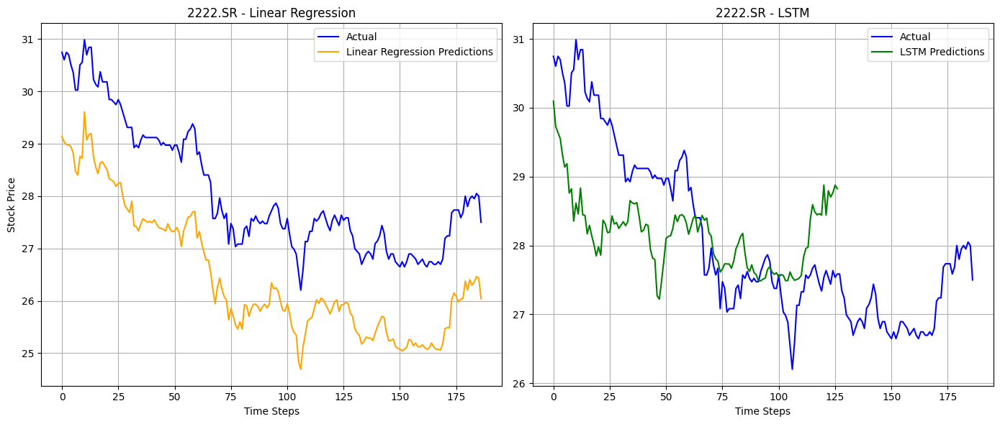

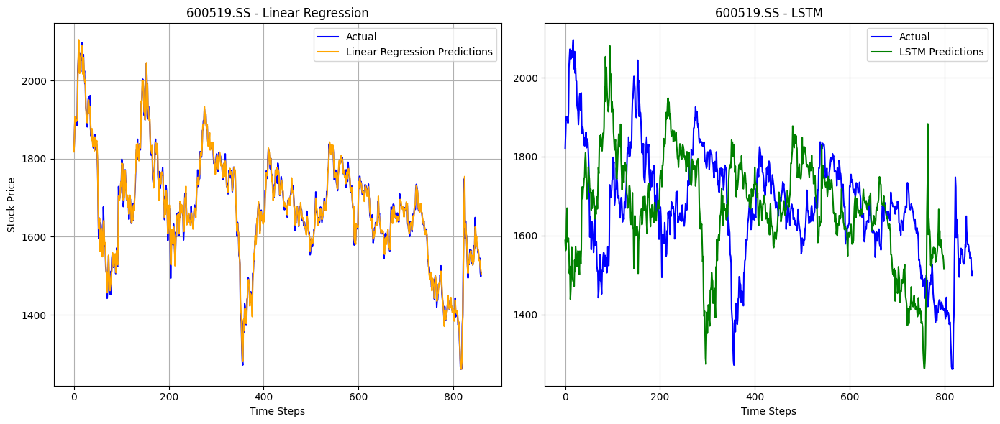

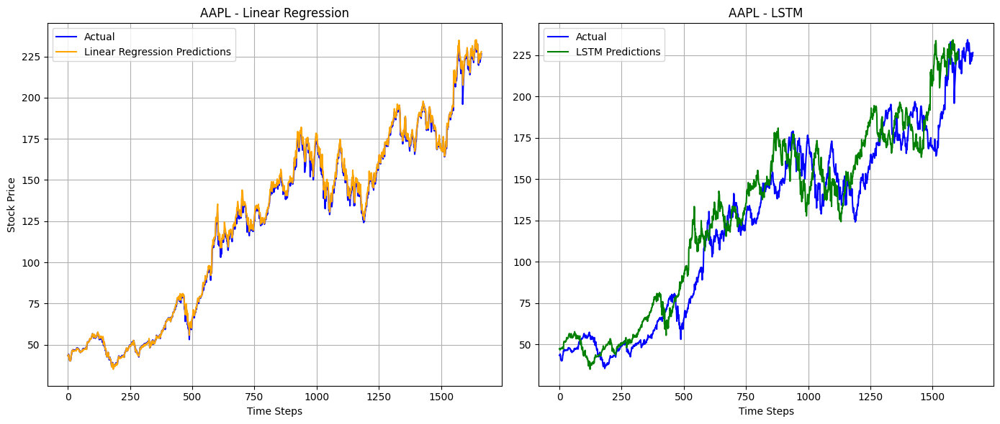

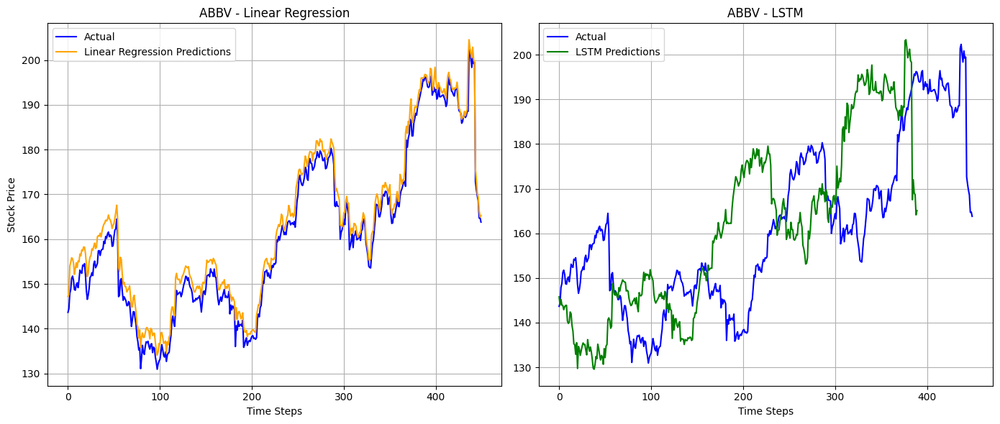

...

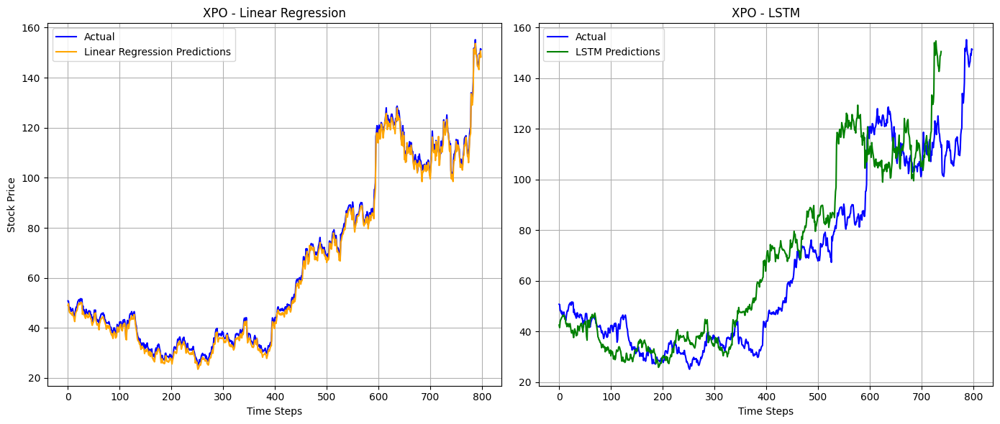

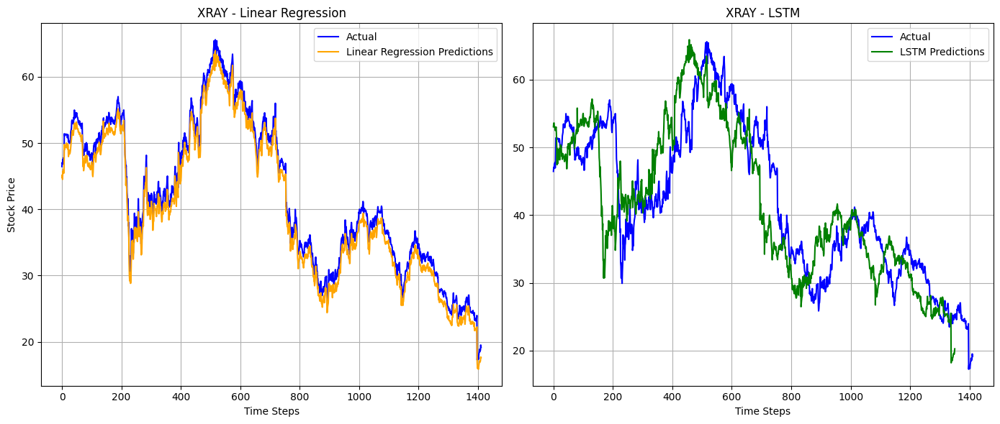

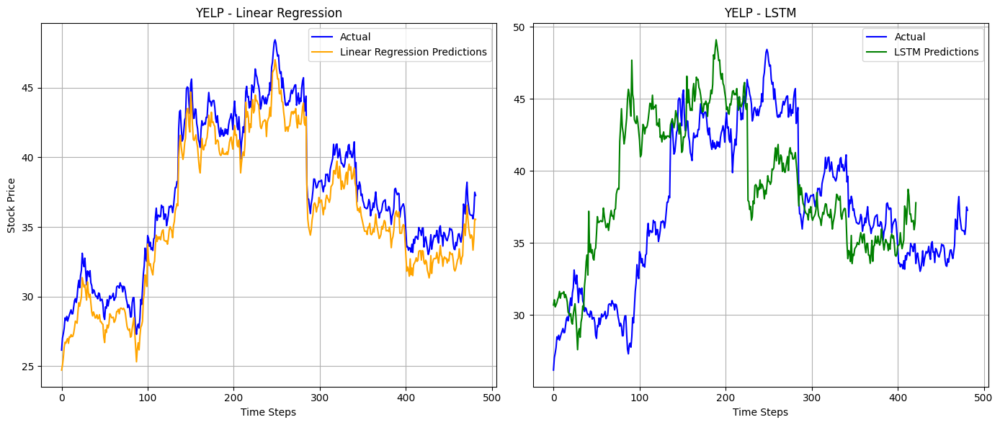

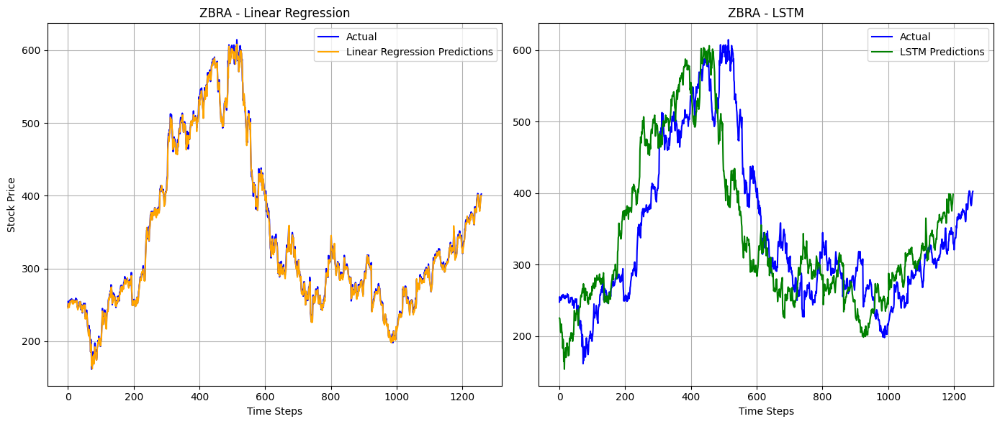

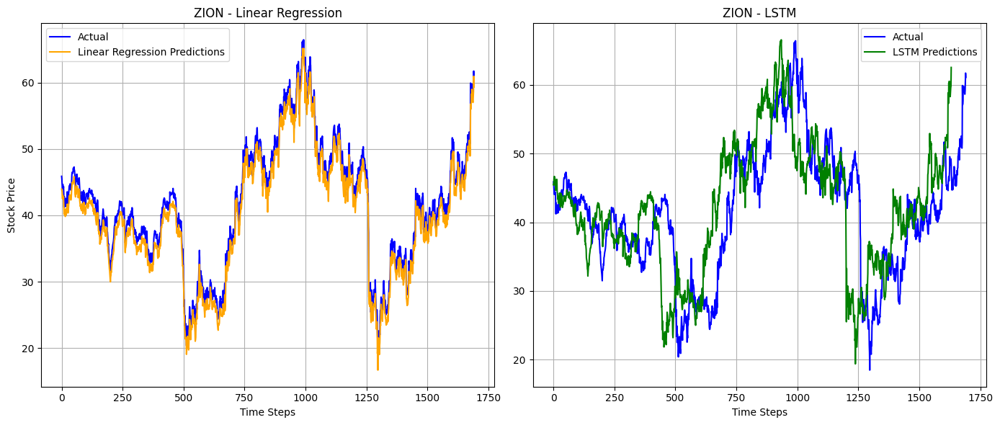

In [18]:
def plot_predictions(stock_symbol):
    # Filter data for the selected stock
    stock_data = testing_data[testing_data['Stock'] == stock_symbol].reset_index(drop=True)
    
    # Extract actual closing prices and flatten them
    stock_Y = stock_data['Close'].values
    
    # Get predictions for Linear Regression and LSTM models
    lr = metrics[(metrics['Stock'] == stock_symbol) & (metrics['Model'] == 'Linear Regression')]
    lstm = metrics[(metrics['Stock'] == stock_symbol) & (metrics['Model'] == 'LSTM')]
    
    lr_predictions = lr['Predictions'].values[0]
    lstm_predictions = lstm['Predictions'].values[0]

    # Create side-by-side subplots
    fig, axes = plt.subplots(1, 2, figsize=(14, 6))

    # Plot for Linear Regression
    axes[0].plot(stock_Y, label='Actual', color='blue')
    axes[0].plot(lr_predictions, label='Linear Regression Predictions', color='orange')
    axes[0].set_title(f'{stock_symbol} - Linear Regression')
    axes[0].set_xlabel('Time Steps')
    axes[0].set_ylabel('Stock Price')
    axes[0].legend()
    axes[0].grid(True)

    # Plot for LSTM
    axes[1].plot(stock_Y, label='Actual', color='blue')
    axes[1].plot(lstm_predictions, label='LSTM Predictions', color='green')
    axes[1].set_title(f'{stock_symbol} - LSTM')
    axes[1].set_xlabel('Time Steps')
    axes[1].legend()
    axes[1].grid(True)

    # Adjust layout
    plt.tight_layout()
    plt.show()

for stock_symbol in data['Stock'].unique():
    plot_predictions(stock_symbol)
